In [24]:
## import pickle
import numpy as np
import matplotlib.pyplot as plt
from data.visualise import grid_psfs, show_psf_axial
from tifffile import imread
import pandas as pd
import seaborn as sns

def load_pickle_file(dpath):
    with open(dpath, 'rb') as f:
        return pickle.load(f)

# # MQ_data     
# stacks = '/home/miguel/Projects/uni/data/smlm_3d/20230601_MQ_celltype/beads_box15/combined/stacks.ome.tif'
# locs = '/home/miguel/Projects/uni/data/smlm_3d/20230601_MQ_celltype/beads_box15/combined/locs.hdf'
# exclude_idx = [5, 7, 11, 14, 22, 24, 26, 27, 28, 31, 32, 35, 37, 38, 40, 45, 50, 51, 54, 68, 69, 71, 72, 82, 87, 89, 91, 98, 102, 108, 109, 112, 113, 115, 116, 121, 122, 123, 127, 129, 131, 132, 133, 138, 141, 144, 150, 151, 154, 161, 167, 169, 170, 172, 178, 179, 181, 182, 184, 185, 186, 187, 190, 200, 201, 205, 206, 210, 214, 219, 221, 224, 226, 230, 233, 234, 235, 236, 237, 243]
# Z_STEP = 20

# FD-deeploc data
stacks = './stacks.ome.tif'
locs = './locs.hdf'
Z_STEP = 10
Z_RANGE = 1000

DEBUG = False

all_psfs = imread(stacks)
all_locs = pd.read_hdf(locs, key='locs')

all_psfs = all_psfs[:, :, :, :, np.newaxis]

print(all_psfs.shape, all_psfs.dtype)

# # for i, psf in enumerate(psfs.sum(axis=-1)):
# #     plt.title(str(i))
# #     show_psf_axial(psf)


# # exclude_idx = [0, 5, 7, 12, 22, 26, 32, 35, 38, 40, 45, 50, 51, 54, 68, 69, 71, 72, 82, 87, 89, 91, 98, 102, 108, 109, 112, 113, 115, 116, 121, 122, 123, 124, 127, 129, 131, 132, 133, 138, 141, 144, 150, 151, 154, 161, 167, 169, 170, 172, 178, 179, 181, 182, 184, 185, 186, 187, 190, 200, 201, 205, 206, 210, 214, 219, 221, 224, 226, 230, 233, 234, 235, 236, 237, 243]

# # print('Excluded PSFs \n\n\n\n\n')
# # for i in exclude_idx:
# #     show_psf_axial(psfs[i].mean(axis=-1), str(i))
# #     plt.plot(psfs[i].max(axis=(1,2)))
# #     plt.show()
# # print('End of excluded PSFs \n\n\n\n\n')

# # print(psfs.shape[0])
# # for i in range(psfs.shape[0]):
# #     if i in exclude_idx:
# #         continue
# #     plt.title(str(i))
# #     show_psf_axial(psfs[i].mean(axis=-1))
# #     plt.plot(psfs[i].max(axis=(1,2,3)), label='max')
# #     plt.legend()
# #     plt.title(str(i))
# #     plt.show()

# idx = [i for i in range(psfs.shape[0]) if i not in exclude_idx]
# psfs = psfs[idx]
# locs = locs.iloc[idx]
all_locs['idx'] = np.arange(all_locs.shape[0])


(6259, 201, 15, 15, 1) uint16


In [25]:
xlim = ((810, 810+250))
ylim = ((790, 790+250))

xlim = all_locs['x'].min(), all_locs['x'].max()
ylim = all_locs['y'].min(), all_locs['y'].max()


idx = (xlim[0] < all_locs['x']) & (all_locs['x'] < xlim[1]) & (ylim[0] < all_locs['y']) & (all_locs['y'] < ylim[1])
locs = all_locs[idx]
psfs = all_psfs[locs['idx']]

print(psfs.shape)

ys = []
for i in range(psfs.shape[0]):
    y = np.arange(psfs.shape[1]) * Z_STEP
    y = y - 1000
    ys.append(y)
ys = np.stack(ys)

(6255, 201, 15, 15, 1)


In [26]:
print(psfs.shape, psfs.min(), psfs.max())
print(ys.shape)
print(locs.shape)

(6255, 201, 15, 15, 1) 123 18440
(6255, 201)
(6255, 14)


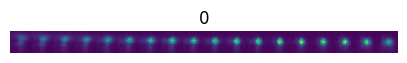

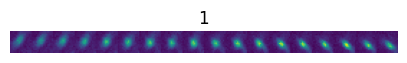

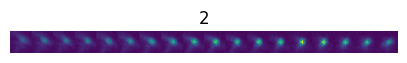

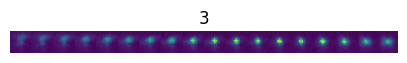

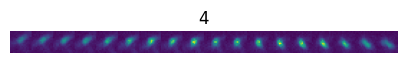

...

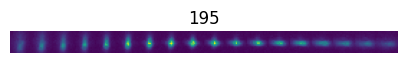

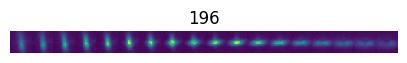

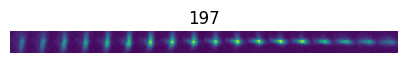

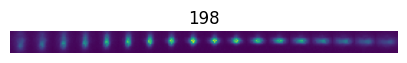

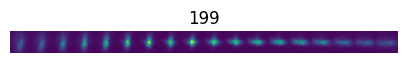

In [27]:
from data.visualise import show_psf_axial
plt.rcParams['figure.figsize'] = [5, 3]
for i, psf in enumerate(psfs[0:200]):
    show_psf_axial(psf.mean(axis=-1), str(i))


  0%|▏                                                                                                       | 8/6255 [00:00<01:22, 75.33it/s]

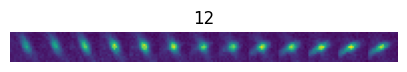

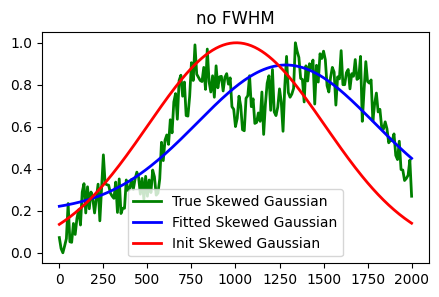

  0%|▍                                                                                                      | 28/6255 [00:00<01:34, 65.59it/s]

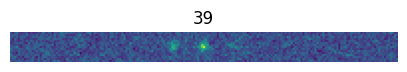

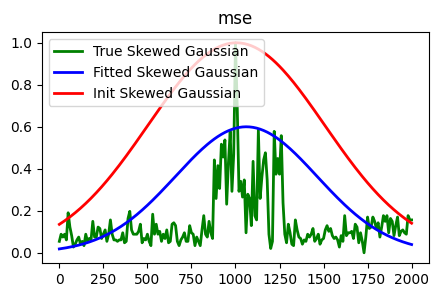

  1%|▋                                                                                                      | 40/6255 [00:00<01:53, 54.99it/s]

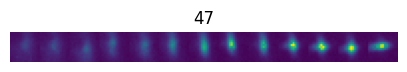

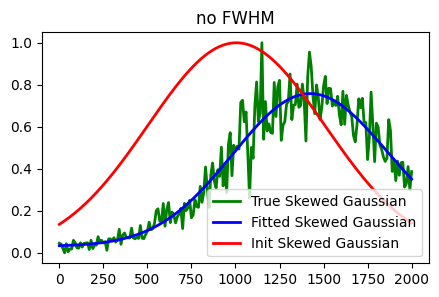

  1%|▉                                                                                                      | 59/6255 [00:01<01:45, 58.45it/s]

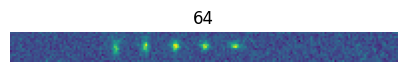

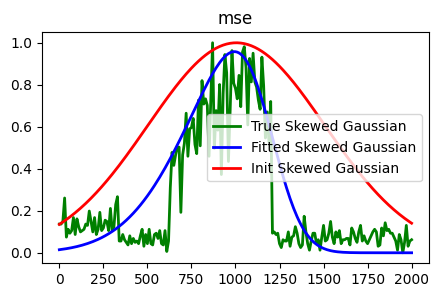

  1%|█▎                                                                                                     | 80/6255 [00:01<01:37, 63.05it/s]

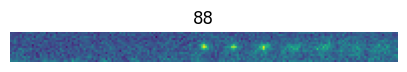

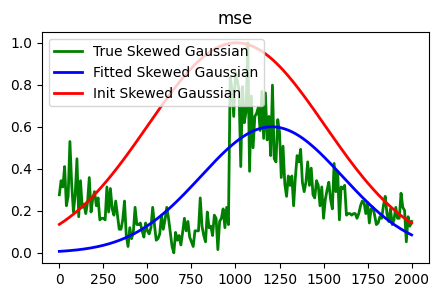

  1%|█▍                                                                                                     | 89/6255 [00:01<01:57, 52.36it/s]

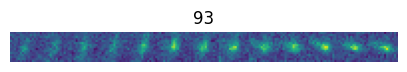

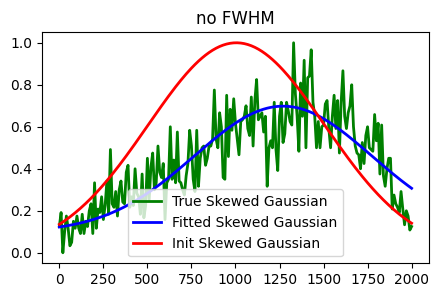

  2%|█▌                                                                                                     | 96/6255 [00:01<02:19, 44.00it/s]

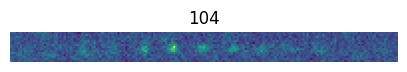

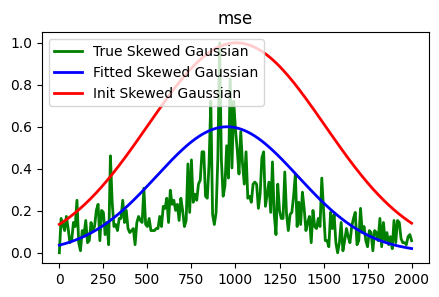

  2%|█▋                                                                                                    | 105/6255 [00:02<02:33, 40.08it/s]

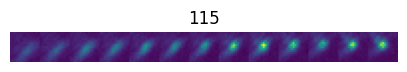

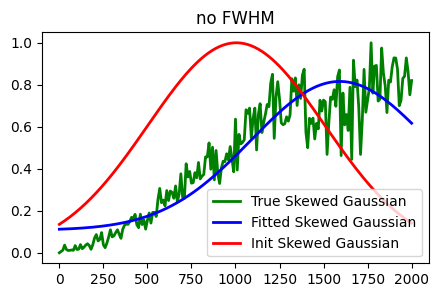

  2%|█▉                                                                                                    | 116/6255 [00:02<02:34, 39.73it/s]

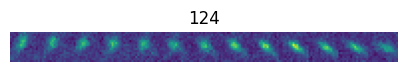

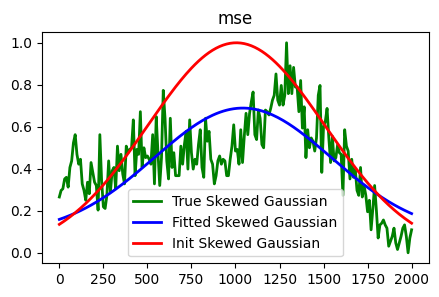

  2%|██▍                                                                                                   | 148/6255 [00:02<01:41, 60.43it/s]

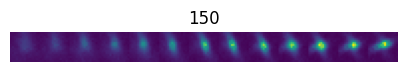

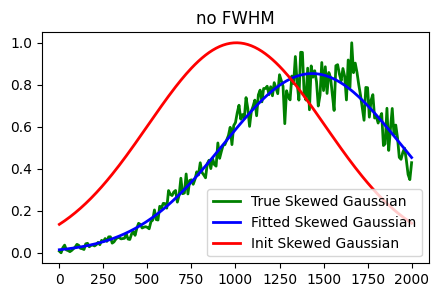

  3%|███▍                                                                                                  | 208/6255 [00:03<01:02, 95.99it/s]

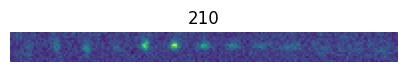

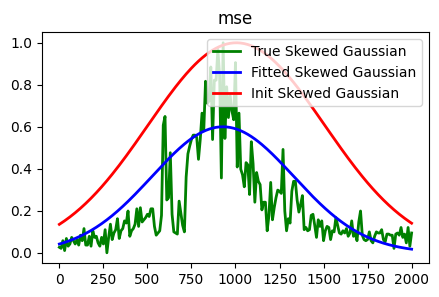

  4%|███▉                                                                                                  | 243/6255 [00:04<01:08, 88.08it/s]

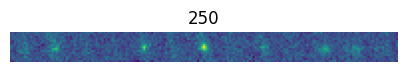

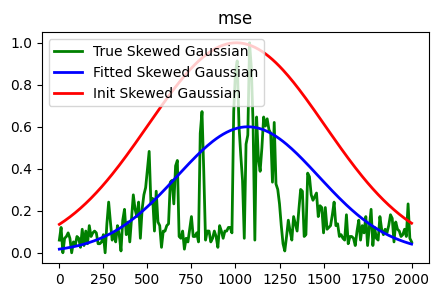

  4%|████▌                                                                                                 | 276/6255 [00:04<01:14, 79.93it/s]

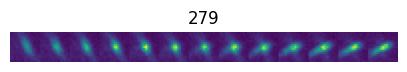

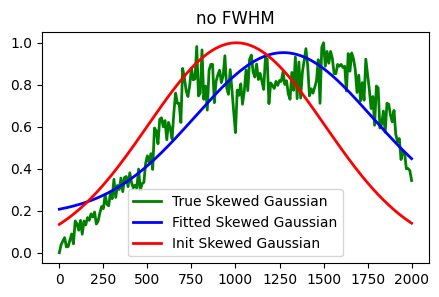

  5%|█████▏                                                                                                | 320/6255 [00:05<01:10, 84.78it/s]

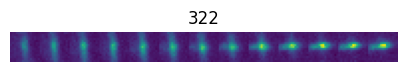

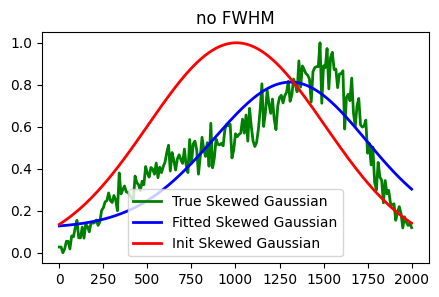

  6%|██████                                                                                                | 369/6255 [00:05<01:02, 94.03it/s]

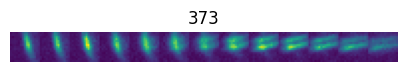

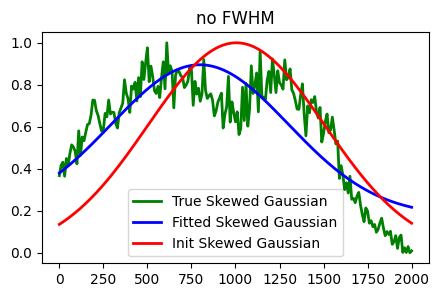

  6%|██████▍                                                                                               | 391/6255 [00:06<01:18, 74.88it/s]

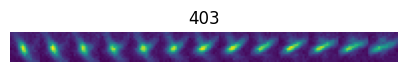

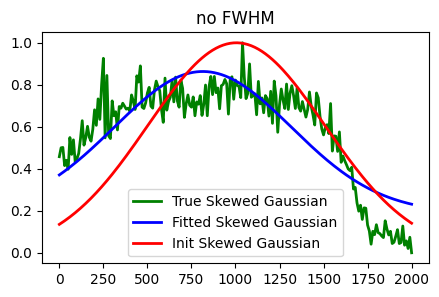

  7%|██████▊                                                                                               | 415/6255 [00:06<01:24, 68.73it/s]

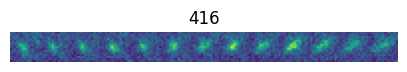

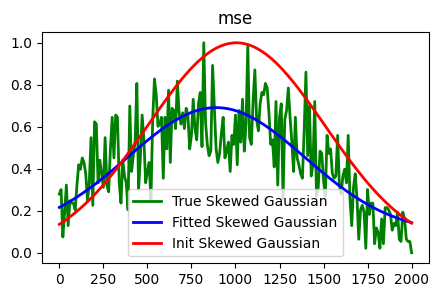

  7%|██████▉                                                                                               | 424/6255 [00:06<01:55, 50.29it/s]

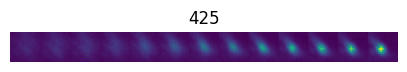

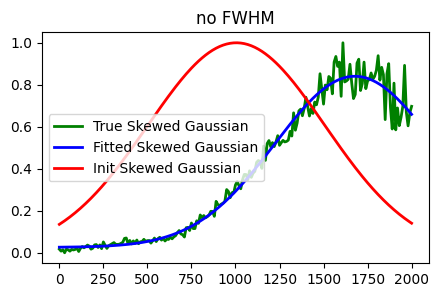

  7%|███████▏                                                                                              | 444/6255 [00:07<01:42, 56.96it/s]

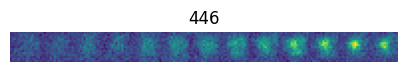

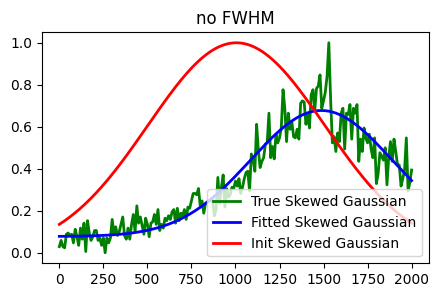

  7%|███████▎                                                                                              | 452/6255 [00:07<02:00, 48.33it/s]

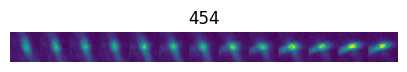

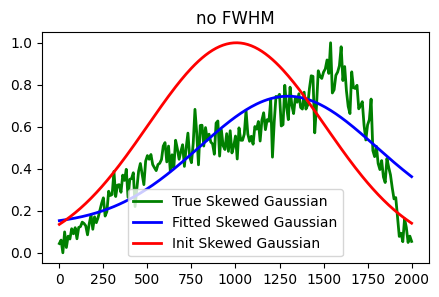

  8%|████████▎                                                                                             | 509/6255 [00:08<01:03, 90.27it/s]

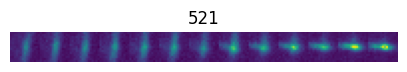

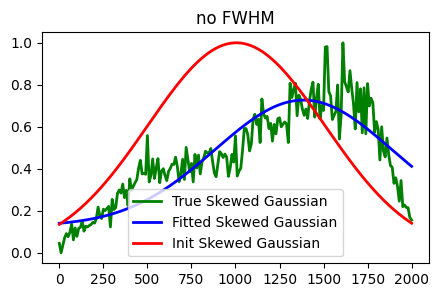

  9%|█████████                                                                                             | 554/6255 [00:08<01:05, 86.43it/s]

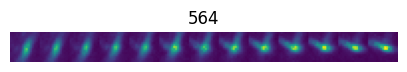

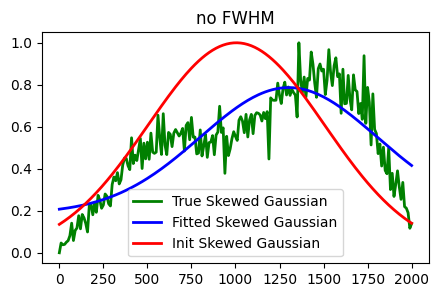

  9%|█████████▏                                                                                            | 565/6255 [00:08<01:25, 66.28it/s]

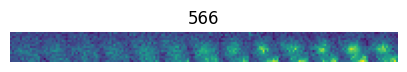

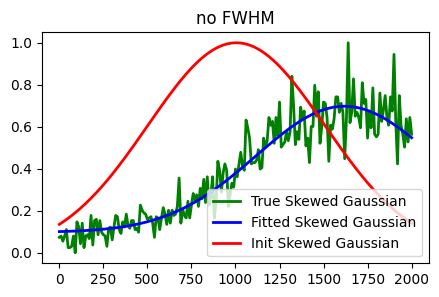

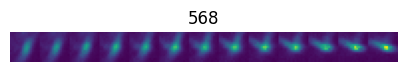

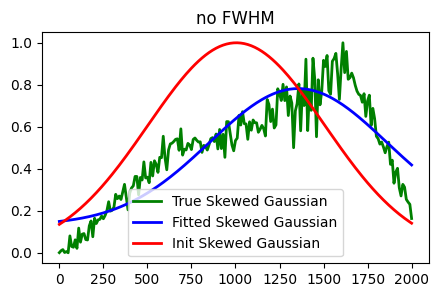

 10%|█████████▊                                                                                            | 604/6255 [00:09<01:25, 65.80it/s]

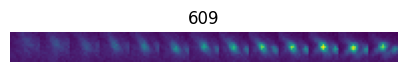

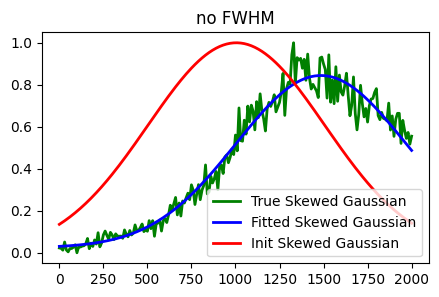

 10%|██████████▍                                                                                           | 640/6255 [00:10<01:07, 83.22it/s]

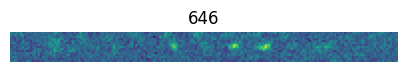

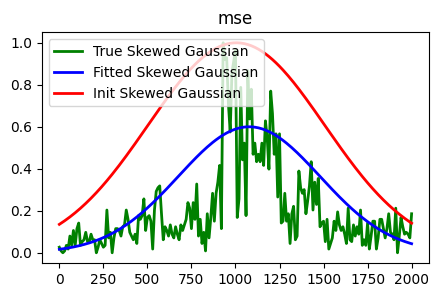

 11%|██████████▊                                                                                           | 664/6255 [00:10<01:13, 75.97it/s]

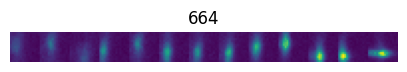

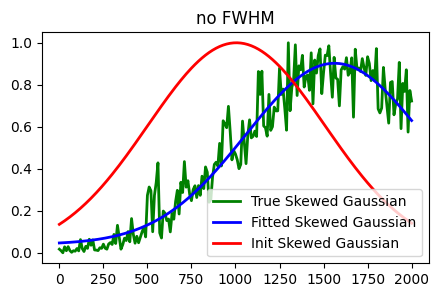

 11%|███████████▍                                                                                          | 703/6255 [00:11<01:02, 89.34it/s]

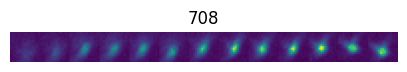

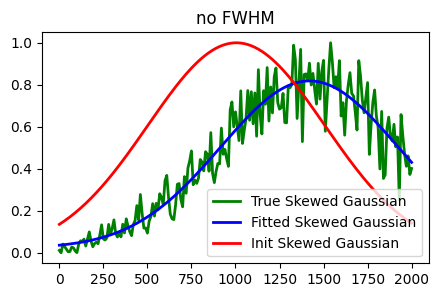

 11%|███████████▋                                                                                          | 714/6255 [00:11<01:24, 65.55it/s]

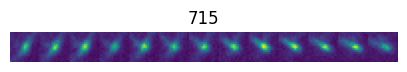

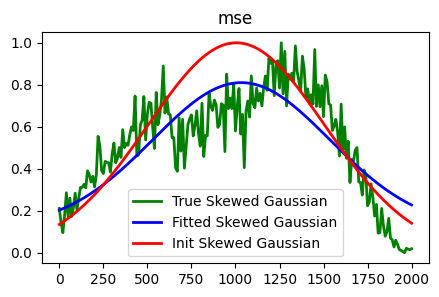

 12%|███████████▊                                                                                          | 723/6255 [00:11<01:49, 50.73it/s]

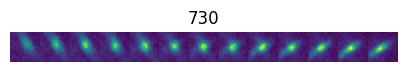

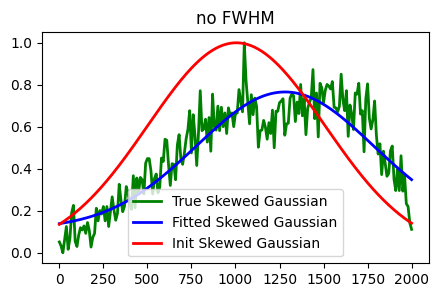

 12%|████████████▋                                                                                         | 778/6255 [00:12<01:05, 84.02it/s]

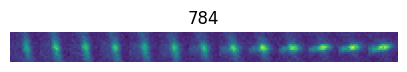

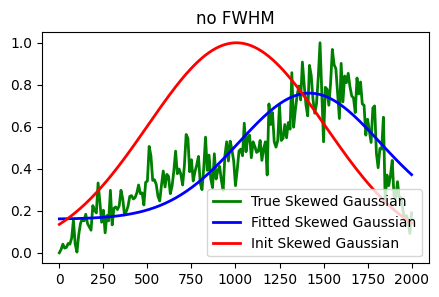

 13%|████████████▊                                                                                         | 788/6255 [00:12<01:38, 55.45it/s]

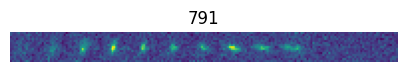

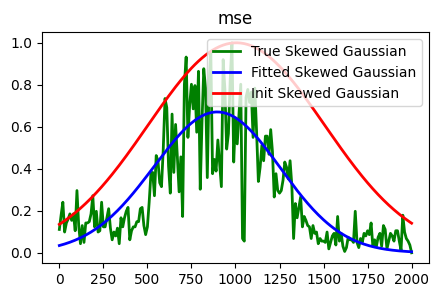

 13%|████████████▉                                                                                         | 796/6255 [00:12<01:51, 48.85it/s]

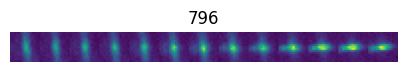

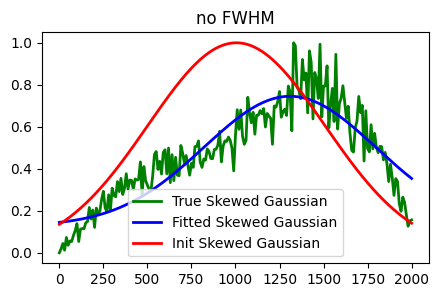

 13%|█████████████▎                                                                                        | 815/6255 [00:13<01:38, 55.30it/s]

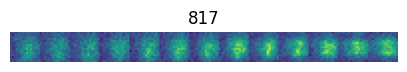

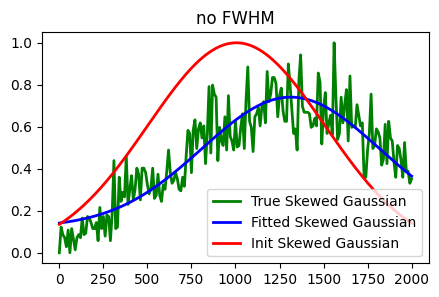

 13%|█████████████▍                                                                                        | 823/6255 [00:13<01:57, 46.27it/s]

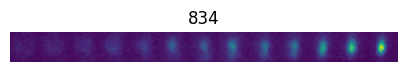

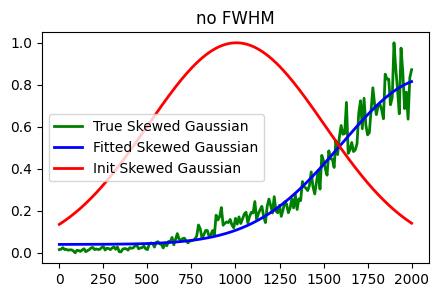

 15%|██████████████▊                                                                                      | 919/6255 [00:14<00:53, 100.17it/s]

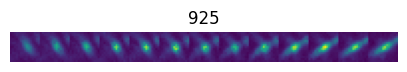

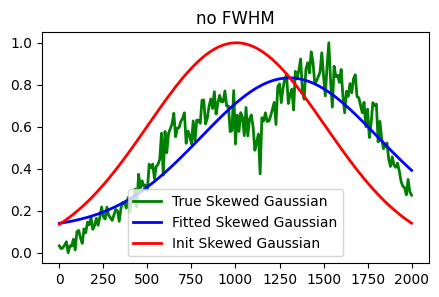

 15%|███████████████▏                                                                                      | 930/6255 [00:14<01:20, 66.24it/s]

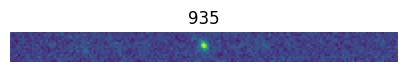

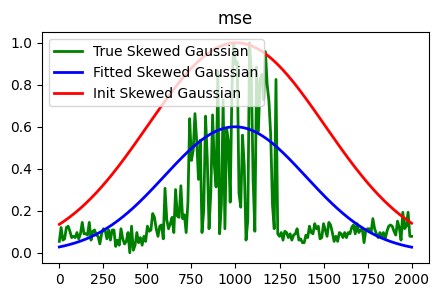

 15%|███████████████▎                                                                                      | 939/6255 [00:15<01:37, 54.55it/s]

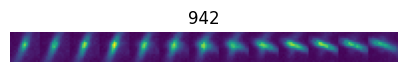

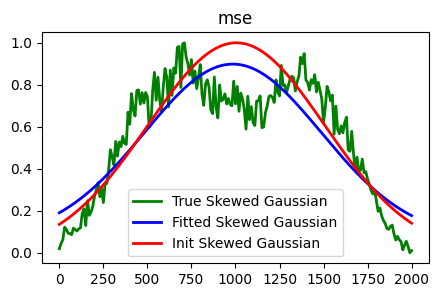

 15%|███████████████▍                                                                                      | 947/6255 [00:15<01:52, 46.99it/s]

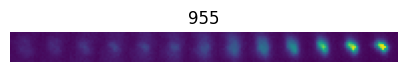

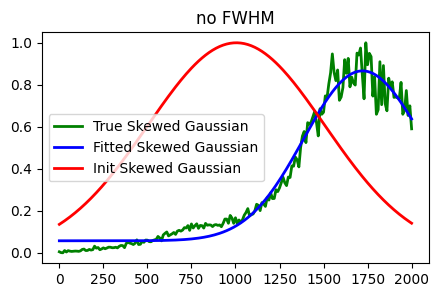

 16%|████████████████▏                                                                                     | 995/6255 [00:15<01:04, 81.45it/s]

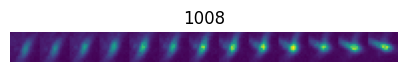

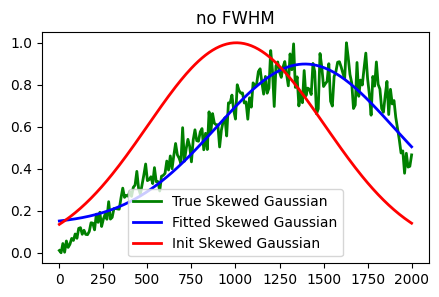

 16%|████████████████▎                                                                                    | 1009/6255 [00:16<01:19, 66.09it/s]

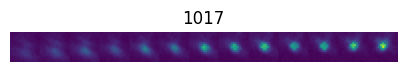

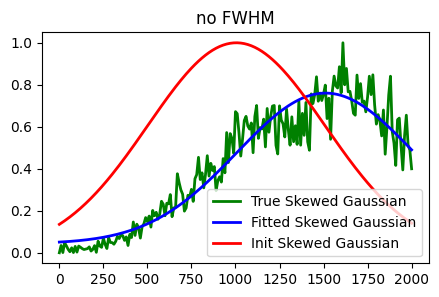

 17%|█████████████████                                                                                    | 1055/6255 [00:16<01:01, 85.00it/s]

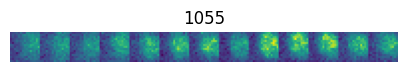

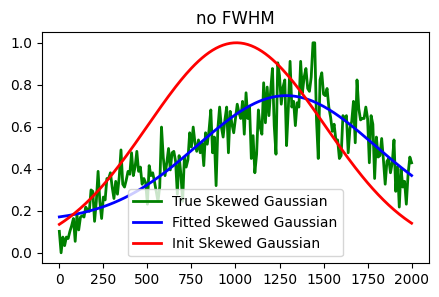

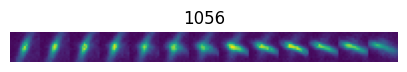

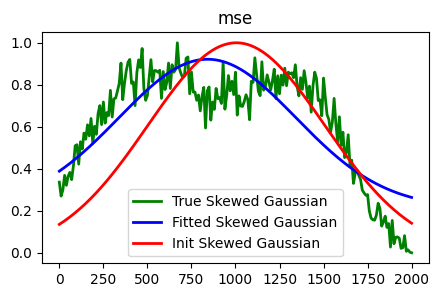

 17%|█████████████████▏                                                                                   | 1066/6255 [00:17<01:43, 49.96it/s]

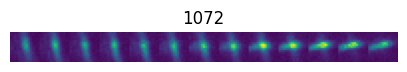

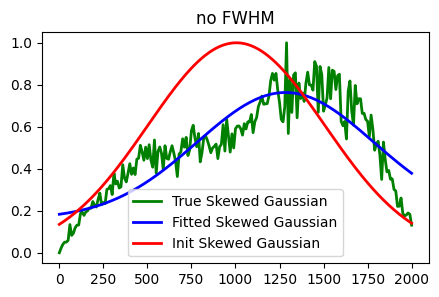

 17%|█████████████████▎                                                                                   | 1074/6255 [00:17<01:55, 44.73it/s]

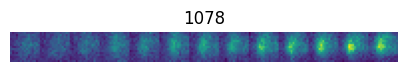

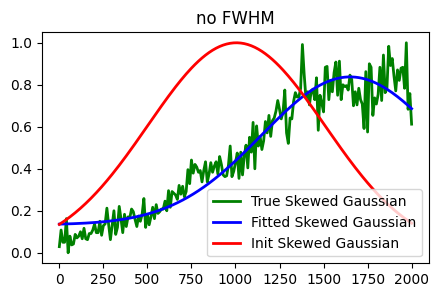

 19%|██████████████████▌                                                                                 | 1162/6255 [00:18<00:48, 105.20it/s]

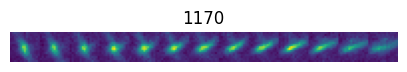

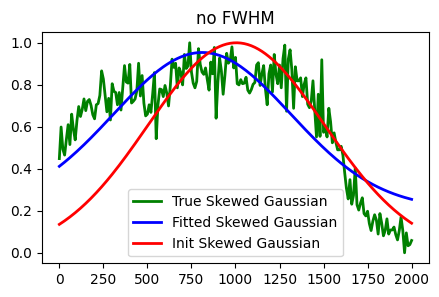

 19%|███████████████████▏                                                                                 | 1186/6255 [00:18<01:00, 84.10it/s]

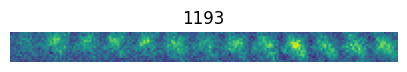

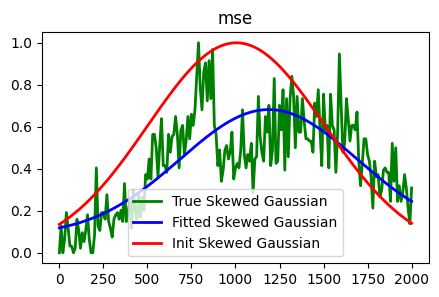

 19%|███████████████████▎                                                                                 | 1197/6255 [00:18<01:22, 61.37it/s]

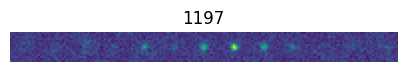

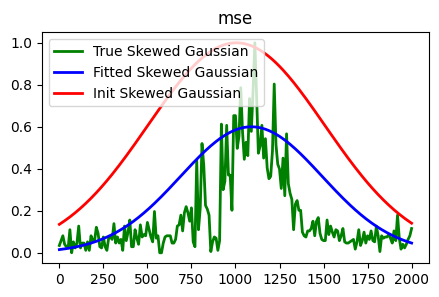

 19%|███████████████████▍                                                                                 | 1206/6255 [00:19<01:36, 52.28it/s]

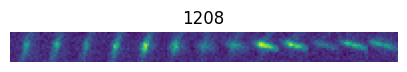

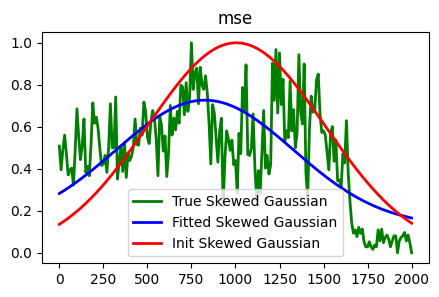

 19%|███████████████████▌                                                                                 | 1213/6255 [00:19<01:51, 45.40it/s]

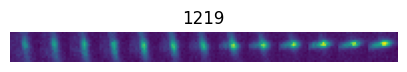

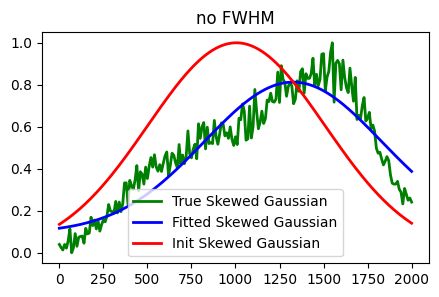

 20%|███████████████████▋                                                                                 | 1220/6255 [00:19<02:03, 40.87it/s]

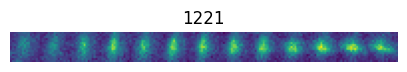

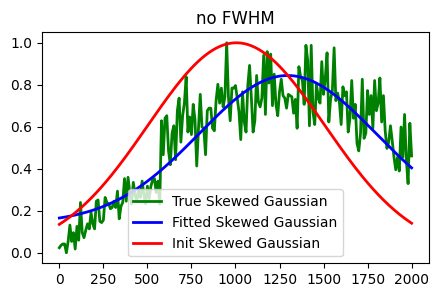

 20%|███████████████████▉                                                                                 | 1238/6255 [00:20<01:41, 49.22it/s]

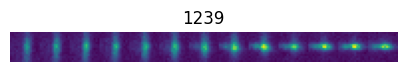

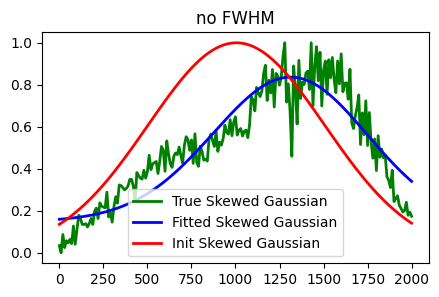

 20%|████████████████████                                                                                 | 1245/6255 [00:20<01:56, 43.05it/s]

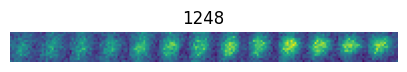

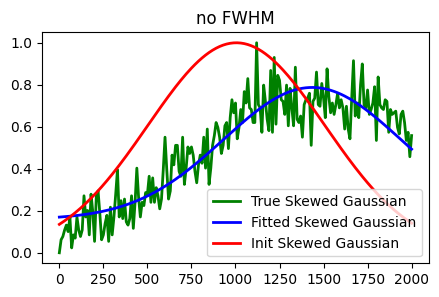

 21%|████████████████████▉                                                                                | 1297/6255 [00:20<00:59, 83.79it/s]

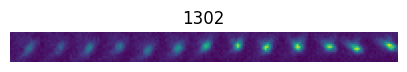

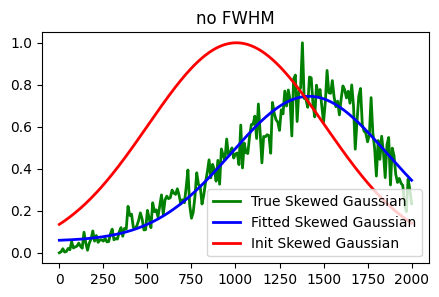

 21%|█████████████████████▎                                                                               | 1318/6255 [00:21<01:10, 70.16it/s]

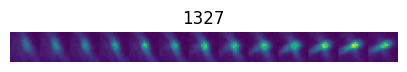

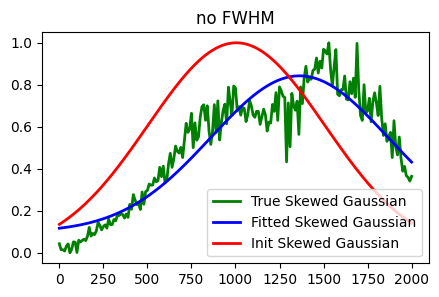

 21%|█████████████████████▍                                                                               | 1328/6255 [00:21<01:27, 56.59it/s]

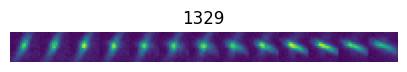

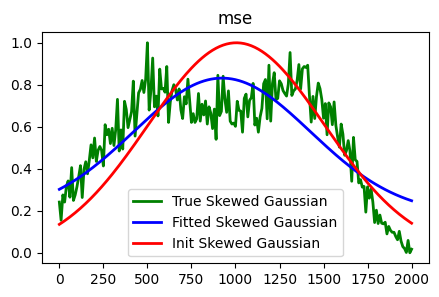

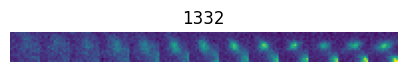

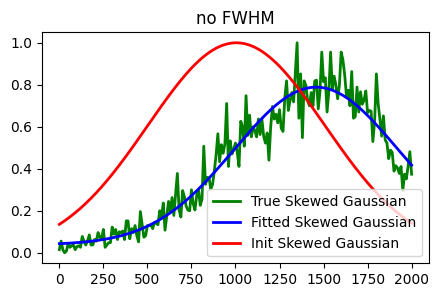

 22%|██████████████████████▏                                                                              | 1373/6255 [00:22<01:06, 72.87it/s]

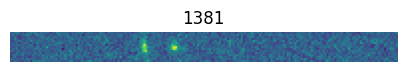

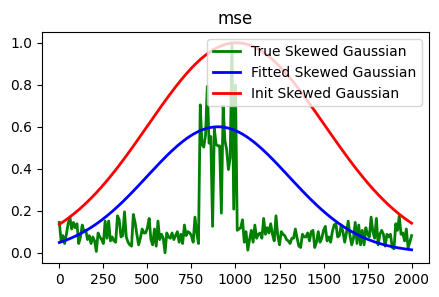

 24%|███████████████████████▌                                                                            | 1473/6255 [00:23<00:41, 115.26it/s]

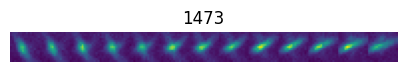

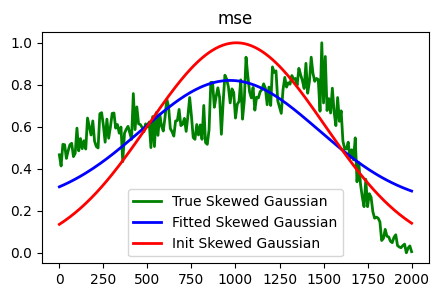

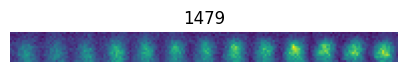

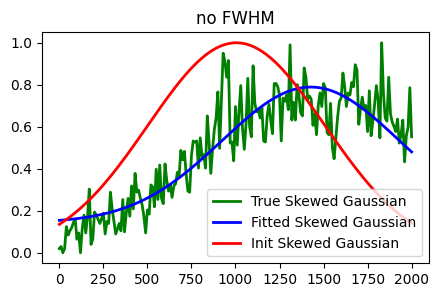

 24%|████████████████████████▏                                                                            | 1496/6255 [00:23<01:15, 63.03it/s]

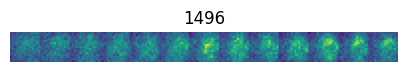

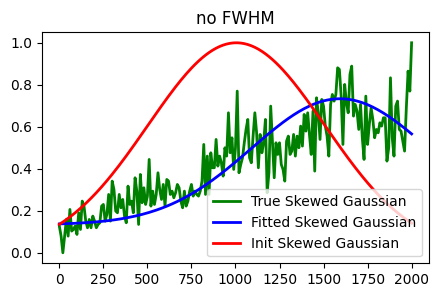

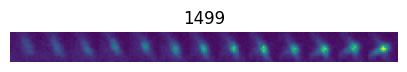

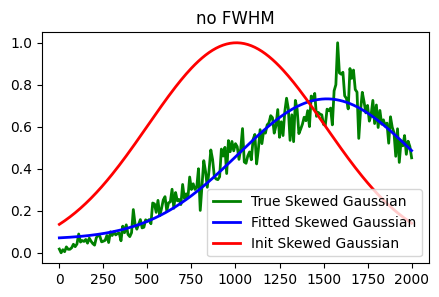

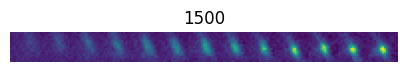

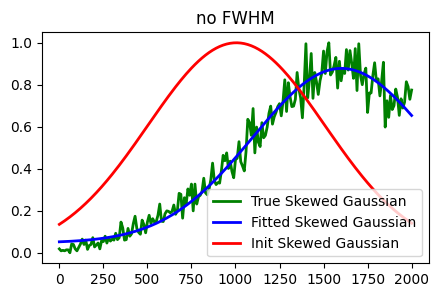

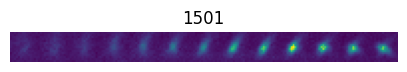

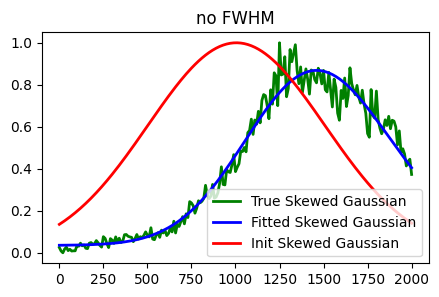

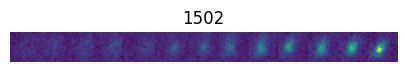

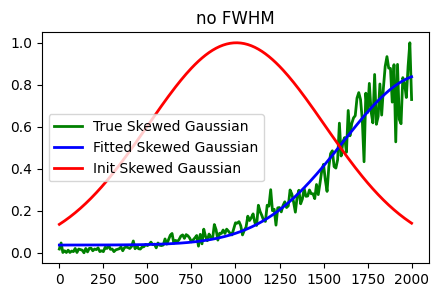

 24%|████████████████████████▎                                                                            | 1506/6255 [00:24<02:58, 26.60it/s]

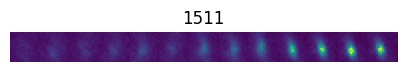

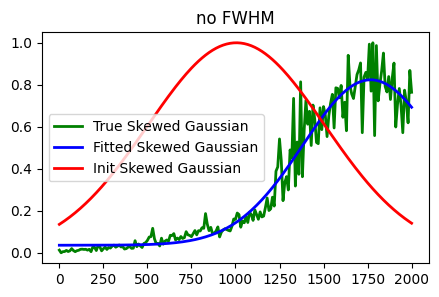

 24%|████████████████████████▍                                                                            | 1513/6255 [00:25<02:53, 27.35it/s]

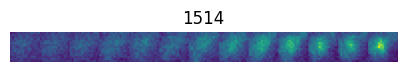

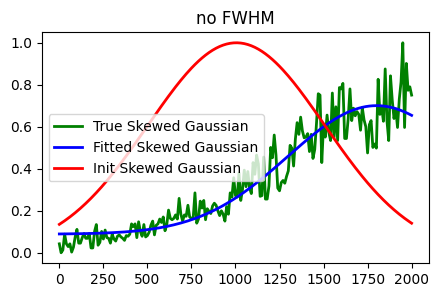

 24%|████████████████████████▌                                                                            | 1519/6255 [00:25<02:52, 27.38it/s]

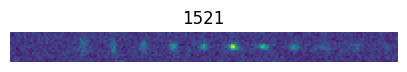

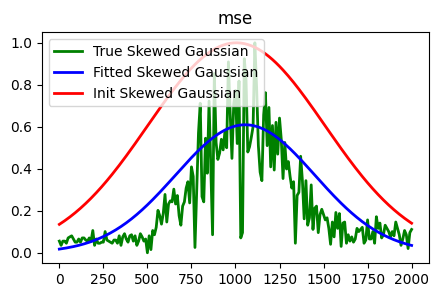

 24%|████████████████████████▌                                                                            | 1524/6255 [00:25<04:33, 17.30it/s]

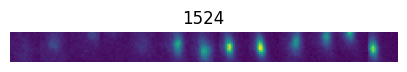

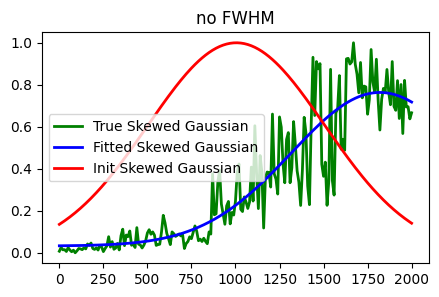

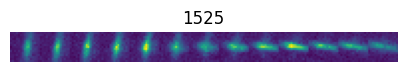

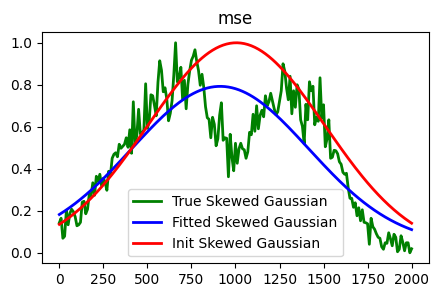

 24%|████████████████████████▋                                                                            | 1528/6255 [00:26<05:05, 15.47it/s]

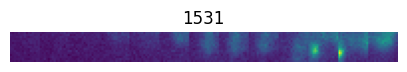

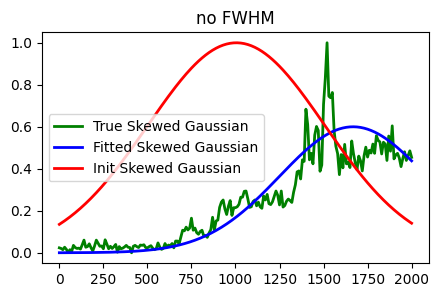

 24%|████████████████████████▋                                                                            | 1532/6255 [00:26<04:58, 15.83it/s]

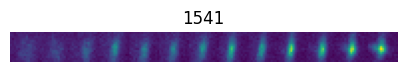

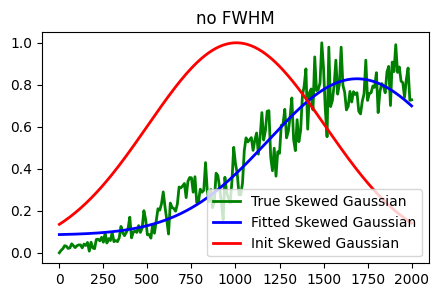

 25%|████████████████████████▉                                                                            | 1542/6255 [00:26<03:44, 20.98it/s]

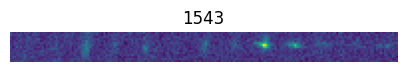

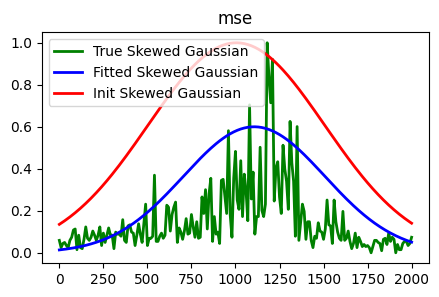

 25%|████████████████████████▉                                                                            | 1545/6255 [00:27<03:59, 19.68it/s]

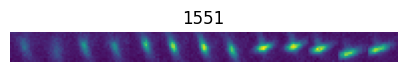

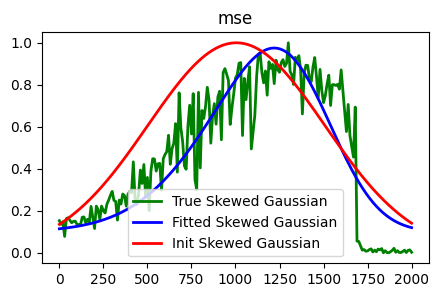

 26%|██████████████████████████▏                                                                          | 1622/6255 [00:27<00:49, 93.52it/s]

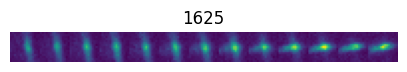

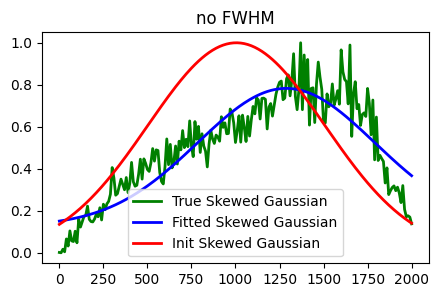

 26%|██████████████████████████▌                                                                          | 1644/6255 [00:28<01:00, 76.44it/s]

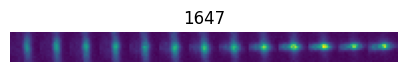

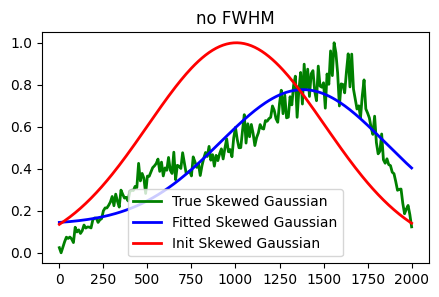

 27%|███████████████████████████▍                                                                         | 1696/6255 [00:28<00:46, 97.64it/s]

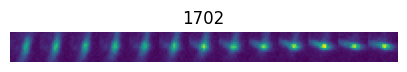

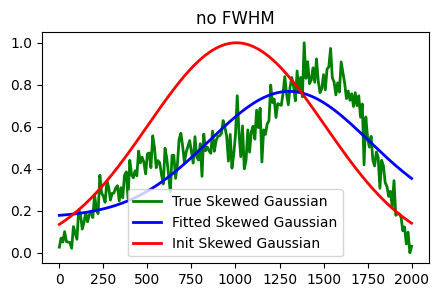

 27%|███████████████████████████▌                                                                         | 1708/6255 [00:29<01:01, 73.45it/s]

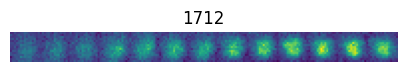

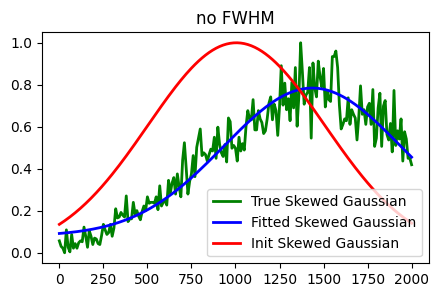

 28%|████████████████████████████▎                                                                        | 1753/6255 [00:29<00:52, 85.31it/s]

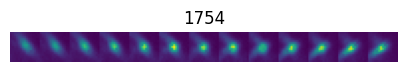

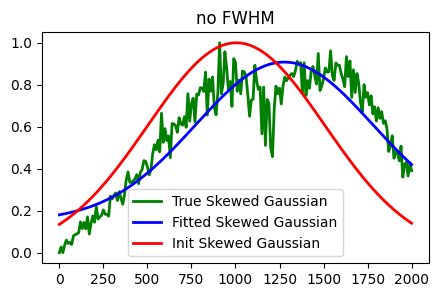

 28%|████████████████████████████▍                                                                        | 1764/6255 [00:30<01:09, 64.41it/s]

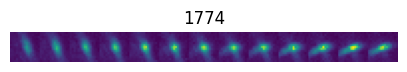

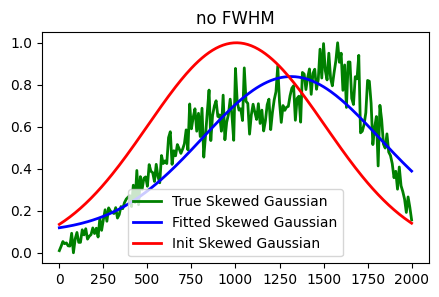

 28%|████████████████████████████▋                                                                        | 1775/6255 [00:30<01:22, 54.40it/s]

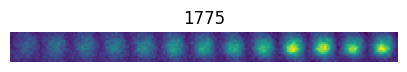

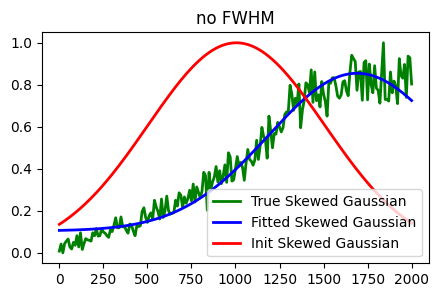

 29%|█████████████████████████████▍                                                                       | 1825/6255 [00:30<00:49, 90.41it/s]

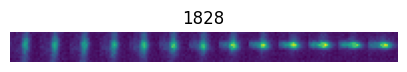

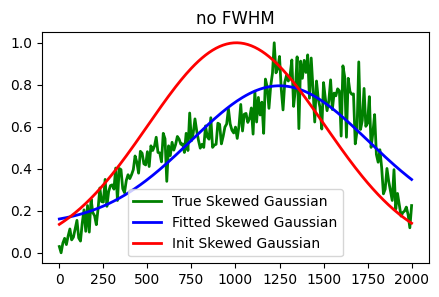

 30%|█████████████████████████████▊                                                                       | 1850/6255 [00:31<00:53, 82.11it/s]

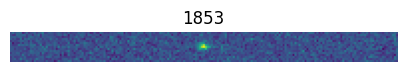

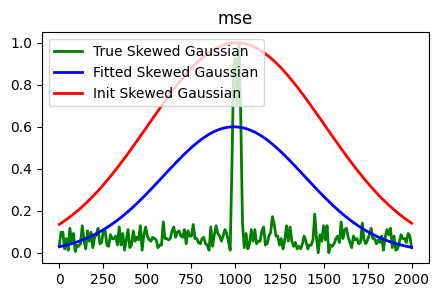

 30%|██████████████████████████████▎                                                                      | 1874/6255 [00:31<00:58, 74.60it/s]

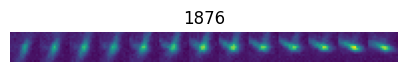

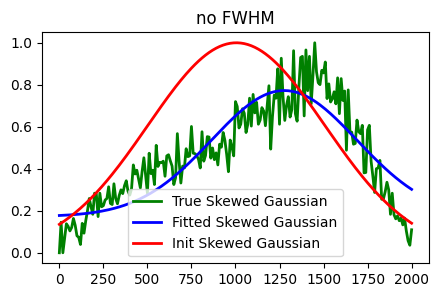

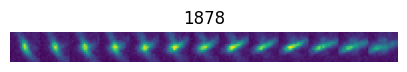

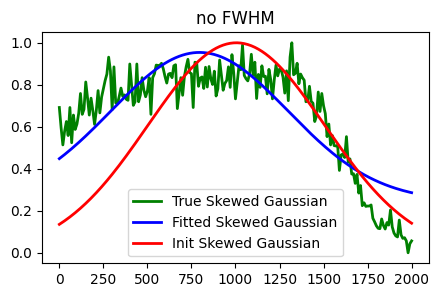

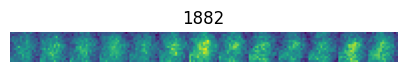

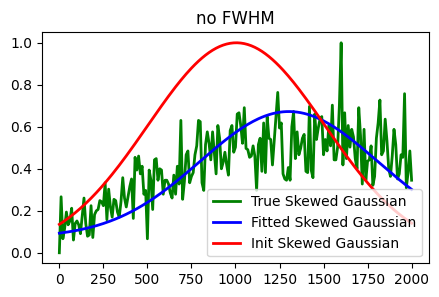

 30%|██████████████████████████████▋                                                                      | 1897/6255 [00:32<01:29, 48.78it/s]

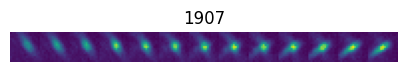

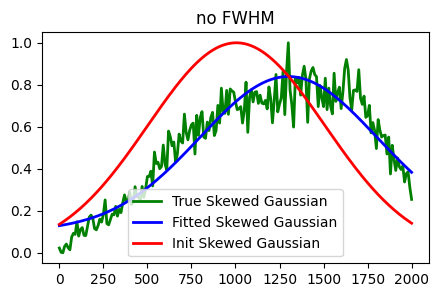

 31%|██████████████████████████████▊                                                                      | 1908/6255 [00:32<01:35, 45.72it/s]

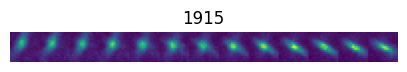

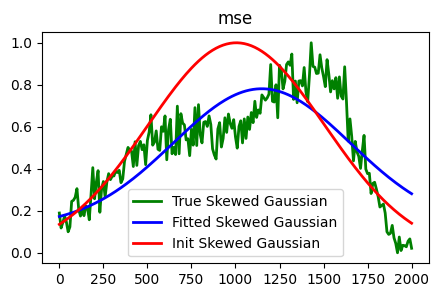

 31%|██████████████████████████████▉                                                                      | 1916/6255 [00:32<01:45, 41.30it/s]

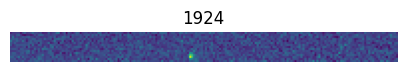

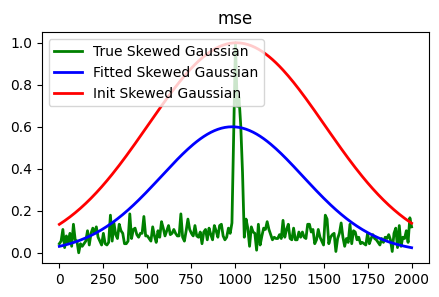

 31%|███████████████████████████████▍                                                                     | 1950/6255 [00:33<01:08, 63.06it/s]

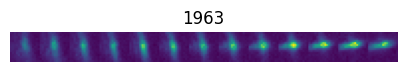

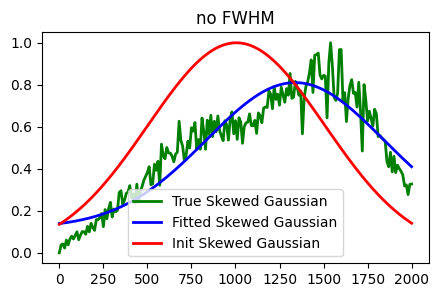

 32%|████████████████████████████████▏                                                                    | 1993/6255 [00:33<00:50, 85.13it/s]

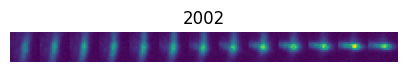

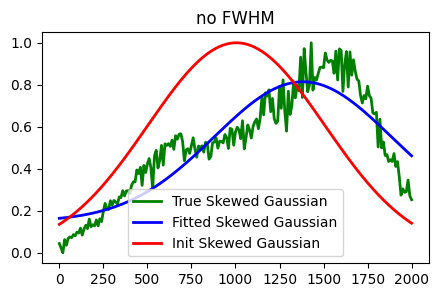

 32%|████████████████████████████████▎                                                                    | 2004/6255 [00:34<01:04, 66.31it/s]

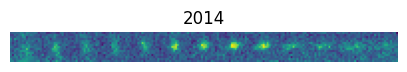

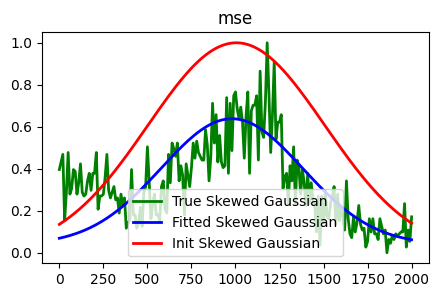

 32%|████████████████████████████████▌                                                                    | 2015/6255 [00:34<01:16, 55.37it/s]

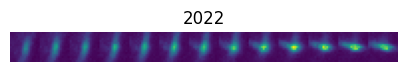

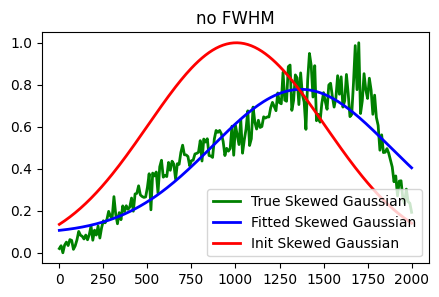

 32%|████████████████████████████████▋                                                                    | 2023/6255 [00:34<01:28, 48.02it/s]

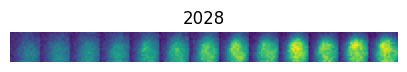

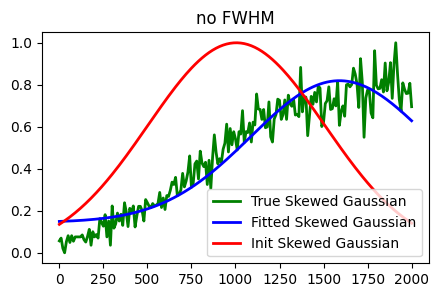

 33%|████████████████████████████████▉                                                                    | 2042/6255 [00:34<01:16, 54.80it/s]

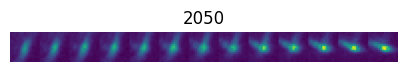

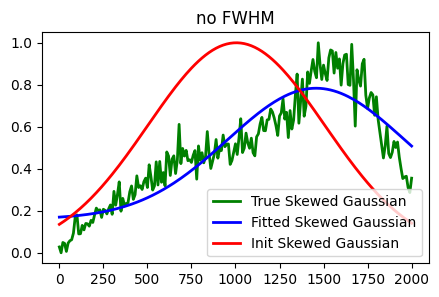

 33%|█████████████████████████████████                                                                    | 2051/6255 [00:35<01:28, 47.56it/s]

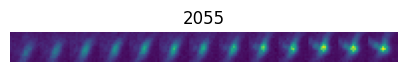

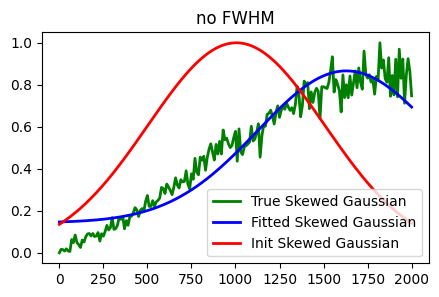

 33%|█████████████████████████████████▍                                                                   | 2071/6255 [00:35<01:20, 51.86it/s]

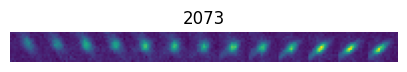

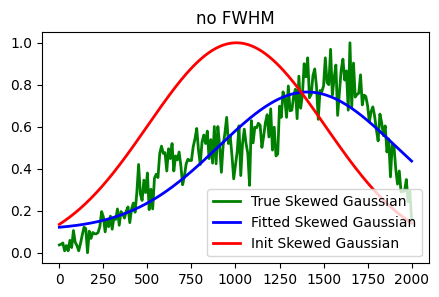

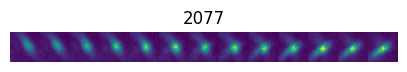

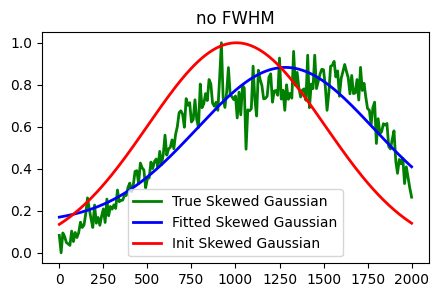

 33%|█████████████████████████████████▋                                                                   | 2087/6255 [00:36<01:39, 42.05it/s]

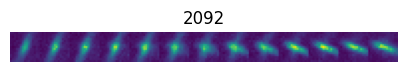

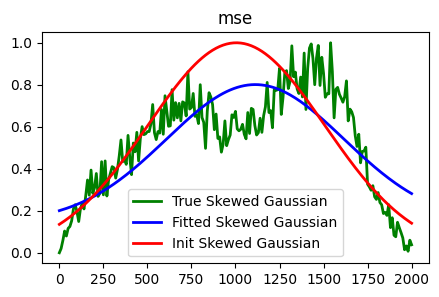

 33%|█████████████████████████████████▊                                                                   | 2094/6255 [00:36<01:47, 38.79it/s]

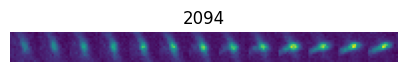

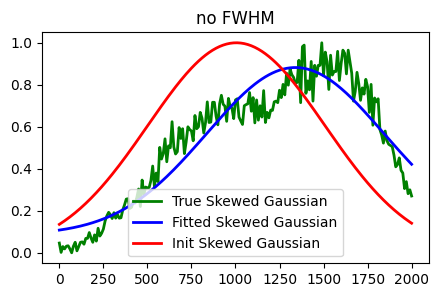

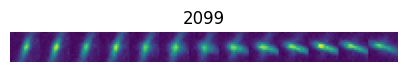

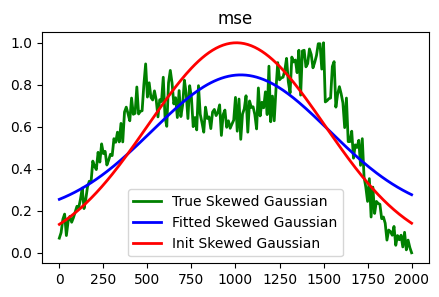

 34%|██████████████████████████████████                                                                   | 2113/6255 [00:36<01:39, 41.75it/s]

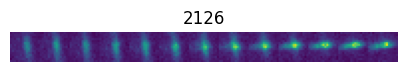

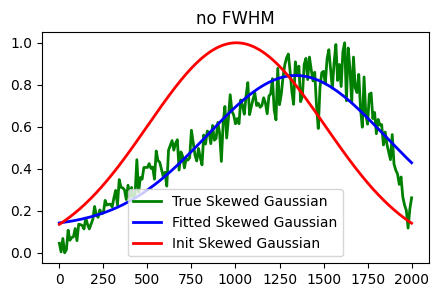

 35%|███████████████████████████████████                                                                  | 2173/6255 [00:37<00:44, 92.36it/s]

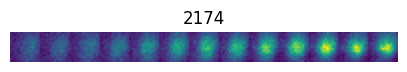

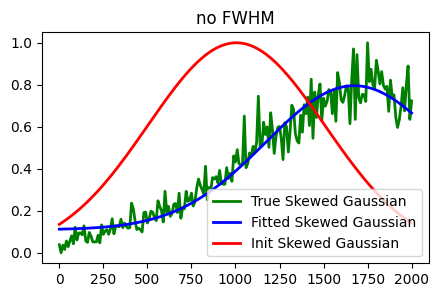

 35%|███████████████████████████████████▍                                                                 | 2197/6255 [00:37<00:50, 79.63it/s]

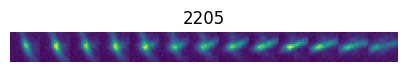

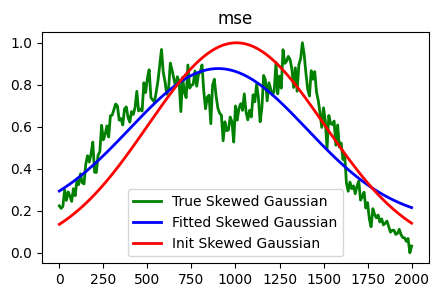

 36%|███████████████████████████████████▉                                                                 | 2223/6255 [00:38<00:51, 78.35it/s]

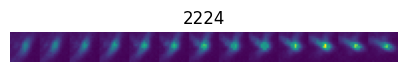

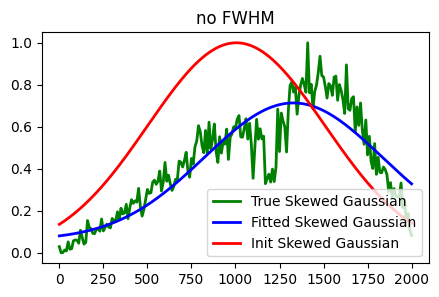

 36%|████████████████████████████████████▎                                                                | 2246/6255 [00:38<00:55, 72.75it/s]

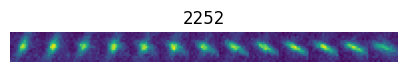

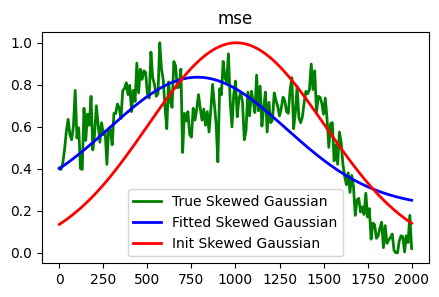

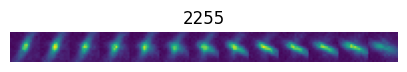

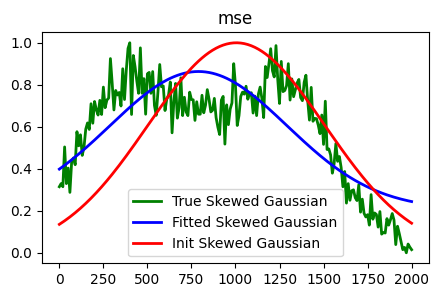

 36%|████████████████████████████████████▍                                                                | 2256/6255 [00:39<01:28, 45.09it/s]

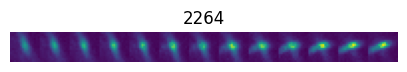

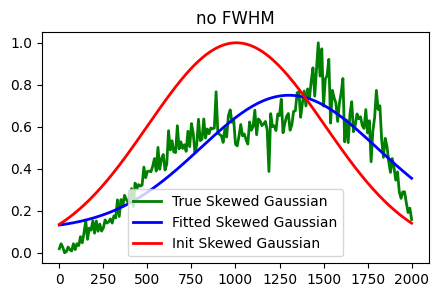

 36%|████████████████████████████████████▊                                                                | 2278/6255 [00:39<01:12, 54.70it/s]

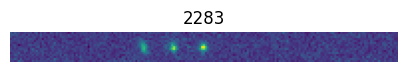

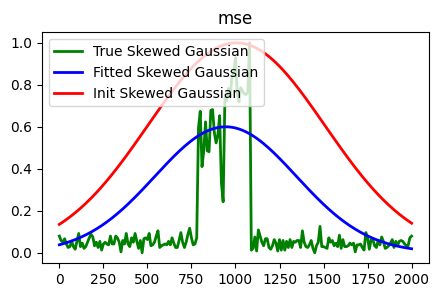

 37%|█████████████████████████████████████                                                                | 2296/6255 [00:39<01:10, 56.41it/s]

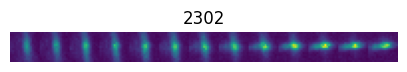

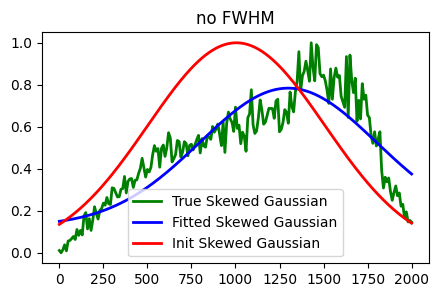

 38%|█████████████████████████████████████▉                                                              | 2373/6255 [00:40<00:36, 106.65it/s]

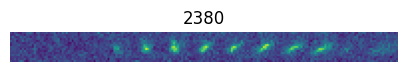

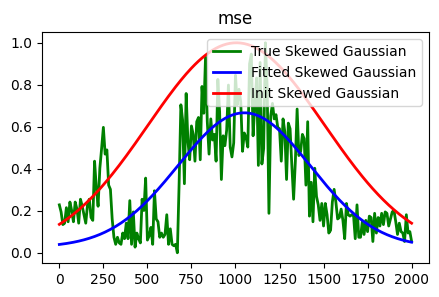

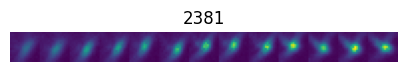

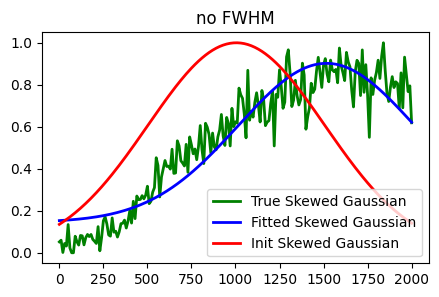

 39%|███████████████████████████████████████▎                                                             | 2433/6255 [00:41<00:40, 95.31it/s]

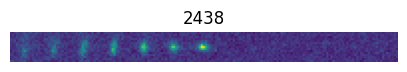

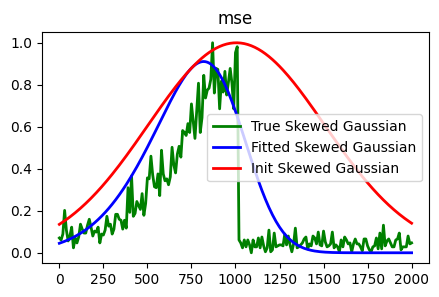

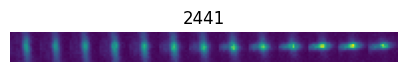

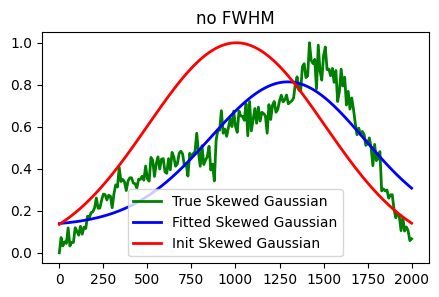

 40%|████████████████████████████████████████▍                                                           | 2530/6255 [00:42<00:33, 112.44it/s]

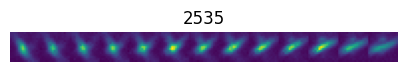

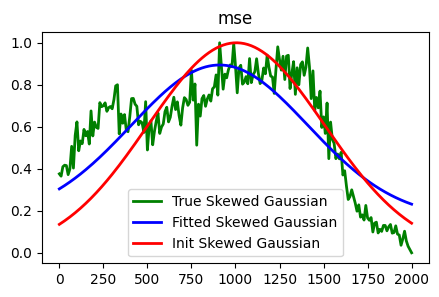

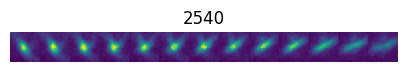

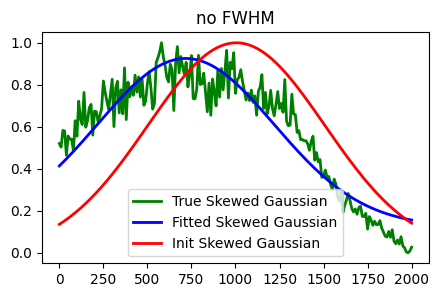

 41%|█████████████████████████████████████████                                                            | 2543/6255 [00:43<01:01, 60.02it/s]

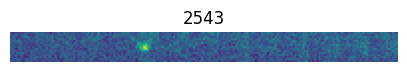

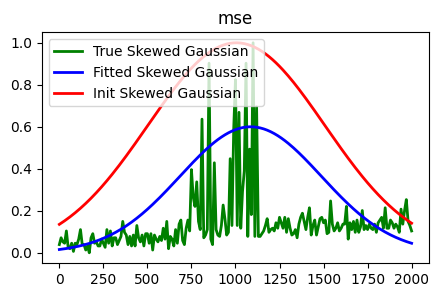

 42%|██████████████████████████████████████████▎                                                         | 2645/6255 [00:44<00:30, 117.17it/s]

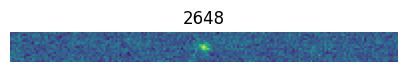

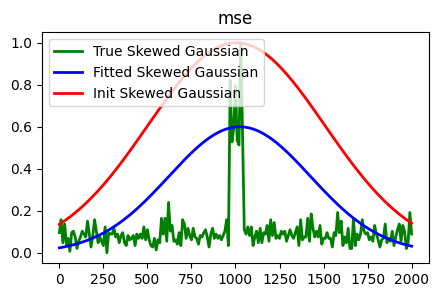

 43%|███████████████████████████████████████████▎                                                         | 2681/6255 [00:44<00:39, 91.25it/s]

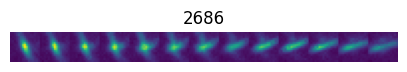

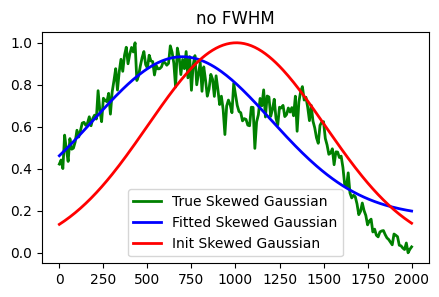

 43%|███████████████████████████████████████████▊                                                         | 2714/6255 [00:44<00:42, 82.95it/s]

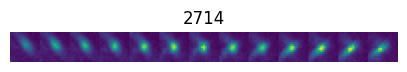

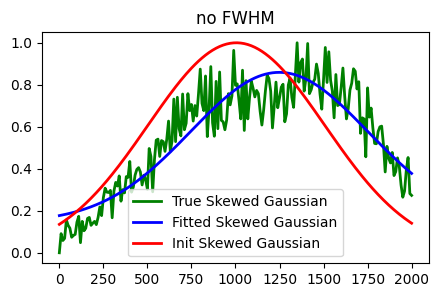

 44%|████████████████████████████████████████████▏                                                        | 2734/6255 [00:45<00:50, 69.13it/s]

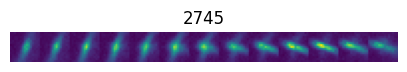

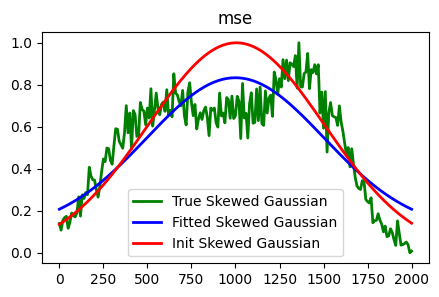

 44%|████████████████████████████████████████████▌                                                        | 2760/6255 [00:45<00:49, 71.02it/s]

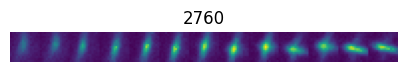

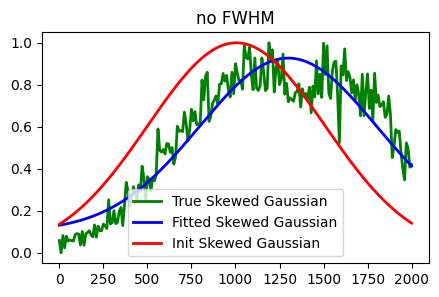

 45%|█████████████████████████████████████████████▎                                                       | 2810/6255 [00:46<00:36, 93.91it/s]

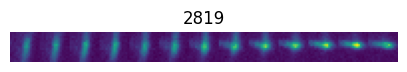

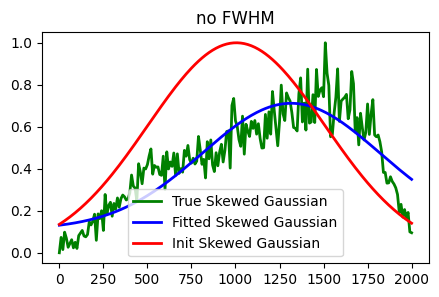

 46%|█████████████████████████████████████████████▉                                                       | 2848/6255 [00:46<00:37, 91.44it/s]

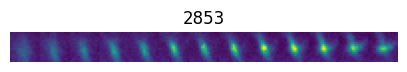

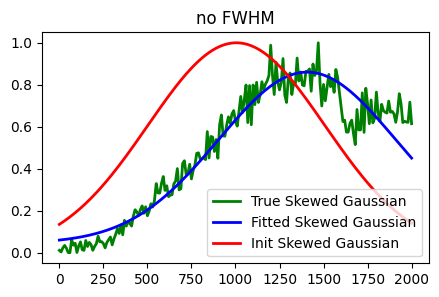

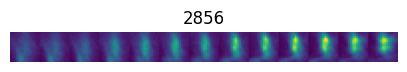

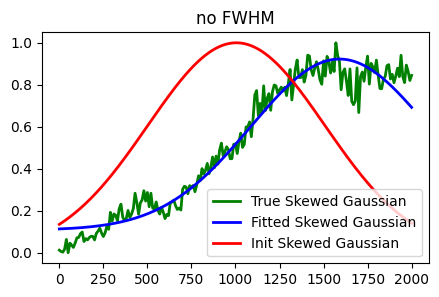

 46%|██████████████████████████████████████████████▏                                                      | 2859/6255 [00:47<01:04, 52.96it/s]

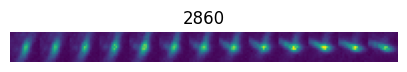

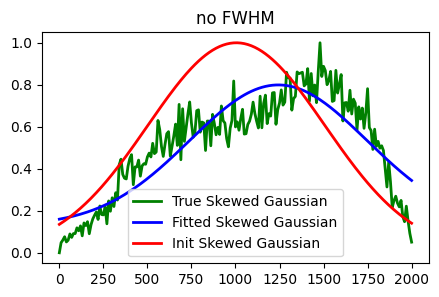

 46%|██████████████████████████████████████████████▌                                                      | 2882/6255 [00:47<00:55, 60.74it/s]

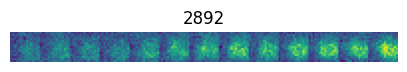

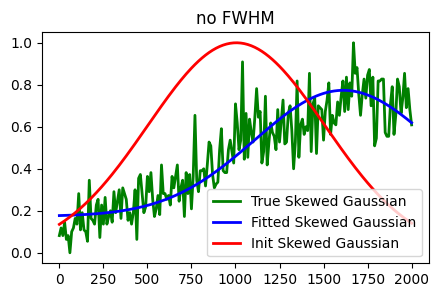

 46%|██████████████████████████████████████████████▋                                                      | 2893/6255 [00:47<01:03, 52.99it/s]

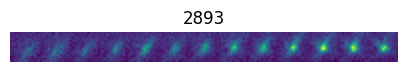

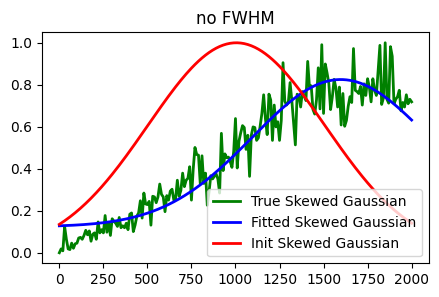

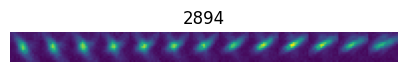

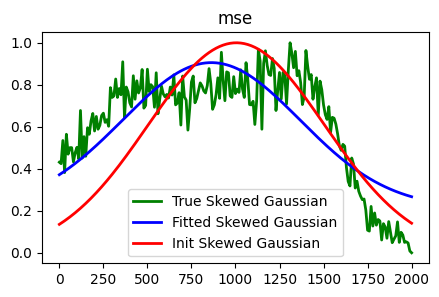

 47%|███████████████████████████████████████████████▏                                                     | 2922/6255 [00:48<01:00, 54.89it/s]

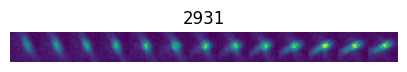

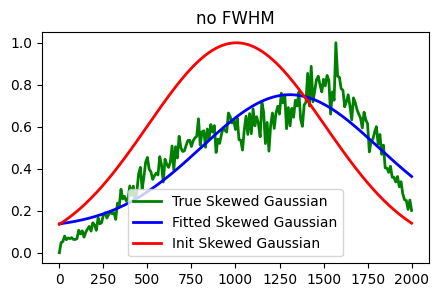

 48%|████████████████████████████████████████████████                                                    | 3003/6255 [00:49<00:31, 102.77it/s]

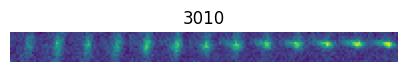

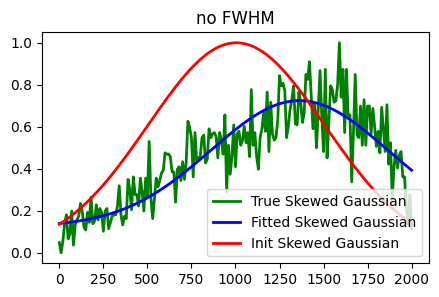

 49%|████████████████████████████████████████████████▊                                                   | 3054/6255 [00:49<00:31, 100.71it/s]

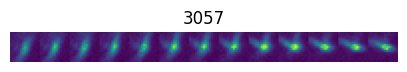

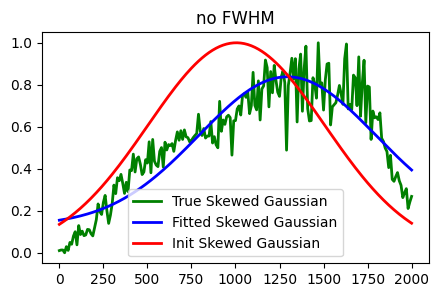

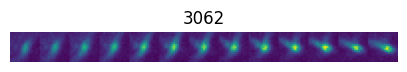

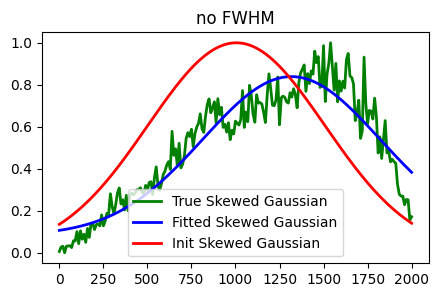

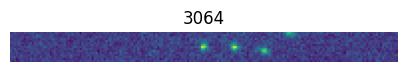

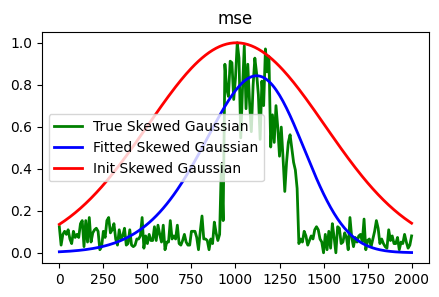

 49%|█████████████████████████████████████████████████▌                                                   | 3066/6255 [00:50<01:13, 43.56it/s]

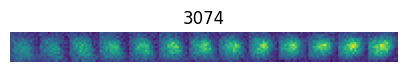

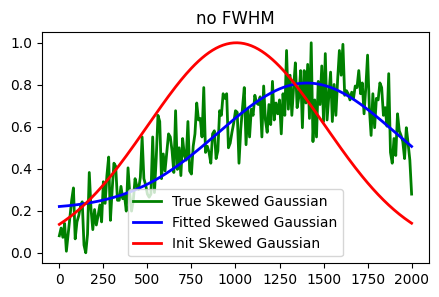

 49%|█████████████████████████████████████████████████▋                                                   | 3075/6255 [00:50<01:17, 40.85it/s]

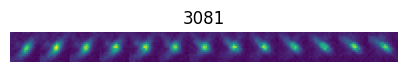

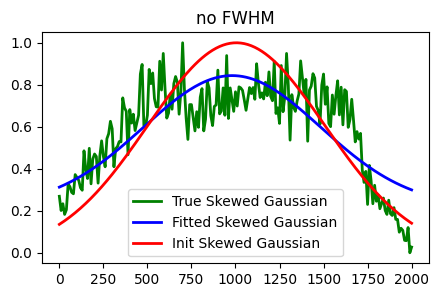

 49%|█████████████████████████████████████████████████▊                                                   | 3082/6255 [00:51<02:16, 23.32it/s]

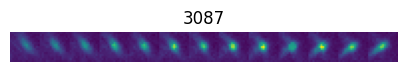

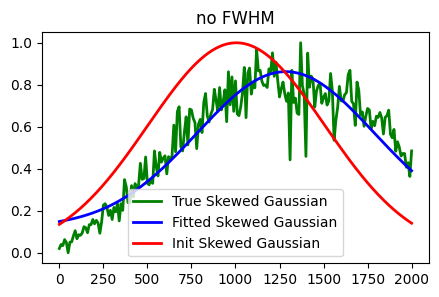

 50%|██████████████████████████████████████████████████▏                                                  | 3109/6255 [00:52<01:15, 41.72it/s]

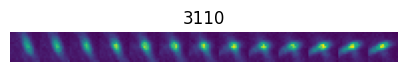

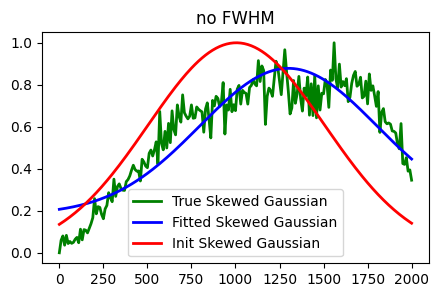

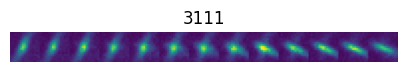

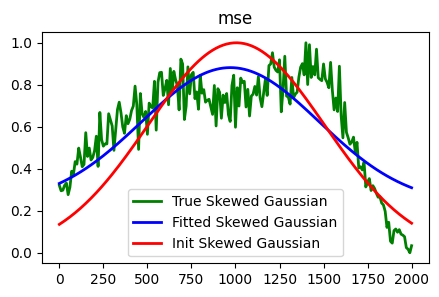

 50%|██████████████████████████████████████████████████▎                                                  | 3117/6255 [00:52<01:37, 32.14it/s]

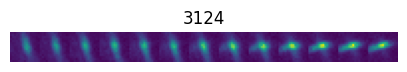

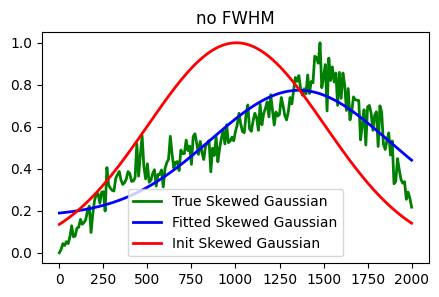

 50%|██████████████████████████████████████████████████▉                                                  | 3152/6255 [00:52<00:51, 60.78it/s]

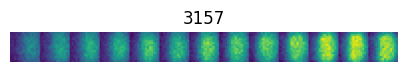

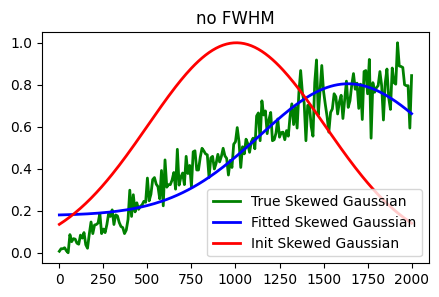

 51%|███████████████████████████████████████████████████▎                                                 | 3178/6255 [00:53<00:43, 70.13it/s]

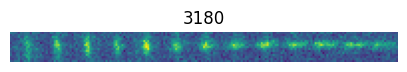

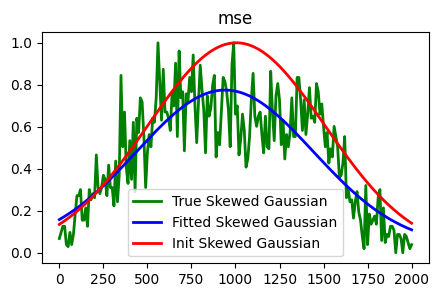

 51%|███████████████████████████████████████████████████▍                                                 | 3188/6255 [00:53<00:52, 58.79it/s]

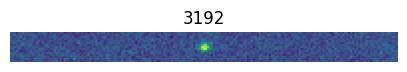

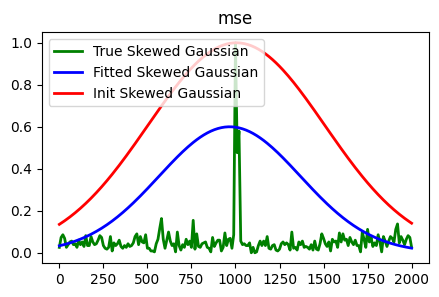

 51%|███████████████████████████████████████████████████▌                                                 | 3197/6255 [00:53<01:04, 47.06it/s]

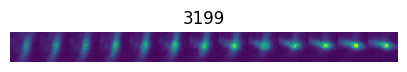

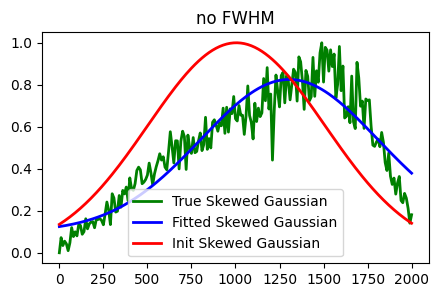

 51%|███████████████████████████████████████████████████▋                                                 | 3204/6255 [00:54<01:13, 41.61it/s]

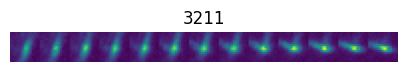

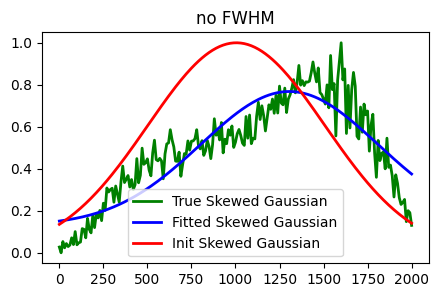

 51%|███████████████████████████████████████████████████▊                                                 | 3212/6255 [00:54<01:17, 39.35it/s]

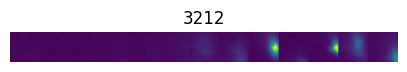

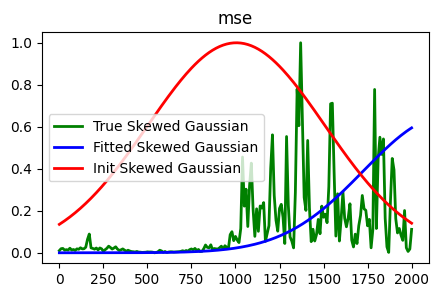

 51%|███████████████████████████████████████████████████▉                                                 | 3217/6255 [00:54<01:29, 33.96it/s]

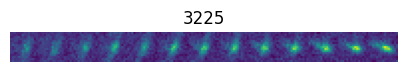

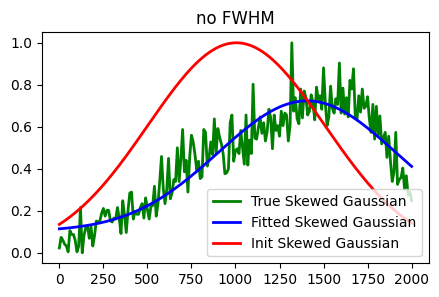

 52%|████████████████████████████████████████████████████                                                 | 3226/6255 [00:54<01:27, 34.78it/s]

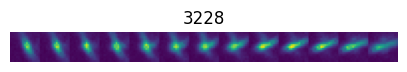

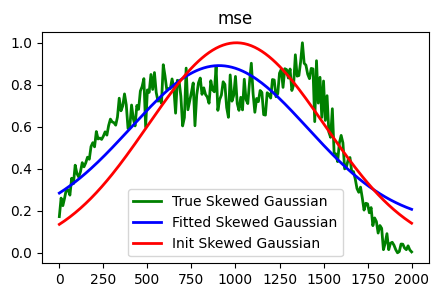

 52%|████████████████████████████████████████████████████▏                                                | 3230/6255 [00:55<01:38, 30.56it/s]

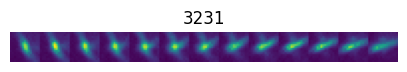

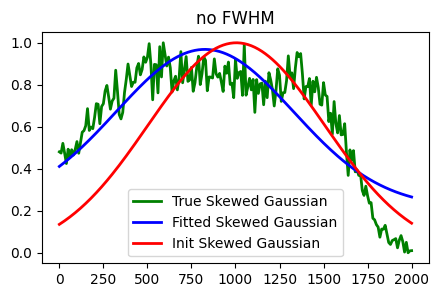

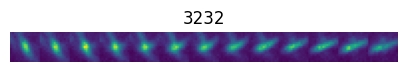

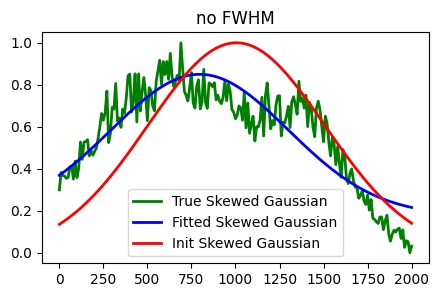

 52%|████████████████████████████████████████████████████▍                                                | 3246/6255 [00:55<01:24, 35.45it/s]

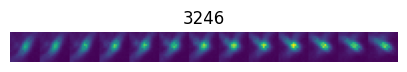

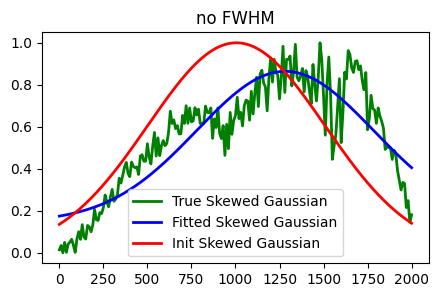

 52%|████████████████████████████████████████████████████▌                                                | 3252/6255 [00:55<01:32, 32.62it/s]

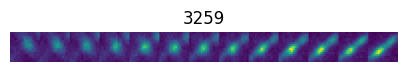

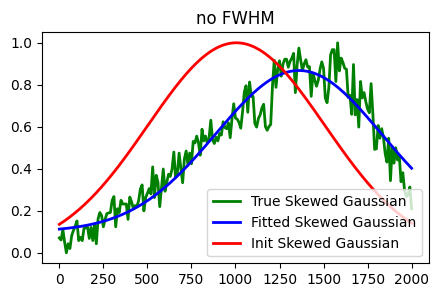

 52%|████████████████████████████████████████████████████▊                                                | 3270/6255 [00:56<01:11, 41.78it/s]

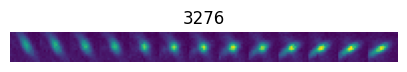

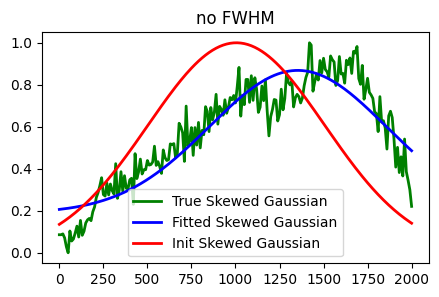

 52%|████████████████████████████████████████████████████▉                                                | 3277/6255 [00:56<01:20, 37.09it/s]

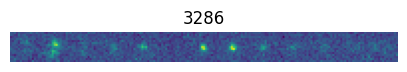

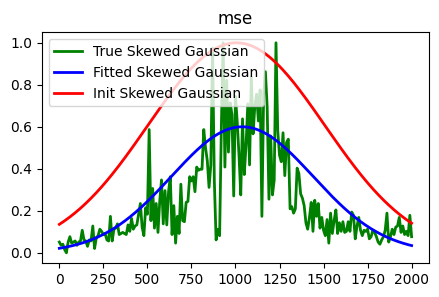

 53%|█████████████████████████████████████████████████████▌                                               | 3315/6255 [00:56<00:42, 68.82it/s]

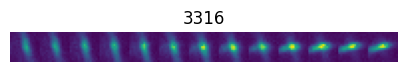

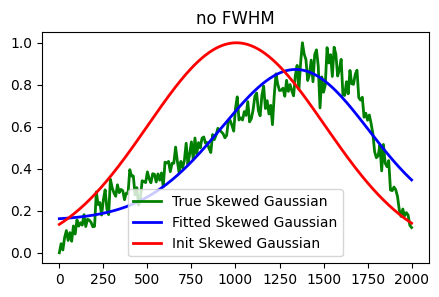

 53%|█████████████████████████████████████████████████████▋                                               | 3324/6255 [00:57<00:53, 54.44it/s]

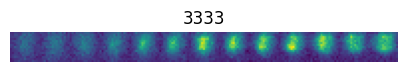

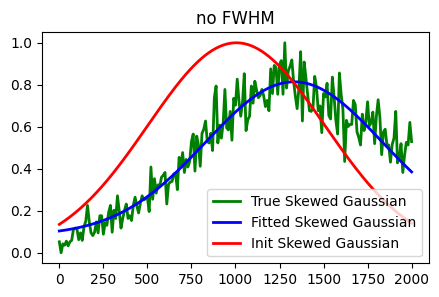

 54%|██████████████████████████████████████████████████████▎                                              | 3363/6255 [00:57<00:36, 79.59it/s]

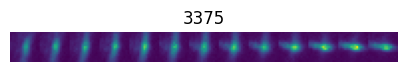

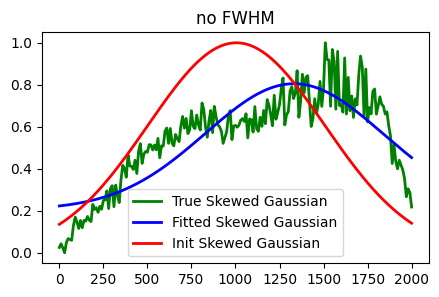

 55%|███████████████████████████████████████████████████████▌                                             | 3439/6255 [00:58<00:28, 99.37it/s]

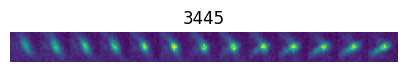

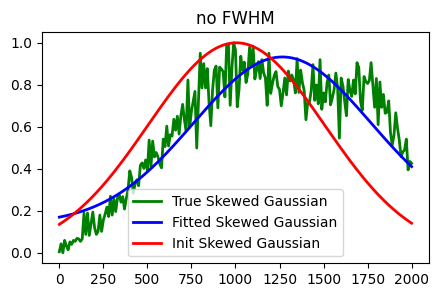

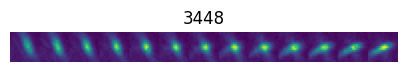

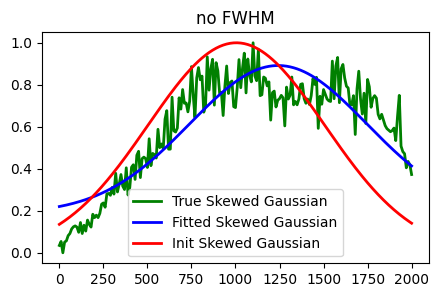

 55%|███████████████████████████████████████████████████████▋                                             | 3450/6255 [00:58<00:53, 52.23it/s]

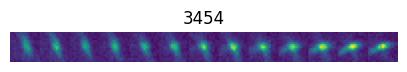

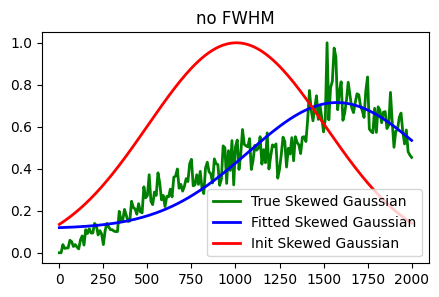

 56%|████████████████████████████████████████████████████████                                             | 3474/6255 [00:59<00:44, 62.35it/s]

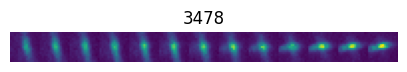

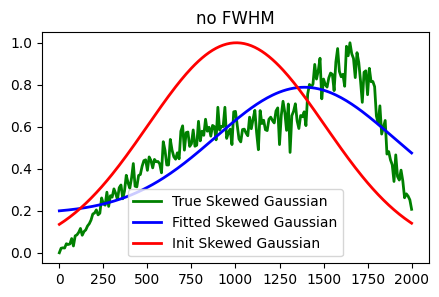

 56%|████████████████████████████████████████████████████████▎                                            | 3484/6255 [00:59<00:50, 54.86it/s]

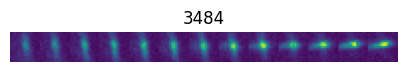

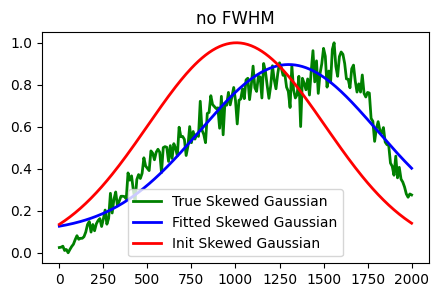

 57%|█████████████████████████████████████████████████████████                                           | 3569/6255 [01:00<00:25, 107.01it/s]

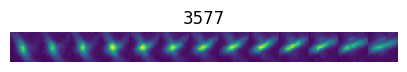

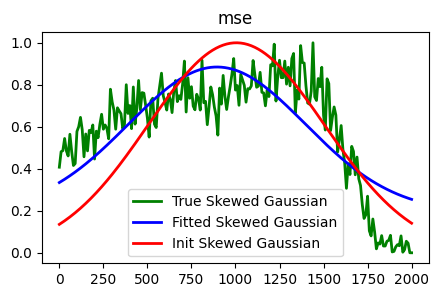

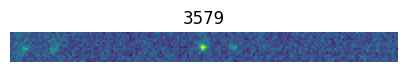

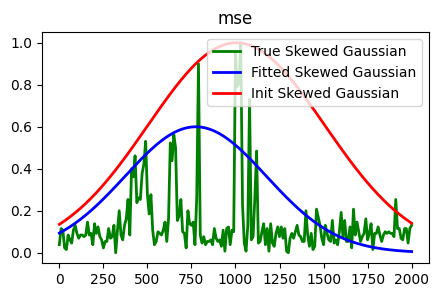

 58%|██████████████████████████████████████████████████████████▏                                          | 3602/6255 [01:01<00:39, 67.83it/s]

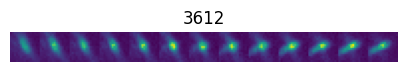

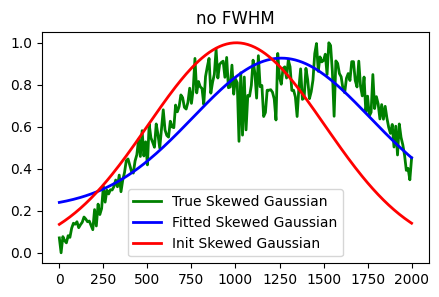

 60%|███████████████████████████████████████████████████████████▌                                        | 3727/6255 [01:02<00:21, 118.03it/s]

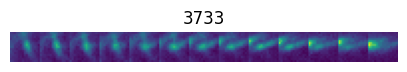

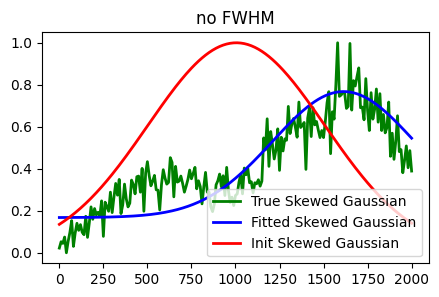

 60%|████████████████████████████████████████████████████████████▍                                        | 3740/6255 [01:02<00:33, 74.08it/s]

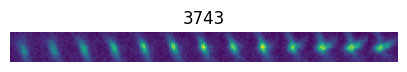

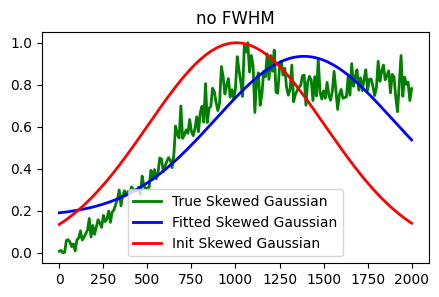

 60%|████████████████████████████████████████████████████████████▌                                        | 3750/6255 [01:02<00:42, 59.61it/s]

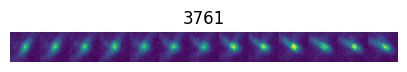

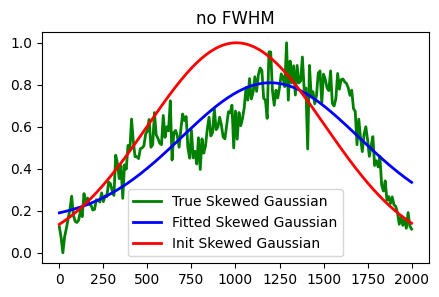

 60%|████████████████████████████████████████████████████████████▉                                        | 3773/6255 [01:03<00:39, 62.29it/s]

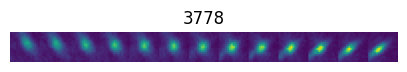

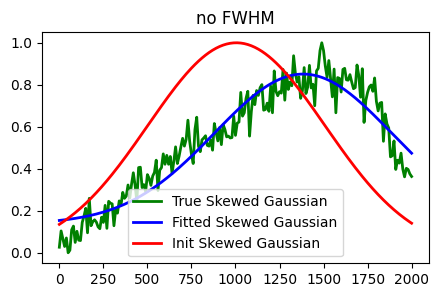

 60%|█████████████████████████████████████████████████████████████                                        | 3781/6255 [01:03<00:49, 50.45it/s]

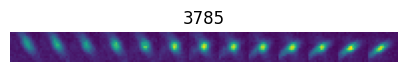

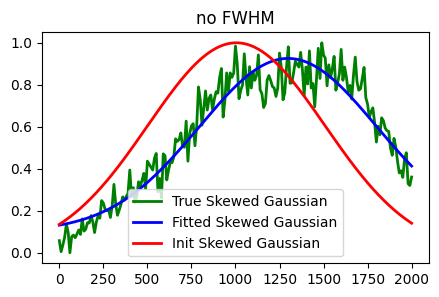

 61%|█████████████████████████████████████████████████████████████▏                                       | 3788/6255 [01:03<00:58, 42.17it/s]

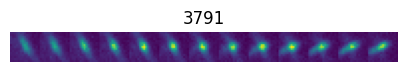

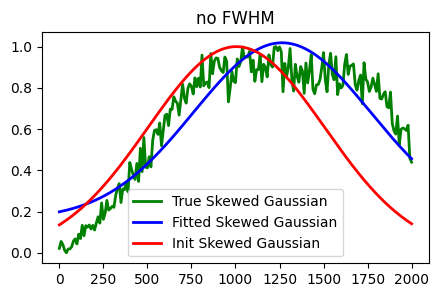

 61%|█████████████████████████████████████████████████████████████▎                                       | 3794/6255 [01:04<01:05, 37.48it/s]

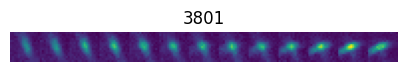

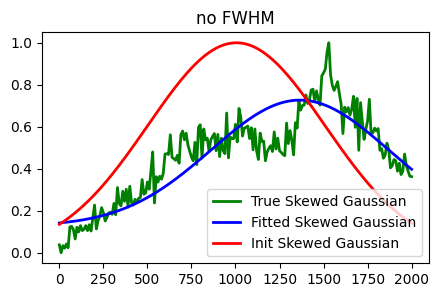

 61%|█████████████████████████████████████████████████████████████▋                                       | 3824/6255 [01:04<00:42, 57.29it/s]

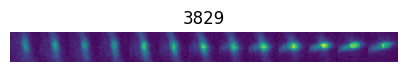

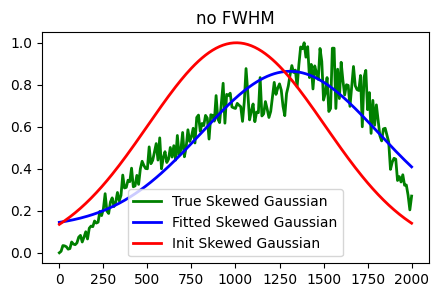

 61%|█████████████████████████████████████████████████████████████▉                                       | 3832/6255 [01:04<00:50, 48.24it/s]

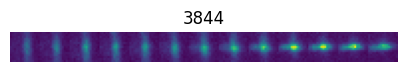

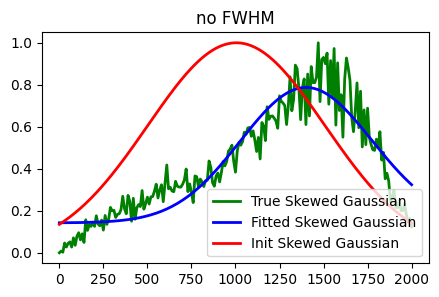

 61%|██████████████████████████████████████████████████████████████                                       | 3845/6255 [01:04<00:50, 47.80it/s]

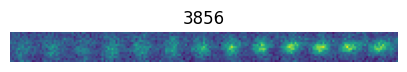

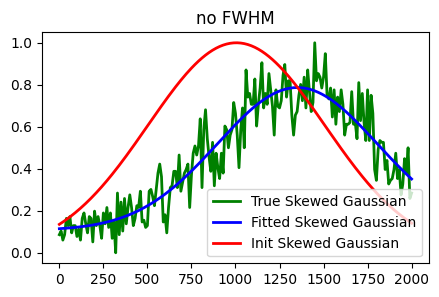

 62%|██████████████████████████████████████████████████████████████▉                                      | 3894/6255 [01:05<00:28, 81.44it/s]

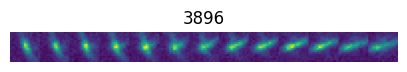

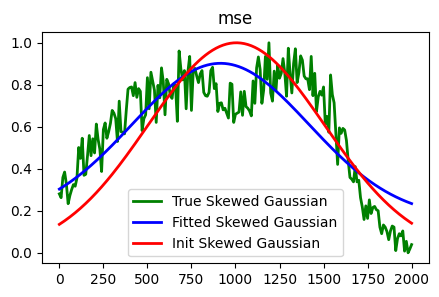

 63%|███████████████████████████████████████████████████████████████▌                                     | 3939/6255 [01:06<00:26, 88.10it/s]

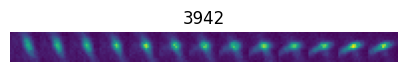

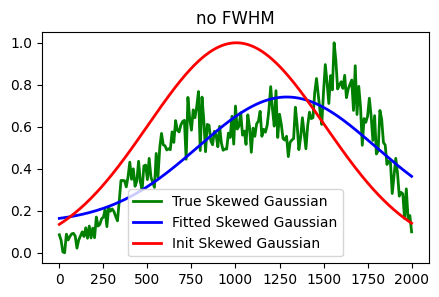

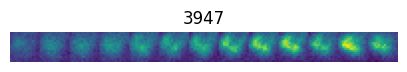

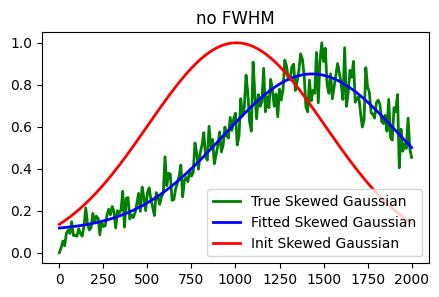

 64%|████████████████████████████████████████████████████████████████▌                                    | 3998/6255 [01:06<00:24, 91.87it/s]

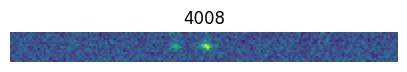

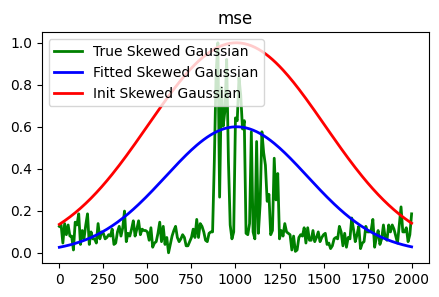

 64%|████████████████████████████████████████████████████████████████▋                                    | 4010/6255 [01:07<00:32, 69.41it/s]

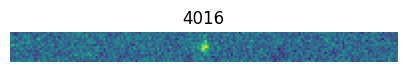

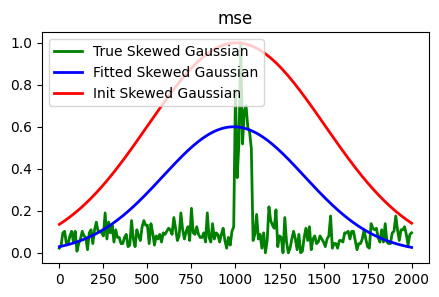

 65%|█████████████████████████████████████████████████████████████████▌                                   | 4063/6255 [01:07<00:22, 95.94it/s]

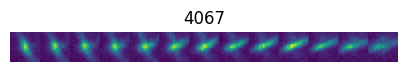

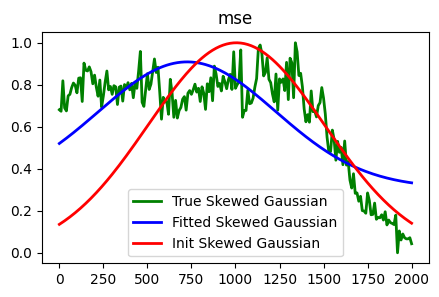

 65%|██████████████████████████████████████████████████████████████████▏                                  | 4096/6255 [01:08<00:25, 83.50it/s]

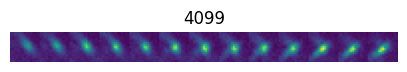

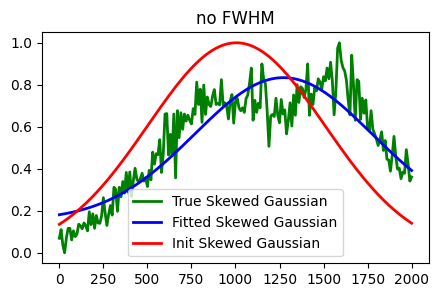

 66%|██████████████████████████████████████████████████████████████████▎                                  | 4106/6255 [01:08<00:36, 58.78it/s]

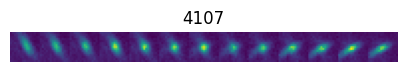

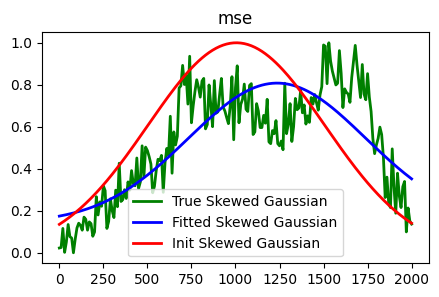

 66%|██████████████████████████████████████████████████████████████████▍                                  | 4114/6255 [01:08<00:44, 48.58it/s]

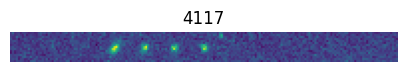

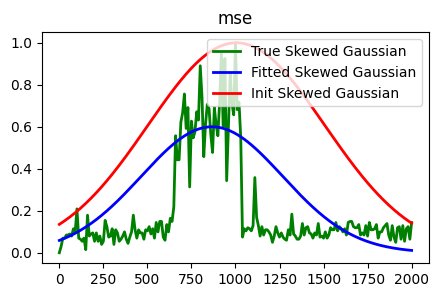

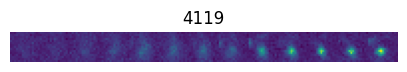

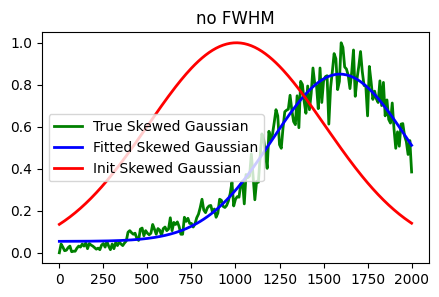

 66%|██████████████████████████████████████████████████████████████████▋                                  | 4133/6255 [01:09<00:47, 45.04it/s]

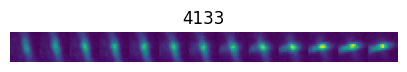

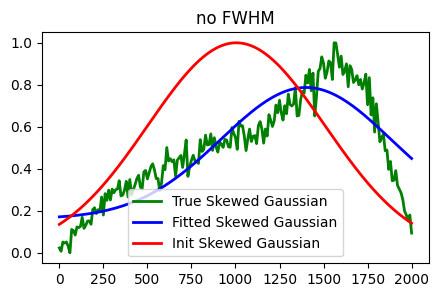

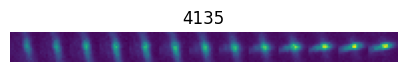

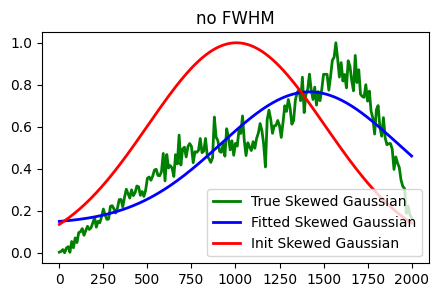

 66%|███████████████████████████████████████████████████████████████████                                  | 4152/6255 [01:09<00:47, 44.51it/s]

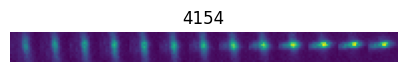

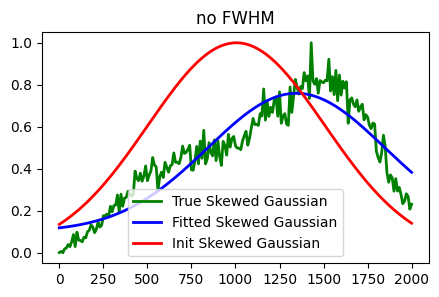

 67%|████████████████████████████████████████████████████████████████████                                 | 4212/6255 [01:10<00:21, 93.05it/s]

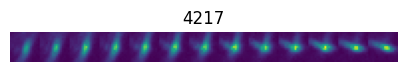

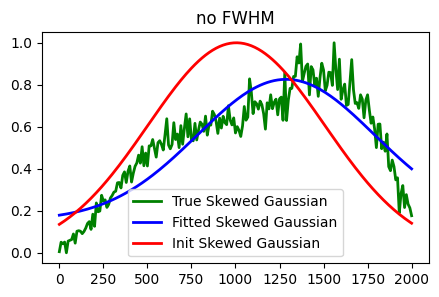

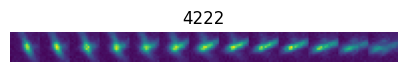

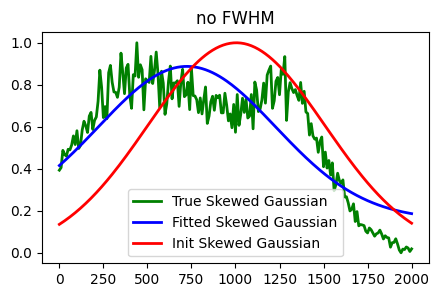

 68%|████████████████████████████████████████████████████████████████████▍                                | 4235/6255 [01:11<00:31, 63.16it/s]

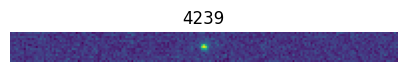

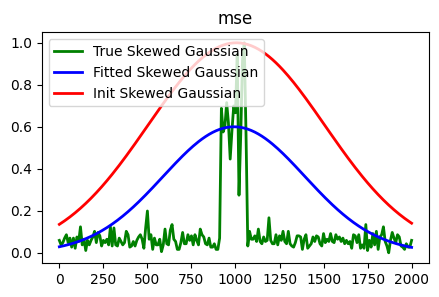

 68%|████████████████████████████████████████████████████████████████████▌                                | 4245/6255 [01:11<00:38, 51.88it/s]

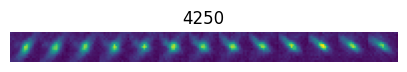

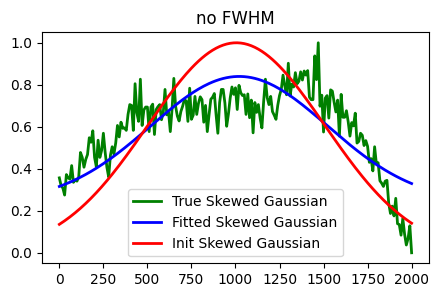

 68%|████████████████████████████████████████████████████████████████████▊                                | 4265/6255 [01:11<00:34, 57.50it/s]

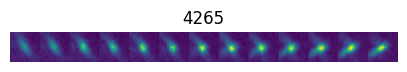

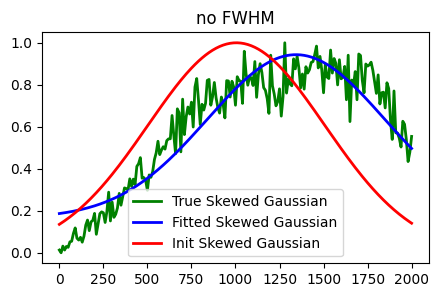

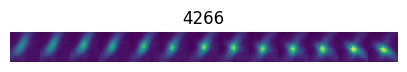

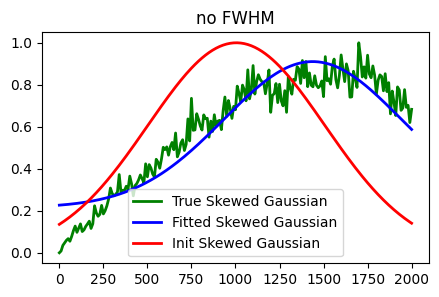

 68%|████████████████████████████████████████████████████████████████████▉                                | 4273/6255 [01:12<00:51, 38.57it/s]

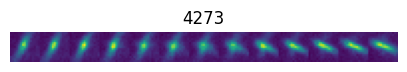

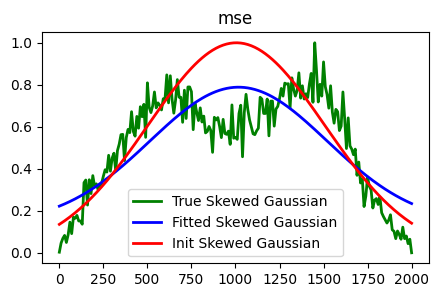

 69%|█████████████████████████████████████████████████████████████████████▎                               | 4294/6255 [01:12<00:37, 51.83it/s]

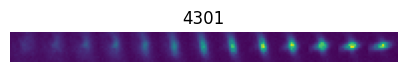

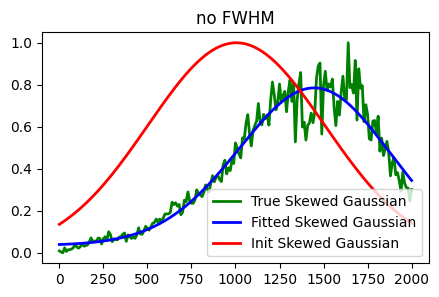

 69%|█████████████████████████████████████████████████████████████████████▍                               | 4302/6255 [01:12<00:42, 45.65it/s]

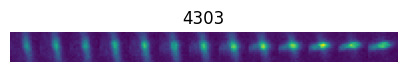

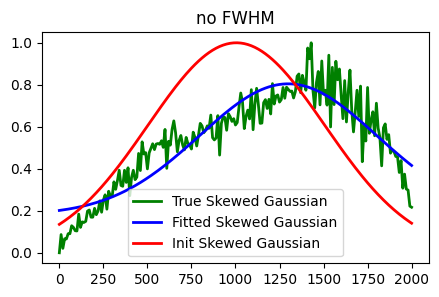

 69%|█████████████████████████████████████████████████████████████████████▊                               | 4324/6255 [01:13<00:33, 58.47it/s]

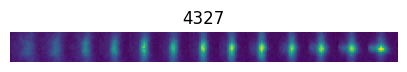

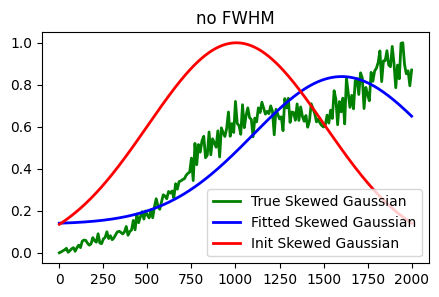

 71%|██████████████████████████████████████████████████████████████████████▌                             | 4417/6255 [01:13<00:17, 106.62it/s]

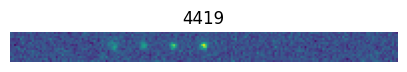

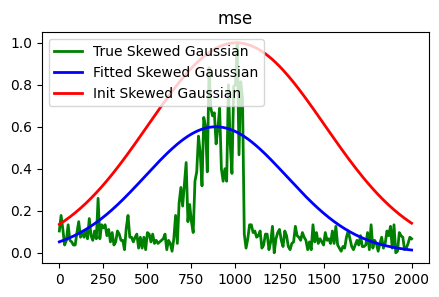

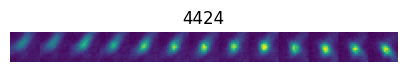

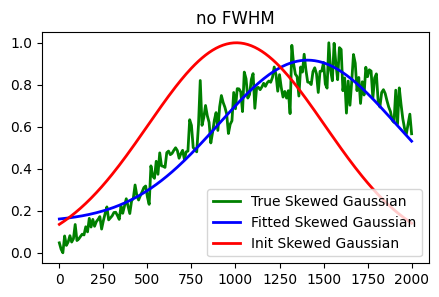

 71%|███████████████████████████████████████████████████████████████████████▌                             | 4429/6255 [01:14<00:32, 56.09it/s]

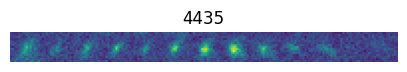

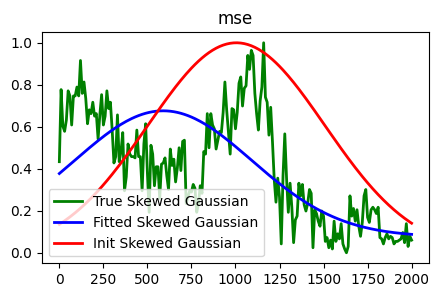

 71%|███████████████████████████████████████████████████████████████████████▋                             | 4438/6255 [01:14<00:36, 49.45it/s]

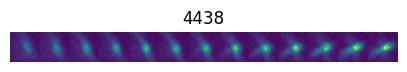

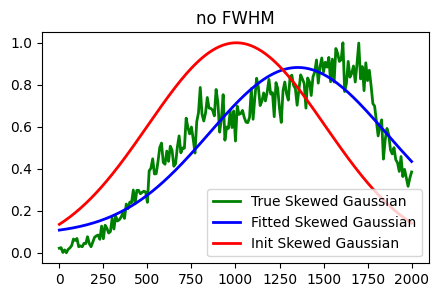

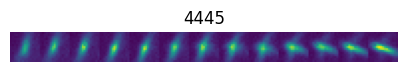

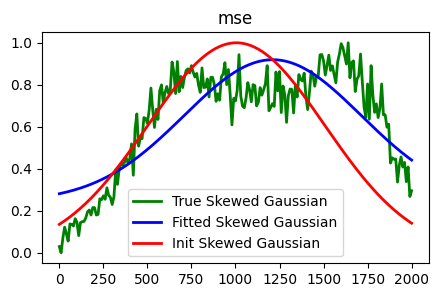

 72%|████████████████████████████████████████████████████████████████████████▏                            | 4474/6255 [01:15<00:28, 62.72it/s]

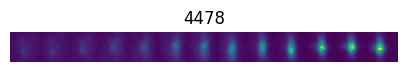

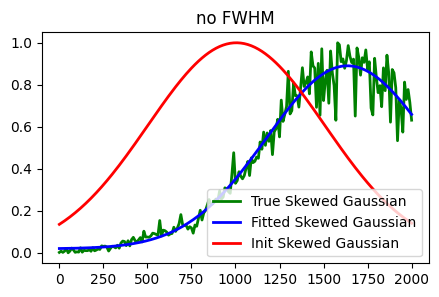

 73%|████████████████████████████████████████████████████████████████████████▋                           | 4550/6255 [01:16<00:15, 110.70it/s]

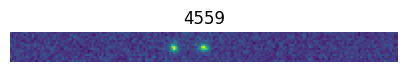

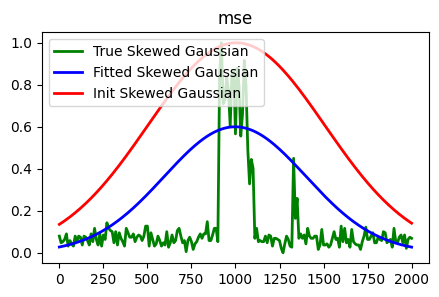

 73%|█████████████████████████████████████████████████████████████████████████▋                           | 4563/6255 [01:16<00:20, 82.23it/s]

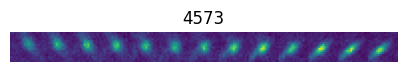

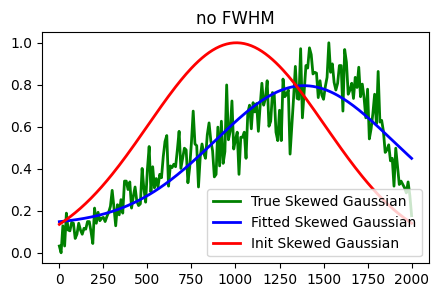

 73%|██████████████████████████████████████████████████████████████████████████                           | 4587/6255 [01:17<00:35, 46.56it/s]

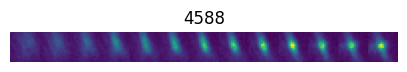

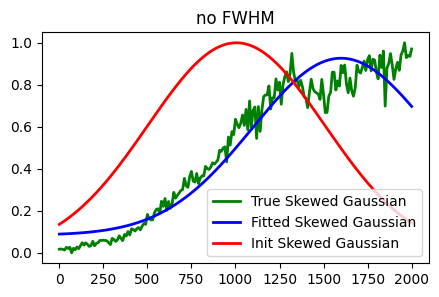

 73%|██████████████████████████████████████████████████████████████████████████▏                          | 4597/6255 [01:17<00:36, 44.83it/s]

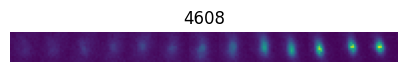

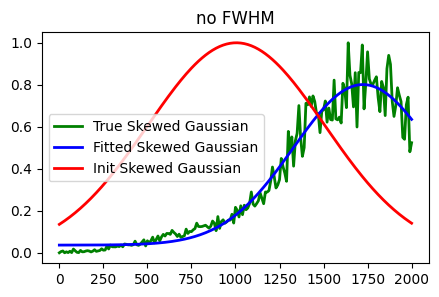

 74%|██████████████████████████████████████████████████████████████████████████▉                          | 4638/6255 [01:18<00:22, 71.93it/s]

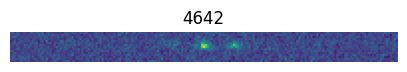

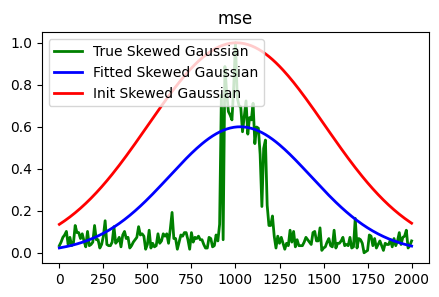

 75%|███████████████████████████████████████████████████████████████████████████▉                         | 4706/6255 [01:18<00:15, 99.51it/s]

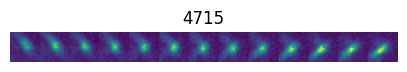

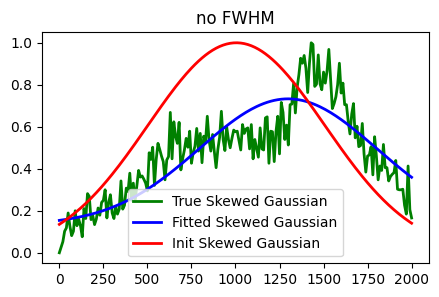

 77%|█████████████████████████████████████████████████████████████████████████████▍                      | 4843/6255 [01:19<00:11, 118.73it/s]

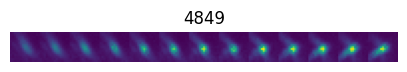

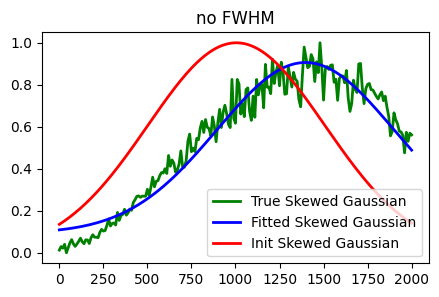

 80%|███████████████████████████████████████████████████████████████████████████████▋                    | 4982/6255 [01:21<00:09, 136.43it/s]

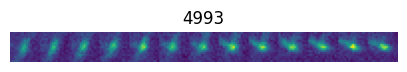

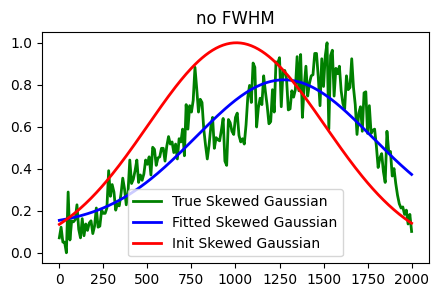

 80%|████████████████████████████████████████████████████████████████████████████████▊                    | 5008/6255 [01:21<00:13, 90.96it/s]

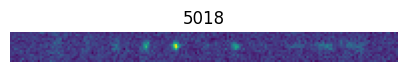

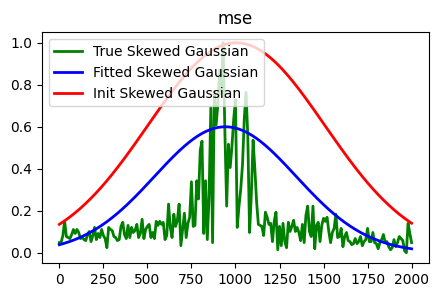

 80%|█████████████████████████████████████████████████████████████████████████████████                    | 5019/6255 [01:21<00:18, 67.47it/s]

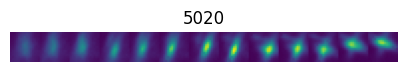

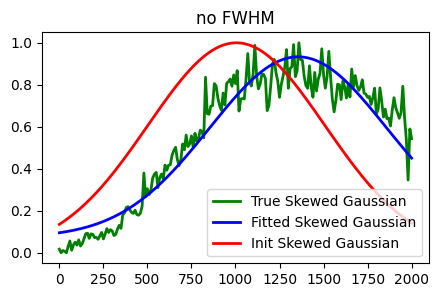

 81%|██████████████████████████████████████████████████████████████████████████████████                   | 5079/6255 [01:22<00:11, 98.25it/s]

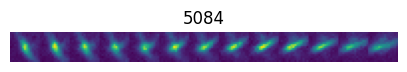

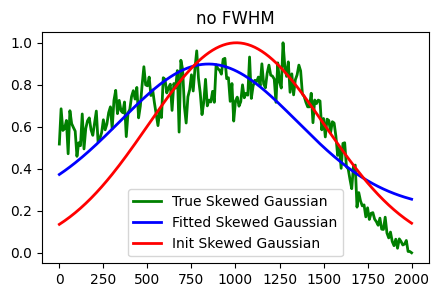

 82%|██████████████████████████████████████████████████████████████████████████████████▏                 | 5143/6255 [01:23<00:10, 107.42it/s]

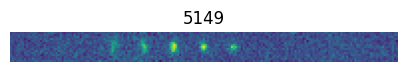

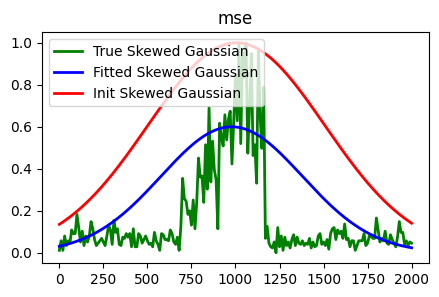

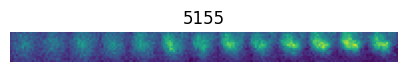

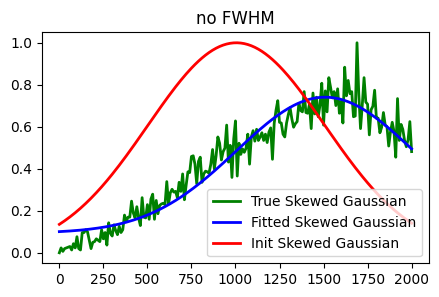

 84%|███████████████████████████████████████████████████████████████████████████████████▊                | 5246/6255 [01:24<00:08, 119.87it/s]

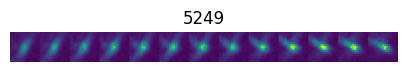

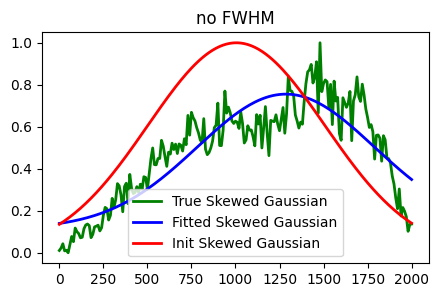

 84%|█████████████████████████████████████████████████████████████████████████████████████                | 5271/6255 [01:24<00:11, 83.18it/s]

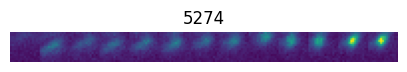

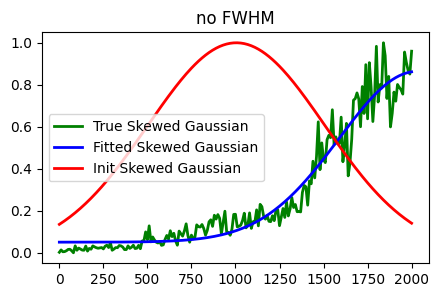

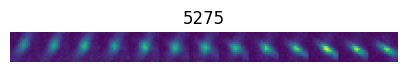

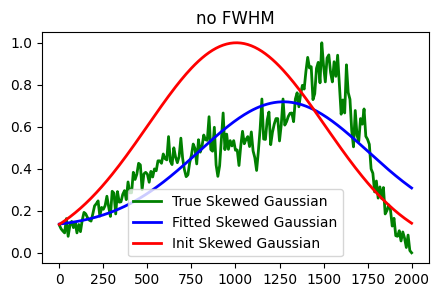

 85%|█████████████████████████████████████████████████████████████████████████████████████▌               | 5302/6255 [01:25<00:15, 63.36it/s]

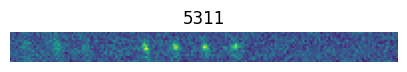

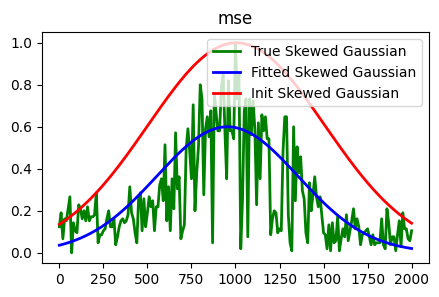

 87%|██████████████████████████████████████████████████████████████████████████████████████▉             | 5438/6255 [01:26<00:06, 117.54it/s]

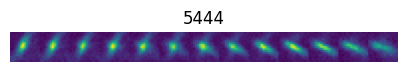

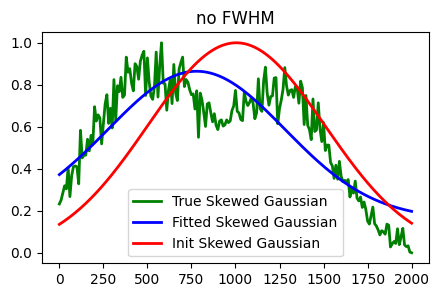

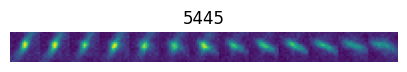

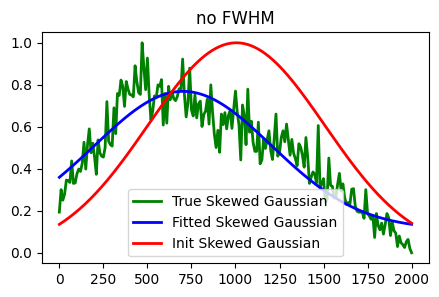

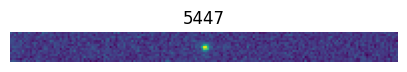

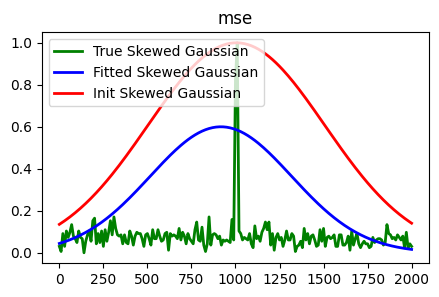

 87%|████████████████████████████████████████████████████████████████████████████████████████             | 5451/6255 [01:27<00:17, 46.11it/s]

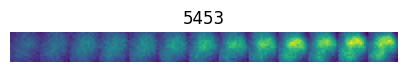

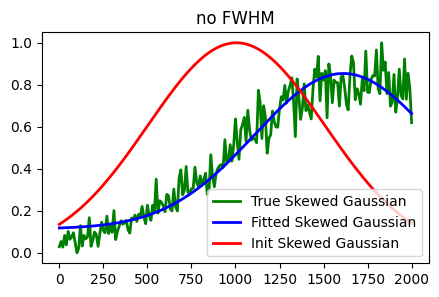

 88%|████████████████████████████████████████████████████████████████████████████████████████▍            | 5477/6255 [01:27<00:12, 59.88it/s]

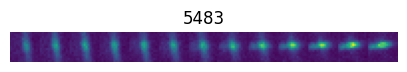

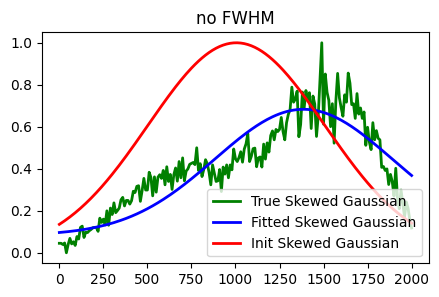

 88%|████████████████████████████████████████████████████████████████████████████████████████▌            | 5487/6255 [01:28<00:14, 52.24it/s]

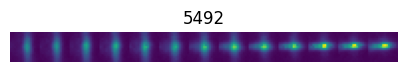

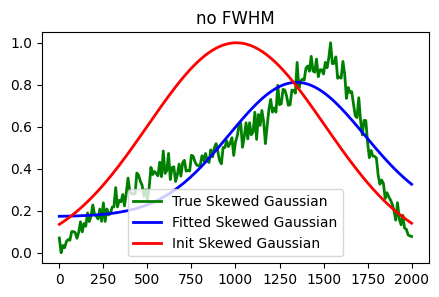

 88%|█████████████████████████████████████████████████████████████████████████████████████████▏           | 5524/6255 [01:28<00:09, 74.91it/s]

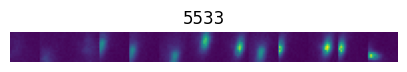

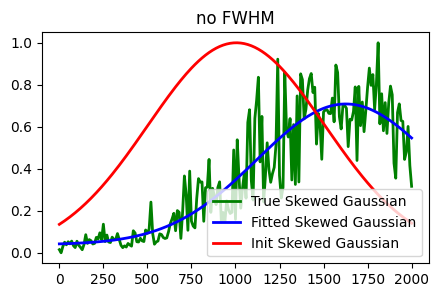

 90%|█████████████████████████████████████████████████████████████████████████████████████████▌          | 5602/6255 [01:29<00:06, 102.66it/s]

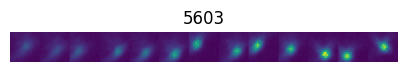

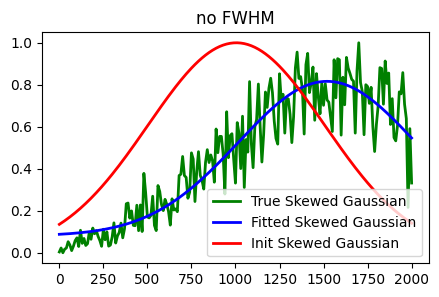

 90%|██████████████████████████████████████████████████████████████████████████████████████████▋          | 5614/6255 [01:29<00:08, 72.53it/s]

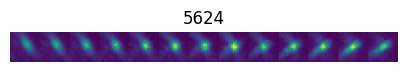

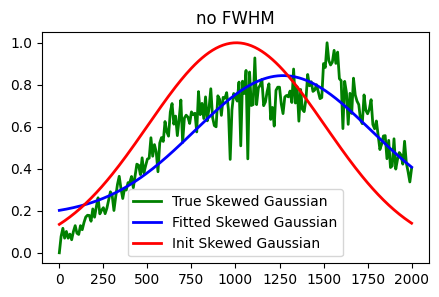

 90%|██████████████████████████████████████████████████████████████████████████████████████████▊          | 5625/6255 [01:29<00:10, 61.02it/s]

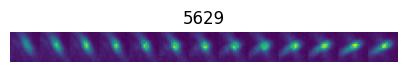

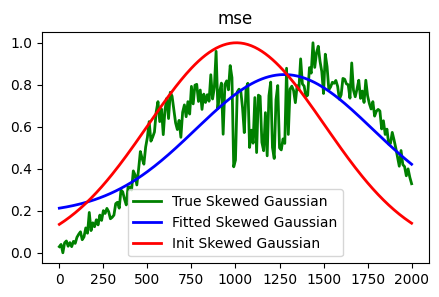

 90%|██████████████████████████████████████████████████████████████████████████████████████████▉          | 5633/6255 [01:30<00:12, 51.26it/s]

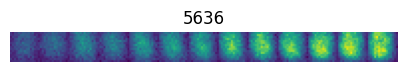

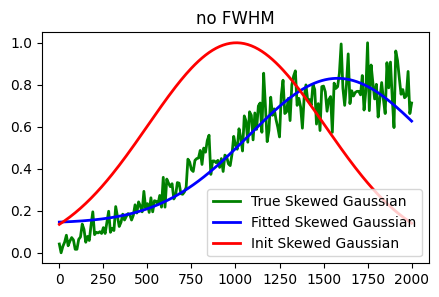

 90%|███████████████████████████████████████████████████████████████████████████████████████████▎         | 5653/6255 [01:30<00:10, 57.11it/s]

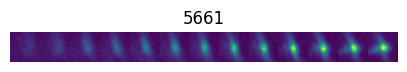

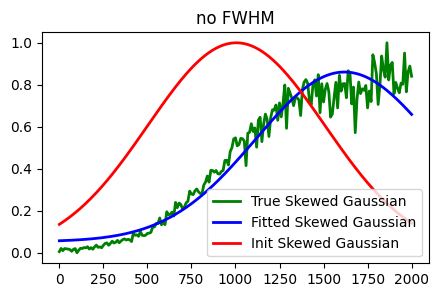

 91%|███████████████████████████████████████████████████████████████████████████████████████████▎        | 5710/6255 [01:31<00:05, 102.93it/s]

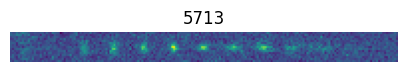

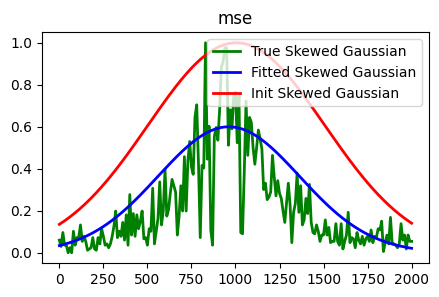

 91%|████████████████████████████████████████████████████████████████████████████████████████████▍        | 5723/6255 [01:31<00:07, 74.40it/s]

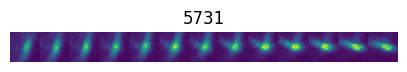

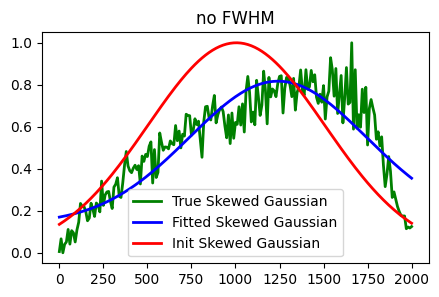

 92%|████████████████████████████████████████████████████████████████████████████████████████████▉        | 5758/6255 [01:31<00:06, 81.45it/s]

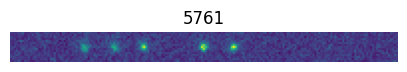

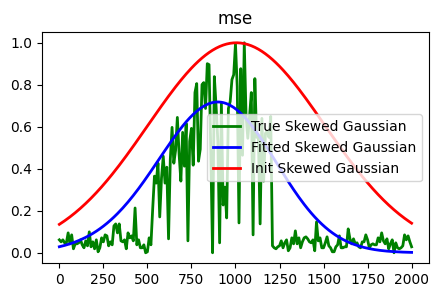

 92%|█████████████████████████████████████████████████████████████████████████████████████████████▎       | 5779/6255 [01:32<00:07, 66.97it/s]

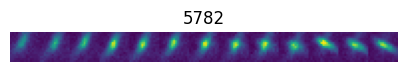

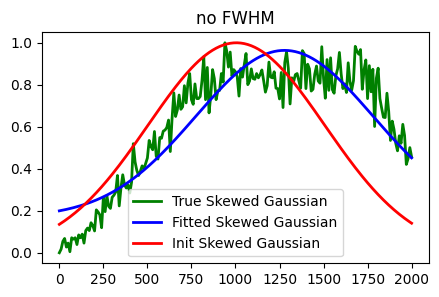

 93%|█████████████████████████████████████████████████████████████████████████████████████████████▍       | 5788/6255 [01:32<00:08, 54.44it/s]

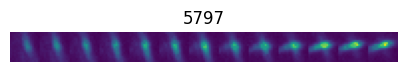

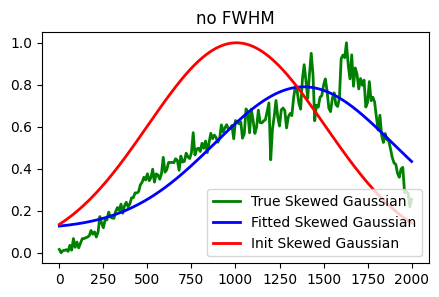

 93%|█████████████████████████████████████████████████████████████████████████████████████████████▉       | 5814/6255 [01:32<00:06, 68.27it/s]

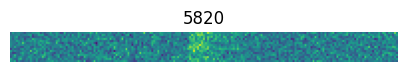

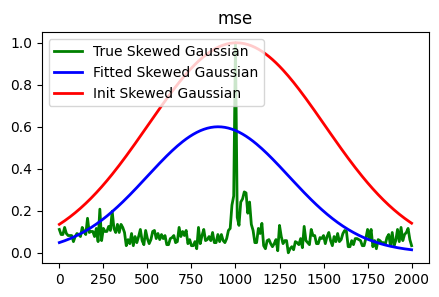

 93%|██████████████████████████████████████████████████████████████████████████████████████████████       | 5824/6255 [01:33<00:08, 52.84it/s]

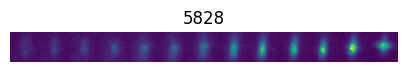

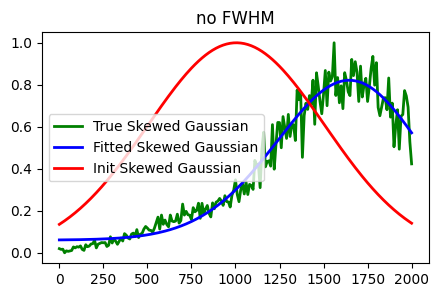

 93%|██████████████████████████████████████████████████████████████████████████████████████████████▍      | 5847/6255 [01:33<00:06, 62.98it/s]

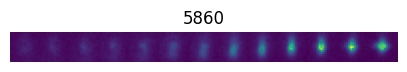

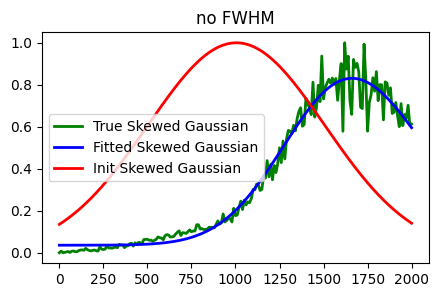

 95%|███████████████████████████████████████████████████████████████████████████████████████████████▋     | 5923/6255 [01:34<00:03, 95.73it/s]

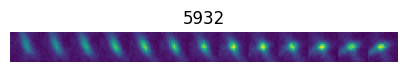

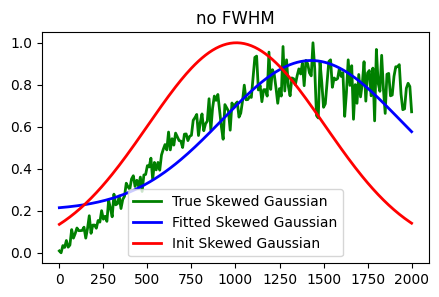

 97%|████████████████████████████████████████████████████████████████████████████████████████████████▉   | 6064/6255 [01:35<00:01, 131.97it/s]

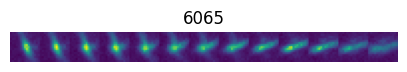

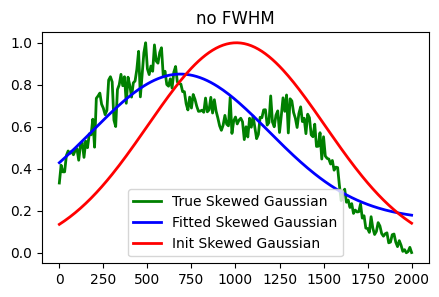

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████▏  | 6078/6255 [01:35<00:01, 91.25it/s]

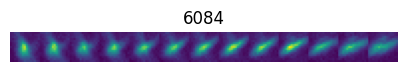

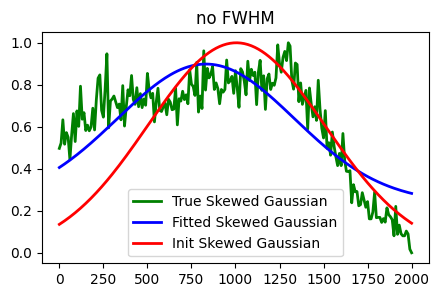

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████▋  | 6111/6255 [01:36<00:01, 80.10it/s]

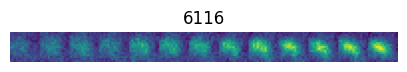

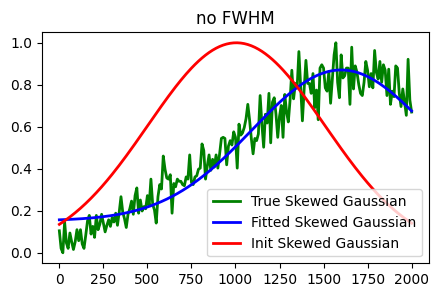

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████▊  | 6121/6255 [01:36<00:02, 63.68it/s]

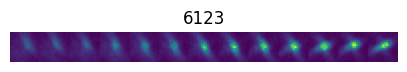

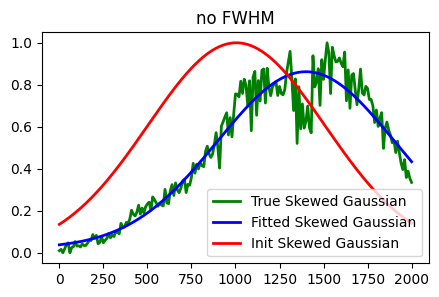

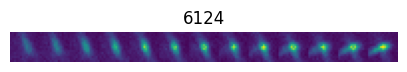

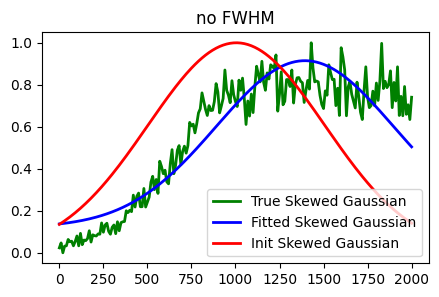

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████▉  | 6129/6255 [01:36<00:03, 41.32it/s]

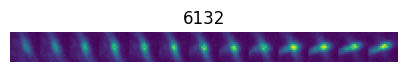

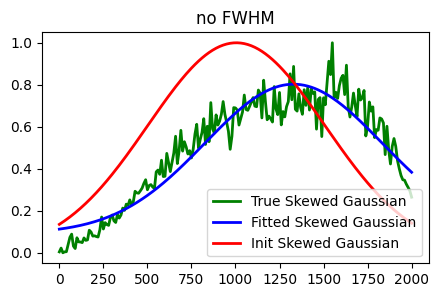

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████▎ | 6150/6255 [01:37<00:01, 53.56it/s]

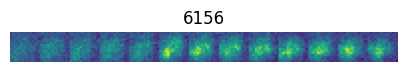

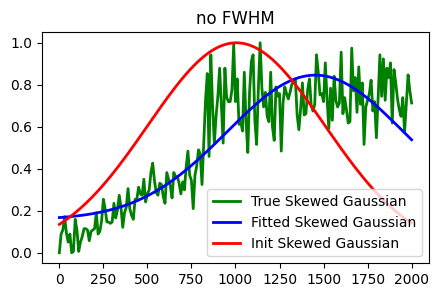

100%|███████████████████████████████████████████████████████████████████████████████████████████████████▋| 6237/6255 [01:38<00:00, 106.36it/s]

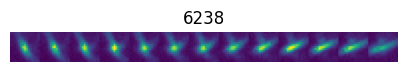

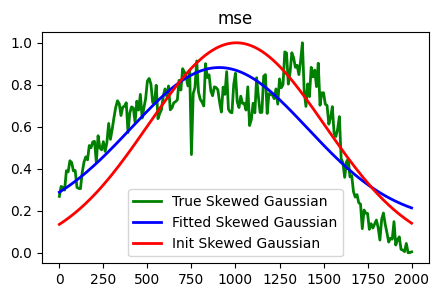

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████| 6255/6255 [01:38<00:00, 63.57it/s]


In [29]:
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt
from scipy.special import erf
from sklearn.metrics import mean_squared_error
from data.align_psfs import norm_zero_one

# Define the skewed Gaussian function
def skewed_gaussian(x, A, x0, sigma, alpha, offset):
    """
    A: Amplitude
    x0: Center
    sigma: Standard Deviation
    alpha: Skewness parameter
    offset: Vertical offset
    """
    return A * np.exp(-(x - x0)**2 / (2 * sigma**2)) * (1 + erf(alpha * (x - x0))) + offset

import numpy as np
from scipy.optimize import curve_fit, root_scalar
import matplotlib.pyplot as plt
from scipy.special import erf

# Function to find the x-value where f(x) is equal to half the amplitude
def find_half_amplitude_x(x_data, params):
    half_amplitude = params[0]/2
    x0_fit = params[1]
    half_amplitude_func = lambda x: skewed_gaussian(x, *params) - half_amplitude
    roots = []
    for bracket in [(0, x0_fit), (x0_fit, max(x_data))]:
        try:
            result = root_scalar(half_amplitude_func, bracket=bracket).root
            roots.append(result)
        except ValueError:
            pass
    return roots
    
exclude_idx = []


for i, psf in enumerate(tqdm(psfs)):
    # Fit the skewed Gaussian to the data
    x_data = np.arange(psf.shape[0]) * Z_STEP
    y_data = psf.max(axis=(1,2,3))
    y_data = norm_zero_one(y_data)
    initial_guess = [1, psf.shape[0] * Z_STEP //2, psf.shape[0] * Z_STEP/4, 0.0, 0.0]

    bounds = [
        (0.6, 1.2),
        (psf.shape[0] * Z_STEP/8, psf.shape[0] * Z_STEP),
        (psf.shape[0] * Z_STEP/5, psf.shape[0] * Z_STEP/4),
        (-np.inf, np.inf),
        (y_data.min(), np.inf)
    ]
    try:
        params, covariance = curve_fit(skewed_gaussian, x_data, y_data, p0=initial_guess, bounds=list(zip(*bounds)))
    except RuntimeError:
        print('Failed to find fit')
        params = initial_guess

    A_fit, x0_fit, sigma_fit, alpha_fit, offset_fit = params
    y_fit = skewed_gaussian(x_data, *params)

    mse = mean_squared_error(y_fit, y_data)
    title = 'included'
    if mse > 0.02:
        exclude_idx.append(i)
        title = 'mse'
    # elif x0_fit < Z_LIMIT or x0_fit > max(x_data)-Z_LIMIT:
    #     exclude_idx.append(i)
    #     title = 'not centered'
    elif len(find_half_amplitude_x(x_data, params)) != 2:
        exclude_idx.append(i)
        title = 'no FWHM'

    if i in exclude_idx:
        show_psf_axial(psf.mean(axis=-1), str(i), 10)
        plt.plot(x_data, y_data, label="True Skewed Gaussian", lw=2, color='g')
        plt.plot(x_data, y_fit, label="Fitted Skewed Gaussian", lw=2, color='b')
        plt.plot(x_data, skewed_gaussian(x_data, *initial_guess), label="Init Skewed Gaussian", lw=2, color='r')
    
        plt.title(title)
        plt.legend()
        plt.show()


In [21]:
# exclude_idx = [0, 82, 109, 114, 138, 141, 149, 153]
# exclude_idx = []
idx = [i for i in range(psfs.shape[0]) if i not in exclude_idx]
psfs = psfs[idx]
locs = locs.iloc[idx]
print(psfs.shape)

(6005, 201, 15, 15, 1)


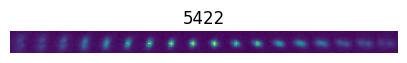

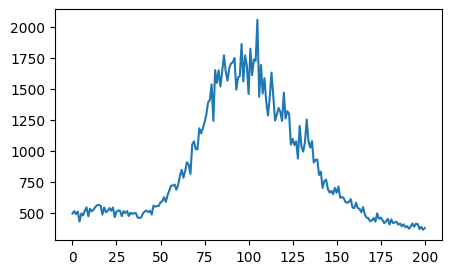

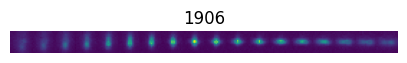

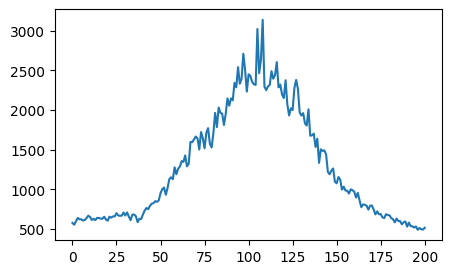

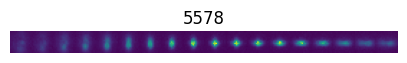

...

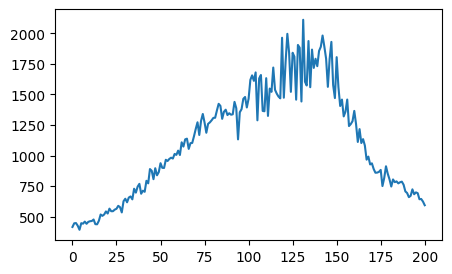

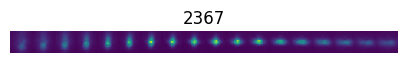

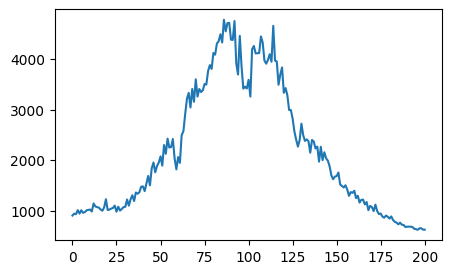

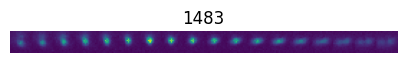

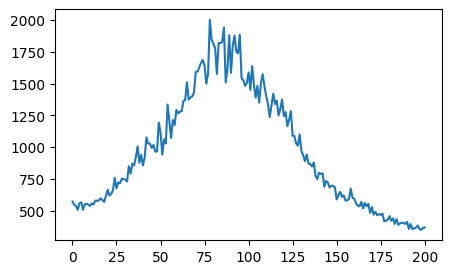

In [23]:
from data.visualise import show_psf_axial
plt.rcParams['figure.figsize'] = [5, 3]
for i in np.random.choice(np.arange(psfs.shape[0]), 20):
    psf = psfs[i]
    show_psf_axial(psf.mean(axis=-1), str(i))
    plt.plot(psf.max(axis=(1,2,3)))
    plt.show()
    


In [8]:
# Spline sharpness peak finding
from tqdm import tqdm
import numpy as np

from scipy.interpolate import UnivariateSpline
from data.align_psfs import norm_zero_one
from sklearn.metrics import mean_squared_error
from scipy import signal
import cv2
import numpy as np

plt.rcParams['figure.figsize'] = [5, 3]

DEBUG = False

UPSCALE_RATIO = 10

bad_psfs_idx = []

def denoise(img):
    from scipy.ndimage import gaussian_filter
    
    sigmas = np.array([2, 1, 1])
    return gaussian_filter(img.copy(), sigma=sigmas)

def get_sharpness(array):
    gy, gx = np.gradient(array)
    gnorm = np.sqrt(gx**2 + gy**2)
    sharpness = np.average(gnorm)
    return sharpness

def reduce_img(psf):
    return np.stack([get_sharpness(x) for x in psf])
#     return psf.max(axis=(1,2))

def find_peak(i, psf):
    if psf.ndim == 4:
        psf = psf.mean(axis=-1)
    x = np.arange(psf.shape[0]) * Z_STEP
    psf = denoise(psf)
    
    inten = norm_zero_one(reduce_img(psf))

    cs = UnivariateSpline(x, inten, k=3, s=0.2)

    x_ups = np.linspace(0, psf.shape[0], len(x) * UPSCALE_RATIO) * Z_STEP

    peak_xups = x_ups[np.argmax(cs(x_ups))] 

    fit = cs(x_ups)
    
    peak = max(fit)
    low = min(fit)
    half_max = (peak - low) / 2
    
    peak_idx = np.argmax(fit)
    center_x = len(x_ups) / 2
    
    half_max_crossings = np.where(np.diff(np.sign(fit-half_max)))[0]
    if len(half_max_crossings) < 2:
        bad_psfs_idx.append(i)
        # show_psf_axial(psf)
        # plt.plot(x-peak, inten, label='raw')
        # plt.plot(x_ups-peak, cs(x_ups), label='fit')
        # plt.legend()
        # plt.show()
    
    if DEBUG:
        show_psf_axial(psf)
        plt.plot(x-peak, inten, label='raw')
        plt.plot(x_ups-peak, cs(x_ups), label='fit')
        plt.legend()
        plt.show()
    return peak_xups

offsets = np.array([find_peak(i, psf) for i, psf in tqdm(enumerate(psfs))])

good_idx = [i for i in range(len(psfs)) if i not in bad_psfs_idx]

offsets = offsets[good_idx]
psfs = psfs[good_idx]
locs = locs.iloc[good_idx]


6173it [01:01, 99.97it/s] 


In [9]:
psfs.shape

(6142, 201, 15, 15, 1)

In [ ]:
from data.visualise import show_psf_axial
plt.rcParams['figure.figsize'] = [5, 3]
for i, psf in enumerate(psfs[0:200]):
    show_psf_axial(psf.mean(axis=-1), str(i))
    plt.plot(psf.max(axis=(1,2,3)))
    plt.show()


In [ ]:

ys = []
for i, offset in enumerate(offsets):
    zs = ((np.arange(psfs.shape[1])) * Z_STEP) -offset
    ys.append(zs)

ys = np.array(ys)


In [ ]:
# plt.rcParams['figure.figsize'] = [10, 2]
# for psf, y in zip(psfs[0:10], ys):
#     plt.plot(y, psf.max(axis=(1,2,3)))
#     plt.show()

In [ ]:
# Stratify according to area of FOV

from sklearn.preprocessing import KBinsDiscretizer
def cart2pol(xy):
    x, y = xy
    rho = np.sqrt(x**2 + y**2)
    phi = np.arctan2(y, x)
    return(rho, phi)

center = locs[['x', 'y']].mean().to_numpy()
coords = locs[['x', 'y']].to_numpy() - center

polar_coords = np.stack([cart2pol(xy) for xy in coords])

discretizer = KBinsDiscretizer(n_bins=6, encode='ordinal')
groups = discretizer.fit_transform(polar_coords[:, 1:2]).astype(str)

center_radius = 50
idx = np.argwhere(polar_coords[:, 0] <= center_radius).squeeze()
groups[idx] = -1

groups[:] = 0
locs['group'] = groups


# sns.scatterplot(data=locs, x='x', y='y', hue='group')


In [ ]:
# Withold some PSFs for evaluation

from sklearn.model_selection import train_test_split

SEED = 42

idx = np.arange(psfs.shape[0])

train_idx, test_idx = train_test_split(idx, train_size=0.9, random_state=SEED, stratify=locs['group'])

_train_val_psfs = psfs[train_idx]
test_psfs = psfs[test_idx]

_train_val_ys = ys[train_idx]
test_ys = ys[test_idx]

train_fov_groups = locs['group'].to_numpy()[train_idx]

train_val_coords = locs[['x', 'y']].to_numpy()[train_idx]
test_coords = locs[['x', 'y']].to_numpy()[test_idx]

ds_cls = np.zeros((psfs.shape[0]), dtype=object)
ds_cls[train_idx] = 'train/val'
ds_cls[test_idx] = 'test'
locs['ds'] = ds_cls
plt.rcParams['figure.figsize'] = [5, 5]

# sns.scatterplot(data=locs, x='x', y='y', hue='ds')
# plt.show()

In [ ]:

groups = np.repeat(np.arange(len(train_idx))[:, np.newaxis], psfs.shape[1], axis=1).flatten()

coords = np.repeat(train_val_coords[:, :, np.newaxis], psfs.shape[1], axis=0)

train_val_psfs = np.concatenate(_train_val_psfs)
train_val_ys = np.concatenate(_train_val_ys)
split_idx = np.arange(train_val_psfs.shape[0])

train_idx, val_idx = train_test_split(split_idx, train_size=0.9, random_state=SEED, stratify=groups)

train_psfs = train_val_psfs[train_idx]
train_ys = train_val_ys[train_idx][:, np.newaxis]

val_psfs = train_val_psfs[val_idx]
val_ys = train_val_ys[val_idx][:, np.newaxis]

val_coords = coords[val_idx].squeeze()
train_coords = coords[train_idx].squeeze()



In [ ]:
# print(train_psfs.shape, train_ys.shape, _train_groups.shape)
# print(val_psfs.shape, val_ys.shape, _val_groups.shape)


In [ ]:
# from sklearn.preprocessing import OneHotEncoder

# encoder = OneHotEncoder().fit(_train_groups)

# train_groups = encoder.transform(_train_groups).toarray()
# val_groups = encoder.transform(_val_groups).toarray()

# print(train_psfs.shape, train_ys.shape, train_groups.shape)
# print(val_psfs.shape, val_ys.shape, val_groups.shape)


In [ ]:
# Trim stacks

def filter_z_range(X, zs):
    psfs, groups = X
    valid_ids = np.argwhere(abs(zs.squeeze()) < Z_RANGE).squeeze()
    return [psfs[valid_ids], groups[valid_ids]], zs[valid_ids]
    
X_train, y_train = filter_z_range((train_psfs, train_coords), train_ys)

X_val, y_val = filter_z_range((val_psfs, val_coords), val_ys)


In [ ]:
# data augmentation


from tensorflow.keras import layers, Sequential
from data.visualise import grid_psfs

def aug_dataset(X_train, y_train):
    AUG_RATIO = 2
    MAX_TRANSLATION_PX = 2
    MAX_GAUSS_NOISE = 0.005
    img_size = X_train[0].shape[1]

    aug_pipeline = Sequential([
        layers.GaussianNoise(stddev=MAX_GAUSS_NOISE*X_train[0].max(), seed=SEED),
        layers.RandomTranslation(MAX_TRANSLATION_PX/img_size, MAX_TRANSLATION_PX/img_size, seed=SEED),
        layers.RandomBrightness(0.2, [X_train[0].min(), X_train[0].max()], seed=SEED),
    ])

    idx = np.random.randint(0, X_train[0].shape[0], size=int(AUG_RATIO*X_train[0].shape[0]))

    aug_psfs = aug_pipeline(X_train[0][idx].copy(), training=True).numpy()
    aug_coords = X_train[1][idx]

    aug_z = y_train[idx]

    subset_psfs = np.concatenate((aug_psfs[0:100], X_train[0][idx][0:100]))
    plt.imshow(grid_psfs(subset_psfs.mean(axis=-1)))
    plt.show()

    train_psfs = np.concatenate([aug_psfs, X_train[0]])
    train_coords = np.concatenate([aug_coords, X_train[1]])
    train_zs = np.concatenate([aug_z, y_train])

    X_train = [train_psfs, train_coords]
    y_train = train_zs
    del aug_pipeline
    return X_train, y_train

# X_train[0] = X_train[0].astype(float)
# print(X_train[0].shape, X_train[0].min(), X_train[0].max(), X_train[0].mean())
# X_train, y_train = aug_dataset(X_train, y_train)
# print(X_train[0].shape, X_train[0].min(), X_train[0].max(), X_train[0].mean())

# X_train[0] = X_train[0].astype(np.uint16)

In [ ]:
import gc
gc.collect()

In [ ]:
print(X_train[0].shape, X_train[1].shape, y_train.shape)
print(X_val[0].shape, X_val[1].shape, y_val.shape)


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(
    rescale=1.0/65336.0,
    samplewise_center=False,
    samplewise_std_normalization=False,
    featurewise_center=True,
    featurewise_std_normalization=True,
    horizontal_flip=False)

print('Fitting datagen...')
# compute quantities required for featurewise normalization
# (std, mean, and principal components if ZCA whitening is applied)
datagen.fit(X_train[0])
print('Fitted')

X_train_preproc = [X_train[0].copy(), X_train[1].copy()]
X_val_preproc = [X_val[0].copy(), X_val[1].copy()]

X_train_preproc[0] = datagen.standardize(X_train_preproc[0].astype(float))
X_val_preproc[0] = datagen.standardize(X_val_preproc[0].astype(float))

# preprocessors = {
#     'psfs': datagen,
#     'coords': coords_scaler
# }

# import pickle
# with open('./scalers.p', 'wb') as f:
#     pickle.dump(preprocessors, f)

In [ ]:
test_psfs = psfs[test_idx]

test_ys = ys[test_idx]


test_groups = np.repeat(np.arange(len(test_psfs))[:, np.newaxis], test_psfs.shape[1], axis=1)
test_groups = np.concatenate(test_groups)

test_coords = np.repeat(test_coords[:, :, np.newaxis], test_psfs.shape[1], axis=0).squeeze()

test_psfs = np.concatenate(test_psfs)


test_ys = np.concatenate(test_ys)[:, np.newaxis]


def filter_z_range(X, zs):
    psfs, groups = X
    valid_ids = np.argwhere(abs(zs.squeeze()) < Z_RANGE).squeeze()
    return [psfs[valid_ids], groups[valid_ids]], zs[valid_ids]


X_test, y_test = filter_z_range((test_psfs, test_coords), test_ys)

test_groups = X_test[1].copy()


X_test_preproc = [X_test[0].copy(), X_test[1].copy()]
X_test_preproc[0] = datagen.standardize(X_test_preproc[0].astype(float))



In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_preproc[1] = scaler.fit_transform(X_train_preproc[1])
X_val_preproc[1] = scaler.transform(X_val_preproc[1])
X_test_preproc[1] = scaler.transform(X_test_preproc[1])

In [ ]:
print(X_train_preproc[0].min(), X_train_preproc[0].max())
print(X_val_preproc[0].min(), X_val_preproc[0].max())
print(X_test_preproc[0].min(), X_test_preproc[0].max())

print(X_train_preproc[1].min(), X_train_preproc[1].max())
print(X_val_preproc[1].min(), X_val_preproc[1].max())
print(X_test_preproc[1].min(), X_test_preproc[1].max())

print(X_train_preproc[0].shape, X_train_preproc[1].shape)
print(X_val_preproc[0].shape, X_val_preproc[1].shape)
print(X_test_preproc[0].shape, X_test_preproc[1].shape)

In [ ]:
# train_idx = np.argwhere(abs(y_train.squeeze()) < 50).squeeze()
# tmp_psfs = X_train_preproc[0][train_idx].mean(axis=-1)
# print(tmp_psfs.shape)
# plt.rcParams['figure.figsize'] = [10, 10]
# plt.imshow(grid_psfs(tmp_psfs))
# plt.show()

In [ ]:
import tensorflow as tf

def get_dataset(images, coords, labels):
    img_ds = tf.data.Dataset.from_tensor_slices(X_train_preproc[0])
    coords_ds = tf.data.Dataset.from_tensor_slices(X_train_preproc[1])
    labels_ds = tf.data.Dataset.from_tensor_slices(y_train)

    x_ds = tf.data.Dataset.zip(img_ds, coords_ds)
    ds = tf.data.Dataset.zip(x_ds, labels_ds)
    print(ds.element_spec)
    return ds

train_data = get_dataset(*X_train_preproc, y_train)
val_data = get_dataset(*X_val_preproc, y_val)
test_data = get_dataset(*X_test_preproc, y_test)

In [ ]:

def apply_rescaling(x, y):
    x = [x[0], x[1]]
    x[0] = img_preprocessing(x[0])
    return tuple(x), y


train_data = train_data.map(lambda x, y: apply_rescaling(x, y), num_parallel_calls=tf.data.AUTOTUNE)
train_data = train_data.cache('cache').prefetch(tf.data.AUTOTUNE)

val_data = val_data.map(lambda x, y: apply_rescaling(x, y), num_parallel_calls=tf.data.AUTOTUNE)
val_data = val_data.cache('cache2').prefetch(tf.data.AUTOTUNE)

test_data = test_data.map(lambda x, y: apply_rescaling(x, y), num_parallel_calls=tf.data.AUTOTUNE)
test_data = test_data.cache('cache2').prefetch(tf.data.AUTOTUNE)

In [ ]:
X_test_preproc[0].shape

In [ ]:
for x in test_data:
    print(x[0][0].shape)

In [ ]:
z_pred = model.predict(test_data, steps=3, batch_size=batch_size)
z_pred.shape

In [ ]:
 # Vision transformer training

from tensorflow import keras
from tensorflow.keras import layers, Sequential
from tensorflow.keras import optimizers
from keras.callbacks import ReduceLROnPlateau, EarlyStopping
from tqdm.keras import TqdmCallback
from tensorflow.keras import regularizers
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Flatten, Dropout, LayerNormalization, Resizing, Lambda
from tensorflow.keras.models import Model
from vit_keras import vit

# Assuming your input images have size (image_size, image_size, num_channels)
image_size = X_train_preproc[0].shape[1]
num_channels = X_train_preproc[0].shape[-1]
num_classes = 1  # Regression task, predicting a single continuous value

# Create the Vision Transformer model using the vit_keras library
img_input = Input(shape=(image_size, image_size, num_channels))

img_preprocessing = Sequential([
    Resizing(128, 128),
    Lambda(tf.image.grayscale_to_rgb)
])

img = img_preprocessing(img_input)

vit_model = vit.vit_b16(image_size=128, 
                        activation='sigmoid',
                        pretrained=True,
                        include_top=False,
                        pretrained_top=False)

x = vit_model(img)

coords_input = layers.Input(X_train_preproc[1][0].shape)
x_coords = layers.Dense(64)(coords_input)

x_coords = layers.Dense(64)(x_coords)



# Add additional layers for regression prediction
x = Flatten()(x)
x = tf.concat([x, x_coords], axis=-1)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(64, activation='relu')(x)
x = Dropout(0.5)(x)
regression_output = Dense(num_classes, activation='linear')(x)  # Linear activation for regression

# Combine the Vision Transformer backbone with the regression head
model = Model(inputs=[img_input, coords_input], outputs=regression_output)

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mae'])


batch_size = 64
epochs = 5000
lr = 0.0001

# # Model refining
# model = keras.models.load_model('./latest_vit_model/')
    
# n_layers = len(model.layers)
# for i in range(0, len(model.layers)-4):
#     model.layers[i].trainable = False
# assert model.trainable == True

    
# # Print a summary of the model architecture
# model.summary()


model.compile(loss='mean_squared_error', optimizer=optimizers.AdamW(learning_rate=lr), metrics=['mean_absolute_error'])

callbacks = [
    ReduceLROnPlateau(monitor='val_mean_absolute_error', factor=0.1,
                      patience=50, verbose=True, mode='min', min_delta=5, min_lr=1e-6,),
    EarlyStopping(monitor='val_mean_absolute_error', patience=75,
                  verbose=False, min_delta=1, restore_best_weights=True),
    TqdmCallback(verbose=1),
]


history = model.fit(train_data, batch_size=batch_size, epochs=epochs, validation_data=val_data, callbacks=callbacks, shuffle=True, verbose=True)


In [ ]:
# Prev aug settings
# AUG_RATIO = 5
# MAX_TRANSLATION_PX = 2
# MAX_GAUSS_NOISE = 0.001

In [ ]:
# model.save('./latest_vit_model2')

In [ ]:
#     AUG_RATIO = 1
#     MAX_TRANSLATION_PX = 2
#     MAX_GAUSS_NOISE = 0.001
#     img_size = X_train[0].shape[1]

#     aug_pipeline = Sequential([
#         layers.GaussianNoise(stddev=MAX_GAUSS_NOISE*X_train[0].max(), seed=SEED),
#         layers.RandomTranslation(MAX_TRANSLATION_PX/img_size, MAX_TRANSLATION_PX/img_size, seed=SEED),
#         layers.RandomBrightness(0.2, [X_train[0].min(), X_train[0].max()], seed=SEED)
#     ])


# Peak illumination
# Un-filtered spline alignment
# 446/446 [==============================] - 19s 39ms/step
# train 46.027
# 16/16 [==============================] - 1s 39ms/step
# val 52.553
# 19/19 [==============================] - 1s 42ms/step
# test 78.961 w/o, 44nm with bias removal
# Mean test offset: 67.992

# Denoised spline alignment (gaussian kernel 2, 1, 1)
# 446/446 [==============================] - 18s 37ms/step
# train 43.796
# 16/16 [==============================] - 1s 36ms/step
# val 46.722
# 19/19 [==============================] - 1s 37ms/step
# test 73.313 w/o bias removal, 36nm with bias removal
# mean test offset: 62
 




In [ ]:
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = [5, 5]
fig, ax1 = plt.subplots()
ax1.plot(history.history['mean_absolute_error'], label='mse')
ax1.plot(history.history['val_mean_absolute_error'], label='val_mse')
ax1.set_ylim([0, 500])
ax1.legend(loc=1)
ax2 = ax1.twinx()
ax2.plot(history.history['lr'], label='lr', color='red')
ax2.legend(loc=0)


In [ ]:
!realpath ./latest_vit_model/

In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
import tensorflow as tf
train_data = tf.data.Dataset.load('train_data')
val_data = tf.data.Dataset.load('val_data')
test_data = tf.data.Dataset.load('test_data')

2023-10-18 10:13:00.680649: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-10-18 10:13:00.726146: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-10-18 10:13:01.449329: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2023-10-18 10:13:03.064200: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1639] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 22280 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3090, pci bus id: 0000:1d:00.0, compute cap

In [2]:
import pickle
import keras
# with open('./scalers.p', 'rb') as f:
#     preprocessors = pickle.load(f)

model = keras.models.load_model('./latest_vit_model3')

# datagen = preprocessors['psfs']
# coords_scaler = preprocessors['coords']

/home/mdb119/venv/lib/python3.11/site-packages/keras/src/layers/core/lambda_layer.py:327: UserWarning: vit_keras.vit is not loaded, but a Lambda layer uses it. It may cause errors.
  function = cls._parse_function_from_config(
/home/mdb119/venv/lib/python3.11/site-packages/keras/src/layers/core/lambda_layer.py:327: UserWarning: vit_keras.layers is not loaded, but a Lambda layer uses it. It may cause errors.
  function = cls._parse_function_from_config(


38/38 [==============================] - 30s 782ms/step


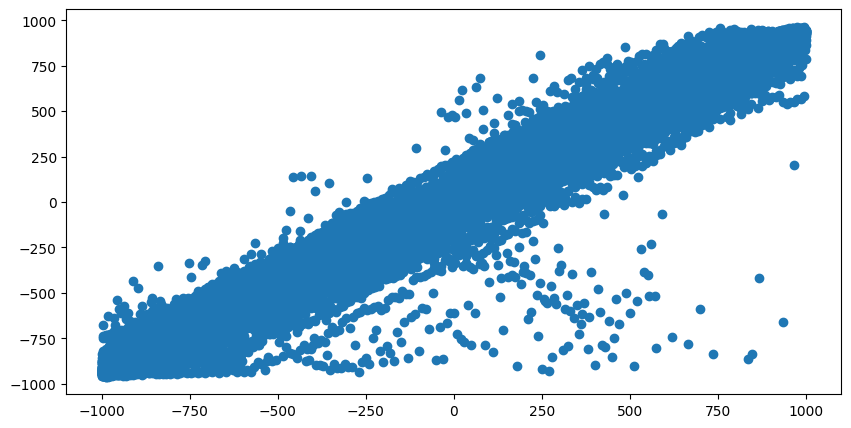

test 51.013


In [10]:
import numpy as np
from sklearn.metrics import mean_absolute_error
ds = [
    ('train', train_data), 
    ('val', val_data),
    ('test', test_data)
]
for k, dataset in ds:
    y = np.concatenate([y for x, y in dataset], axis=0)
    res = model.predict(dataset, verbose=True)
    error = mean_absolute_error(res, y)
    plt.scatter(y, res)
    plt.show()
    print(k, round(error, 3))

38/38 [==============================] - 30s 788ms/step
New bead: 0
31.557432892138547


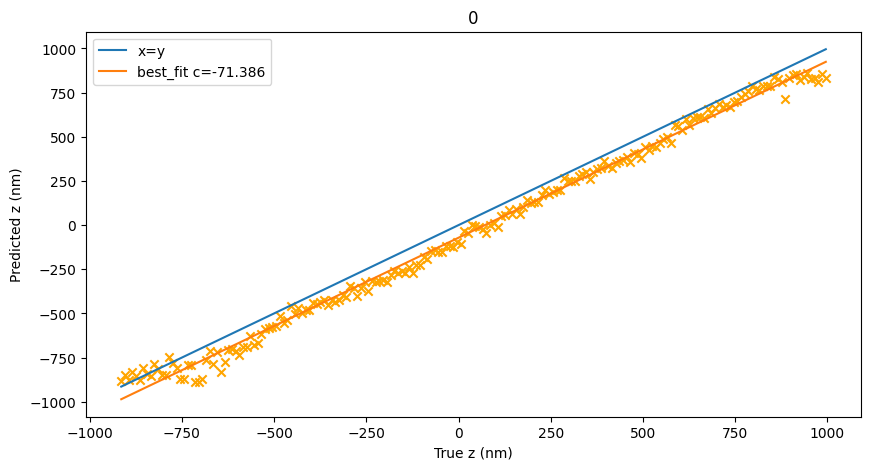

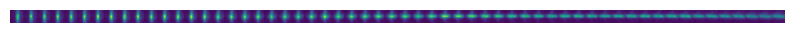

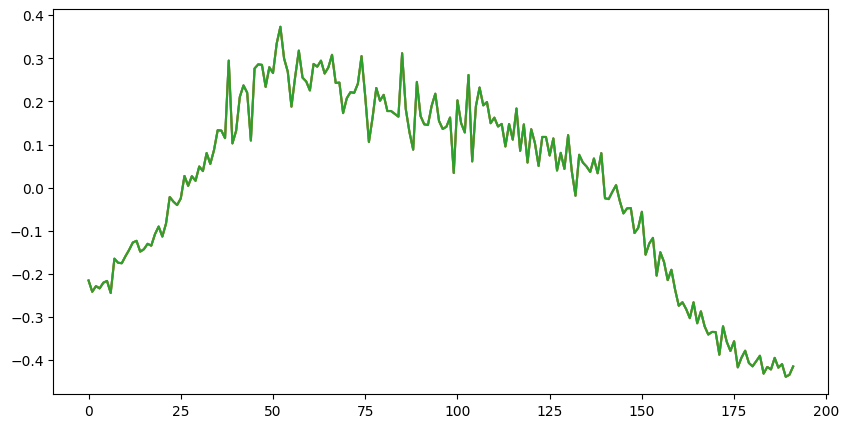

New bead: 1
New bead: 2
New bead: 3
34.313703238689286


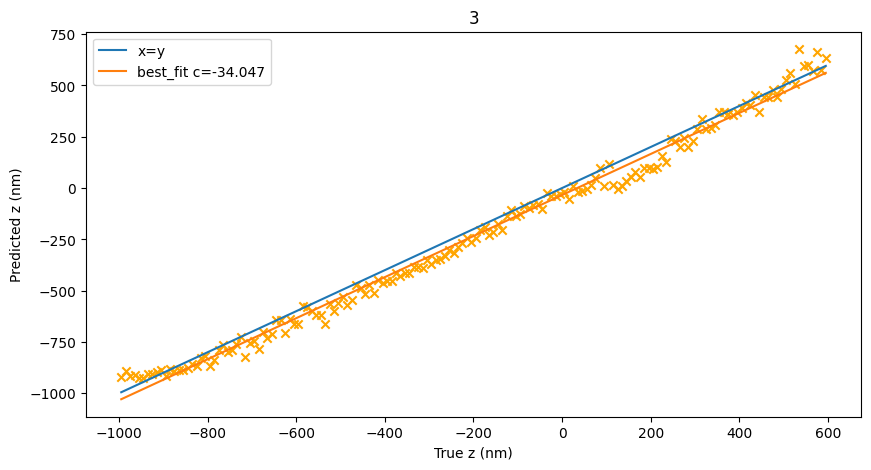

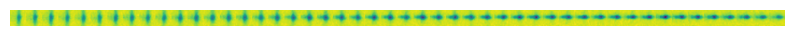

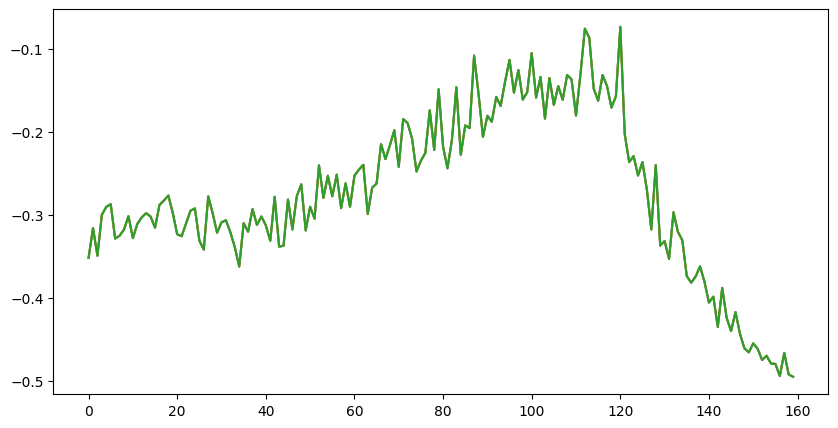

New bead: 4
New bead: 5
New bead: 6
New bead: 7
New bead: 8
New bead: 9
New bead: 10
New bead: 11
New bead: 12
New bead: 14
New bead: 15
New bead: 16
New bead: 17
New bead: 18
New bead: 19
New bead: 20
New bead: 21
53.574563506044704


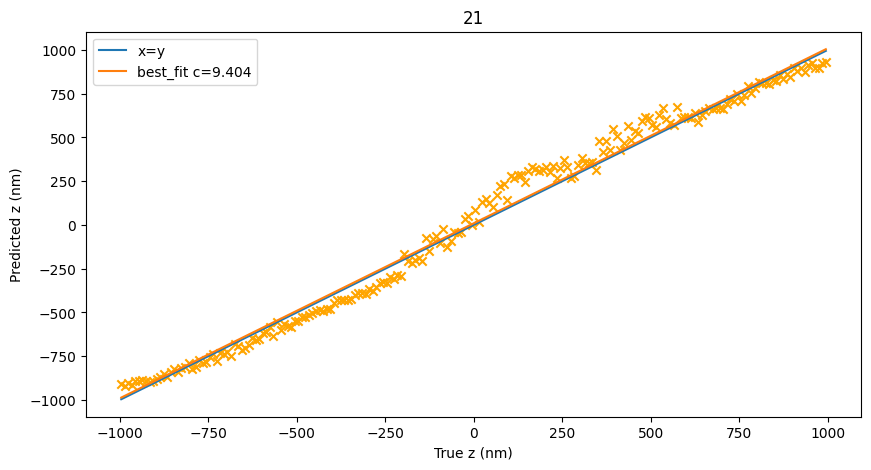

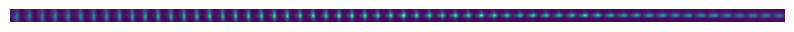

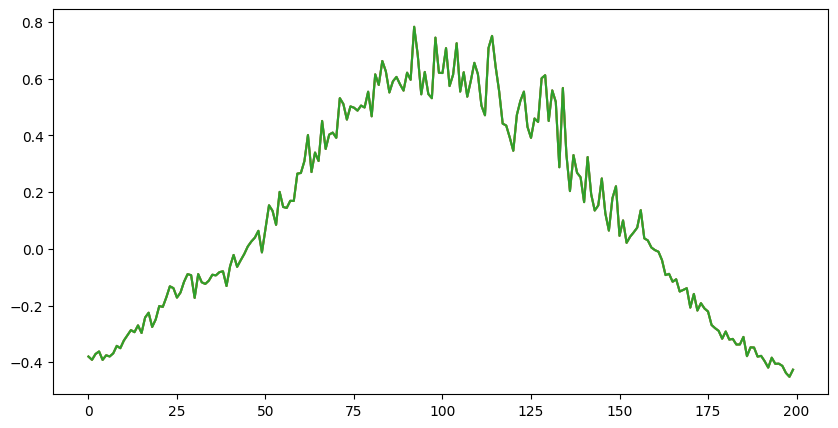

New bead: 22
31.0496103609263


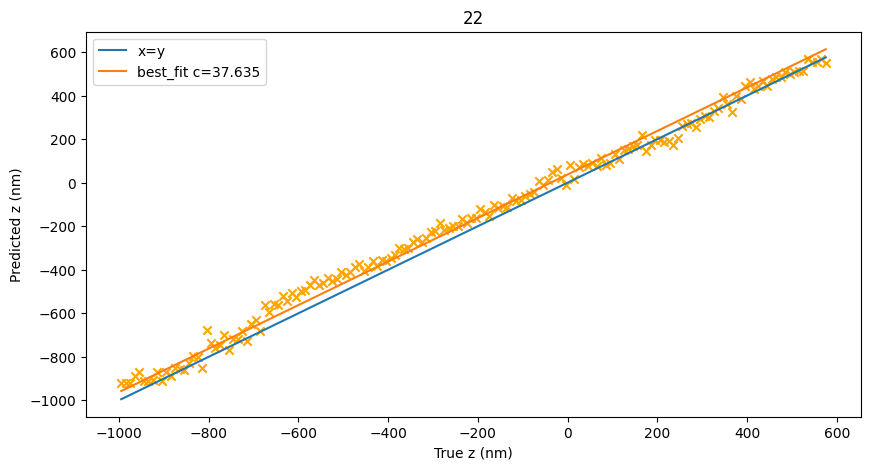

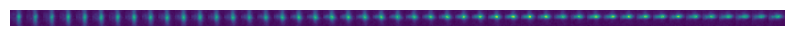

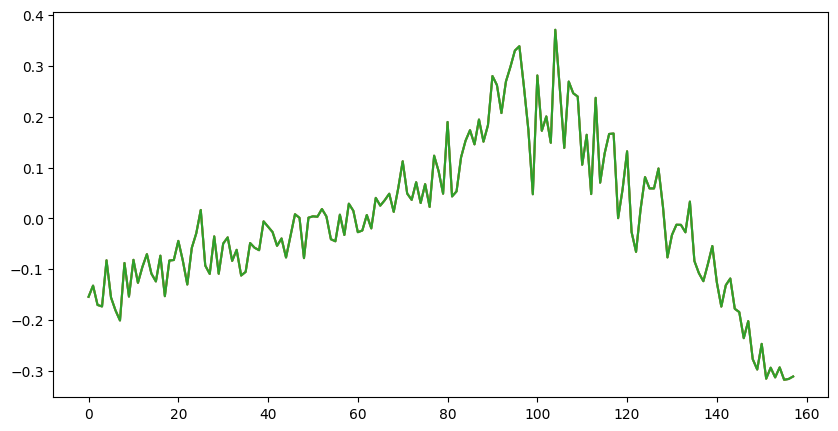

New bead: 23
New bead: 24
New bead: 25
New bead: 26
New bead: 27
New bead: 28
31.152753320776814


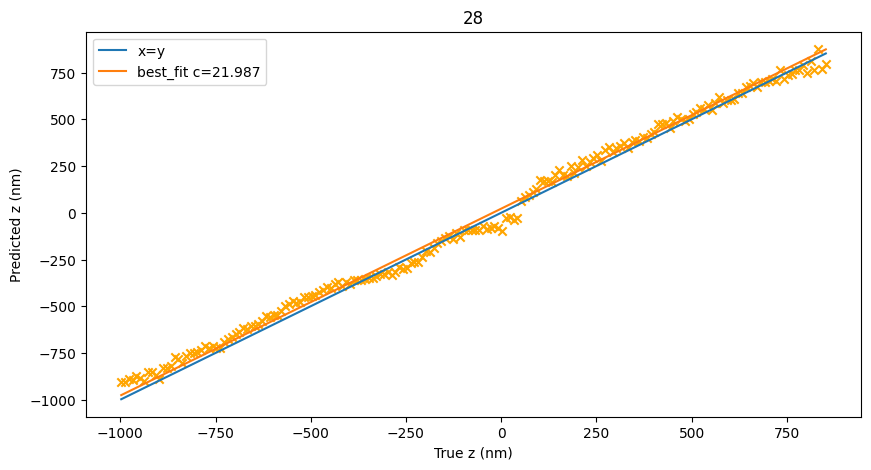

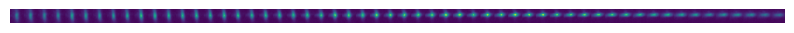

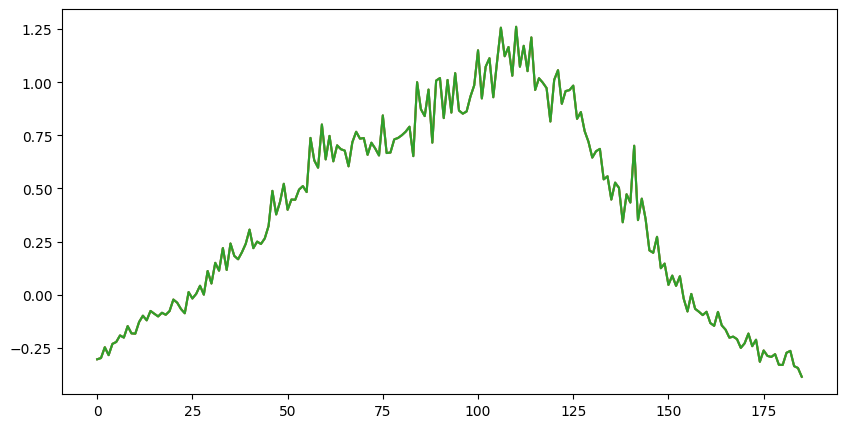

New bead: 29
New bead: 31
New bead: 32
New bead: 33
New bead: 34
New bead: 35
New bead: 36
New bead: 37
New bead: 39
New bead: 40
New bead: 41
New bead: 42
New bead: 43
New bead: 44
35.14863429073604


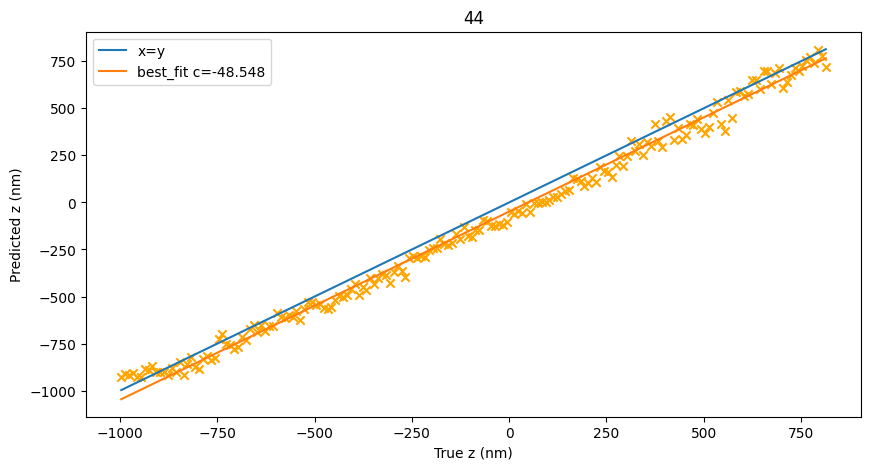

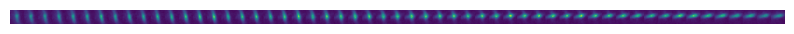

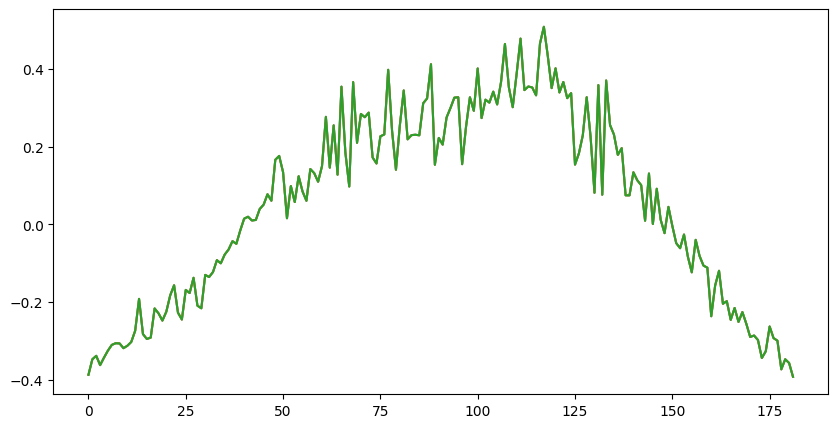

New bead: 45
New bead: 46
New bead: 47
New bead: 48
New bead: 49
New bead: 50
New bead: 51
52.658105167444155


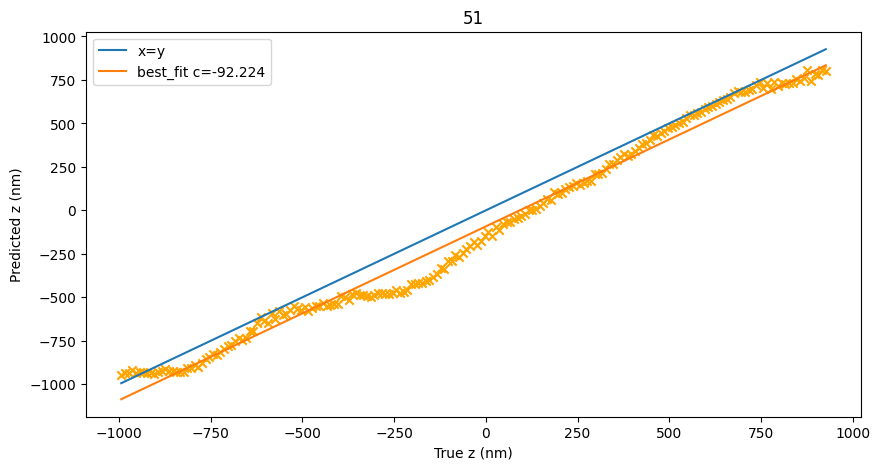

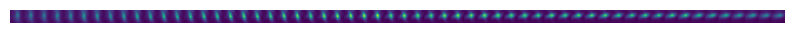

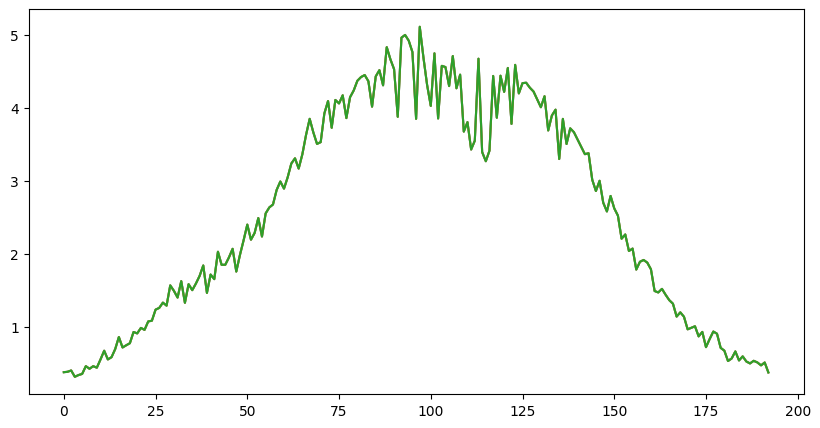

New bead: 52
New bead: 53
48.358782346531854


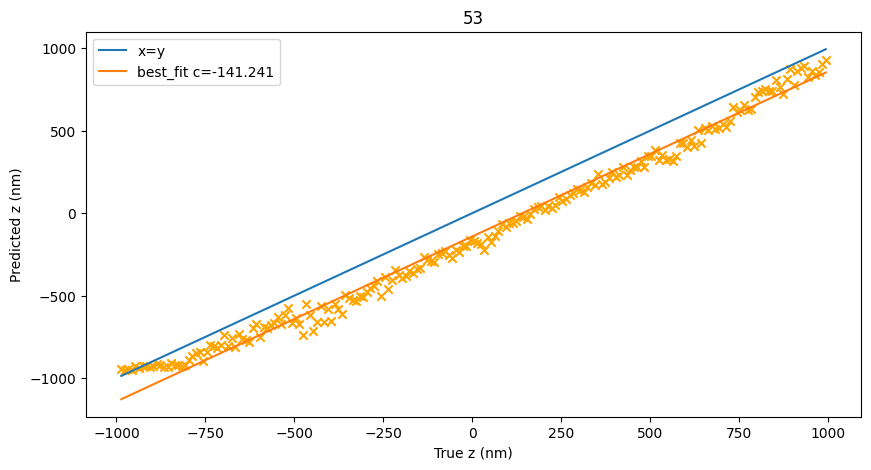

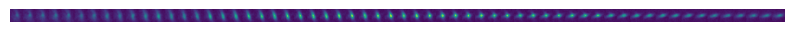

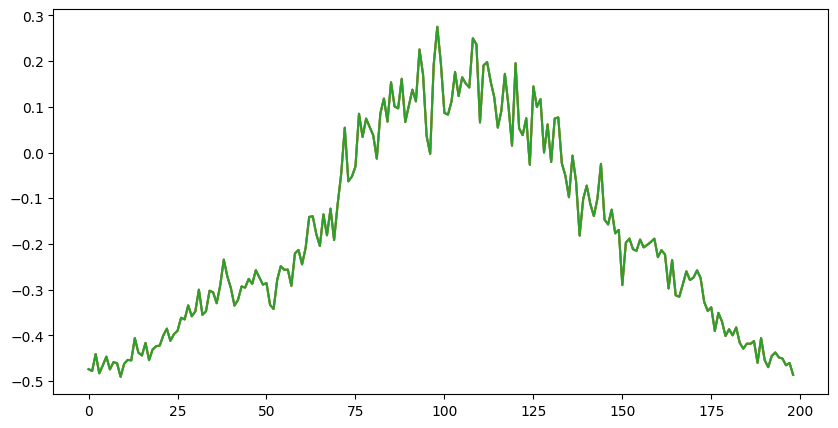

New bead: 54
New bead: 55
New bead: 56
New bead: 57
New bead: 58
New bead: 59
44.20374179758676


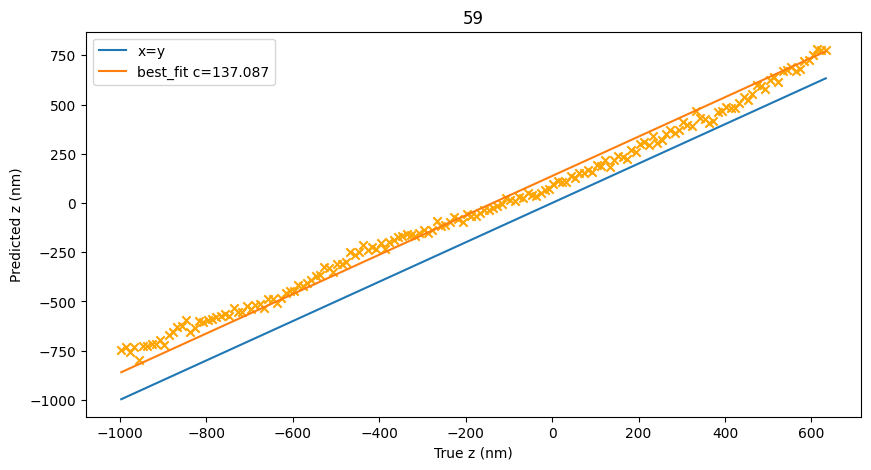

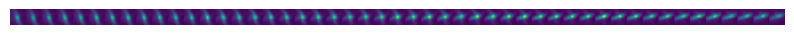

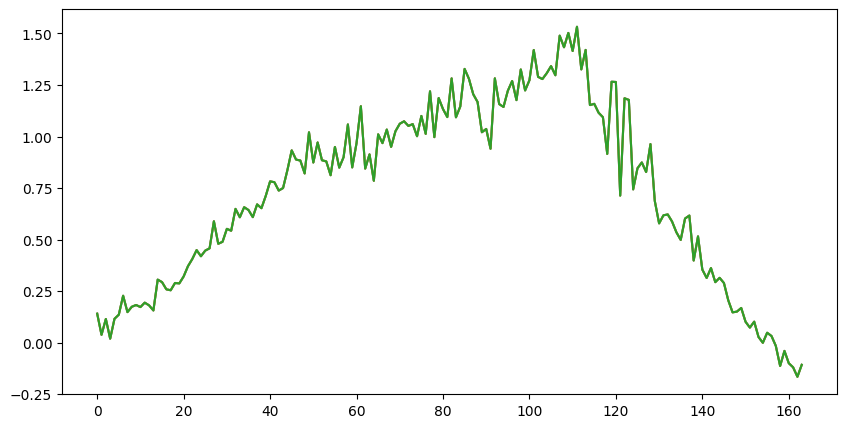

New bead: 60
New bead: 61
New bead: 62
New bead: 63
New bead: 64
New bead: 65
42.681844525610664


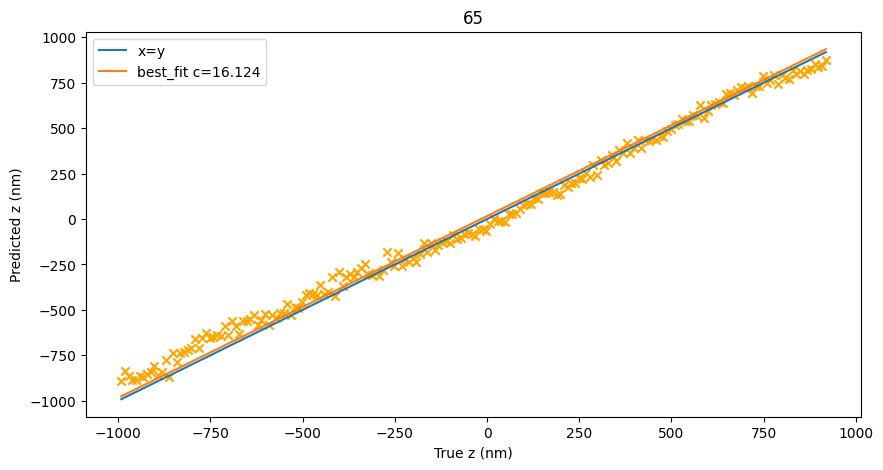

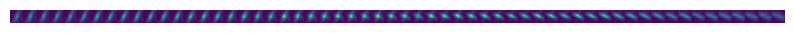

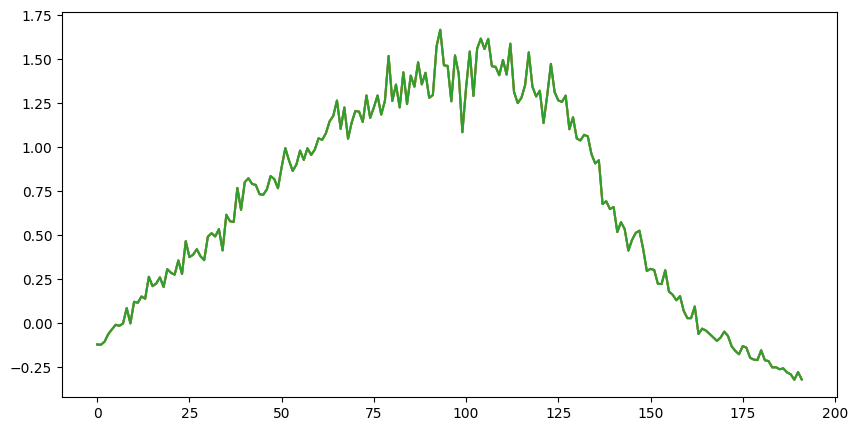

New bead: 66
New bead: 67
New bead: 68
34.52348767260845


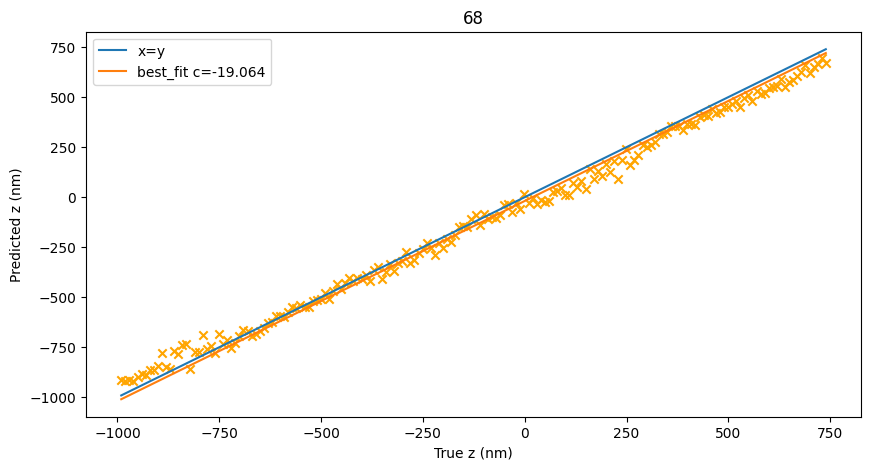

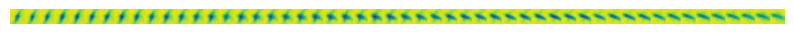

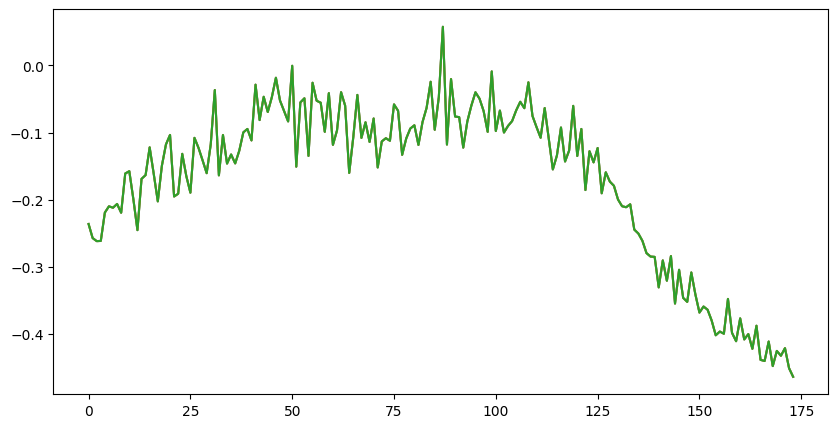

New bead: 69
New bead: 70
32.292500151607456


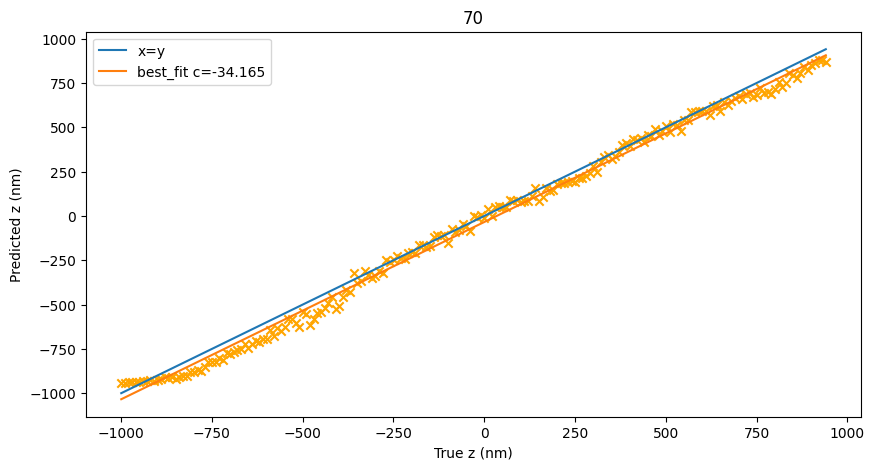

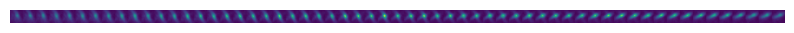

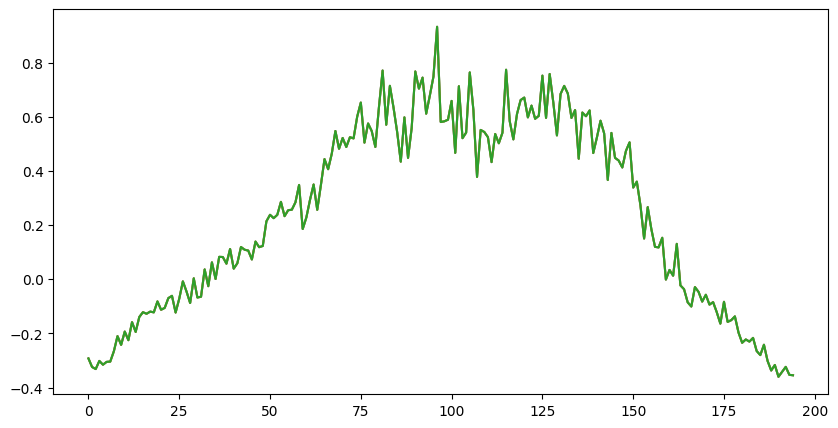

New bead: 71
New bead: 72
New bead: 73
44.33409126406101


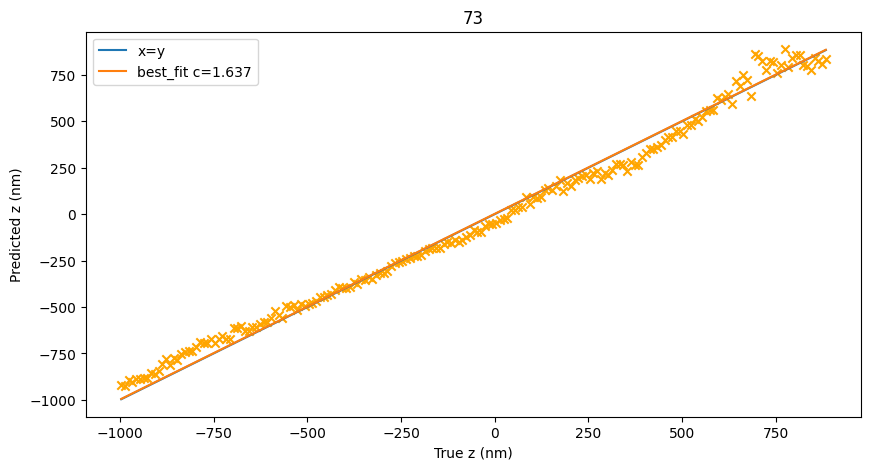

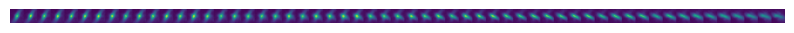

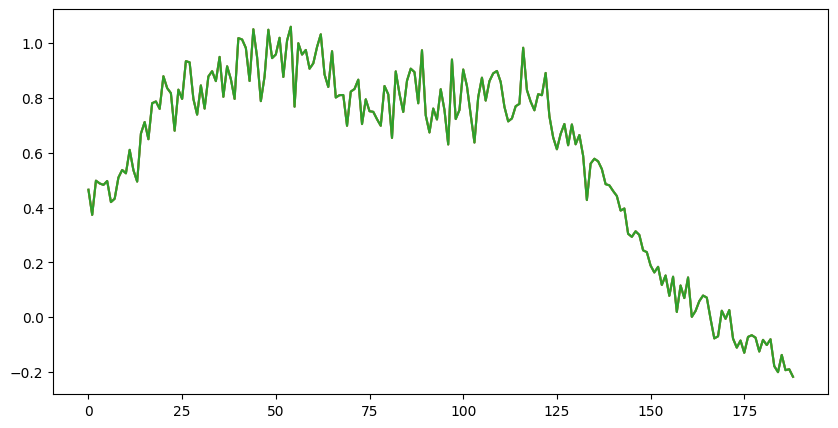

New bead: 74
New bead: 75
30.989342309007732


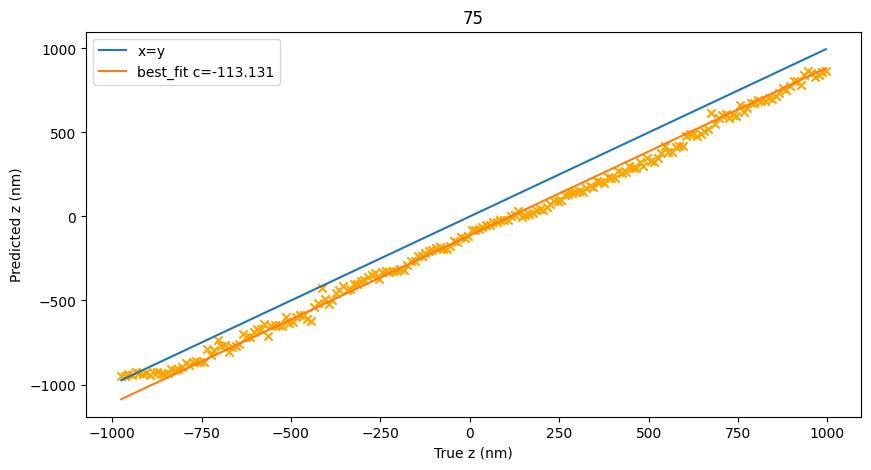

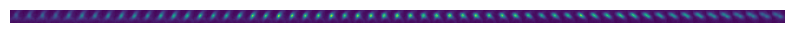

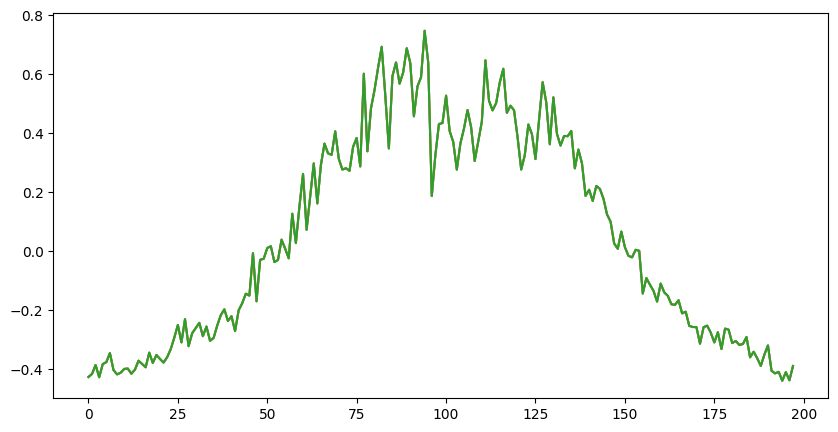

New bead: 76
New bead: 77
New bead: 78
38.71457383812488


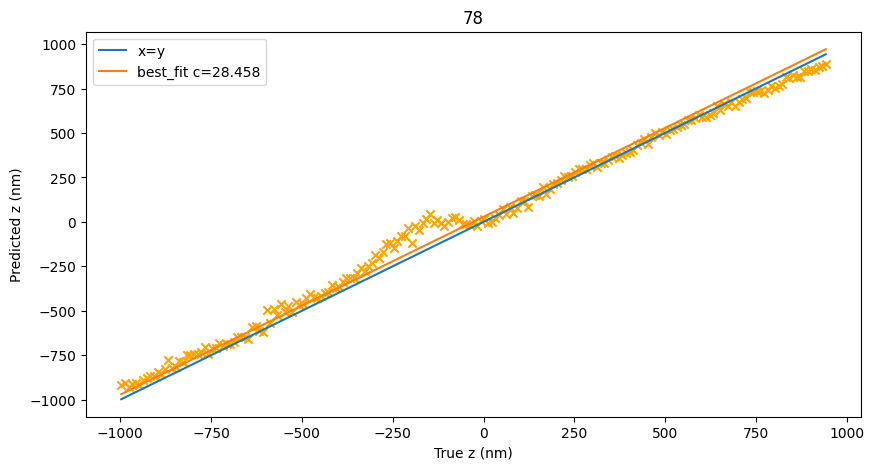

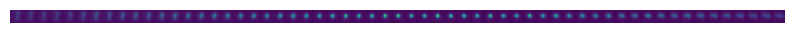

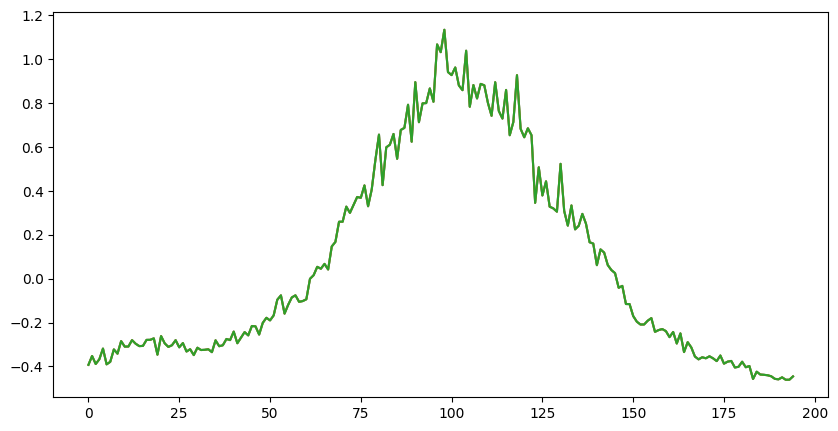

New bead: 79
30.857693495372295


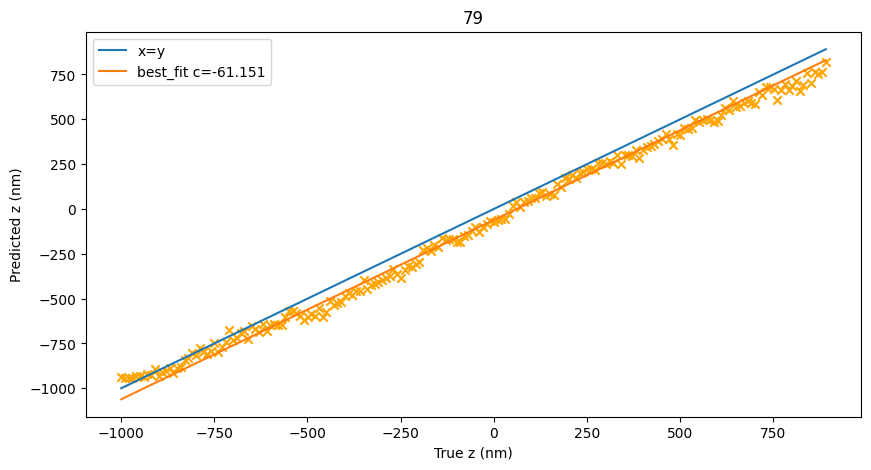

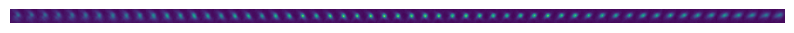

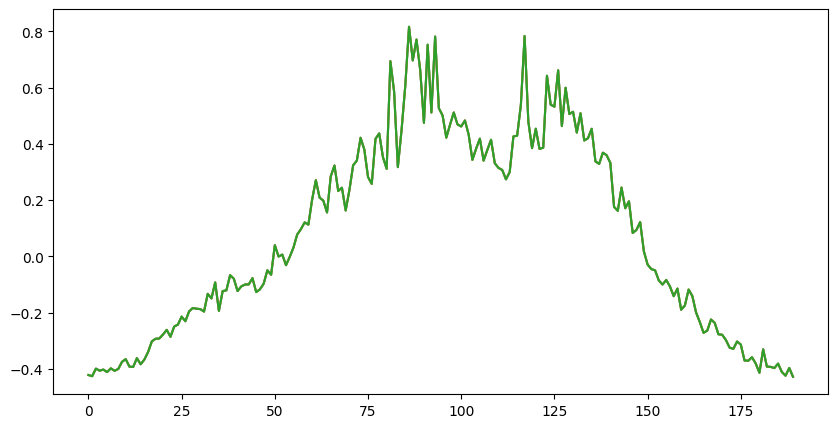

New bead: 80
60.60034412162285


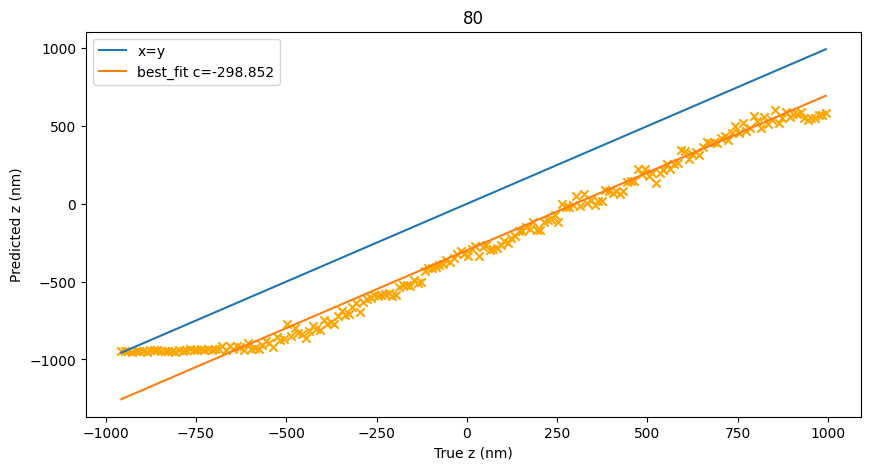

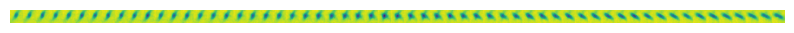

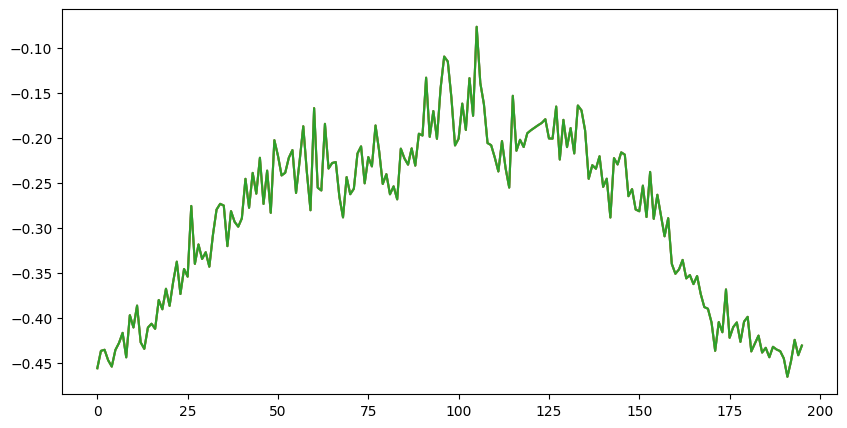

New bead: 81
New bead: 83
New bead: 84
39.4506987430838


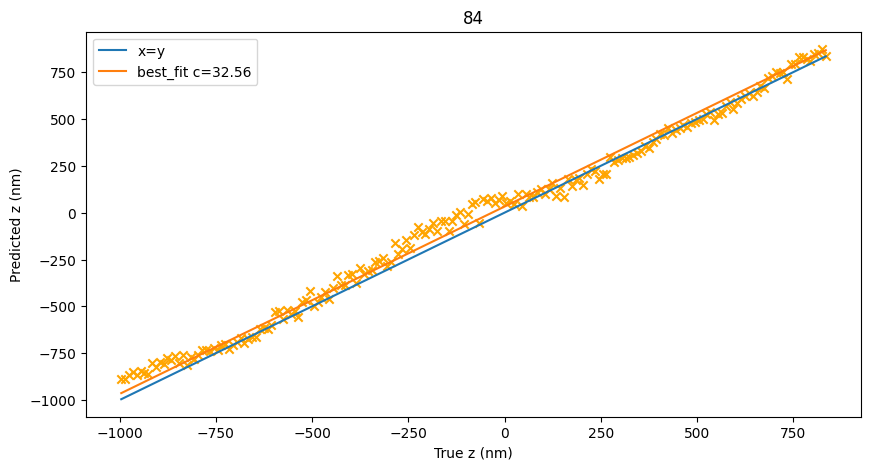

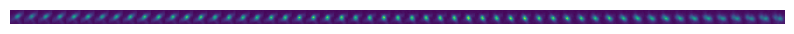

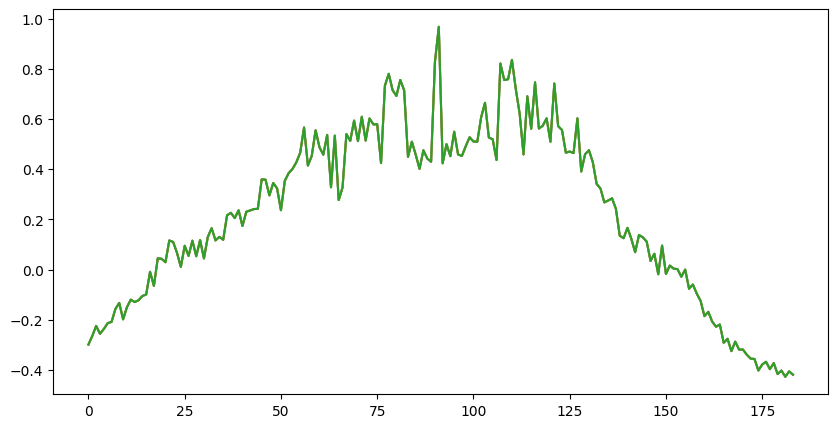

New bead: 85
New bead: 86
33.20294295818057


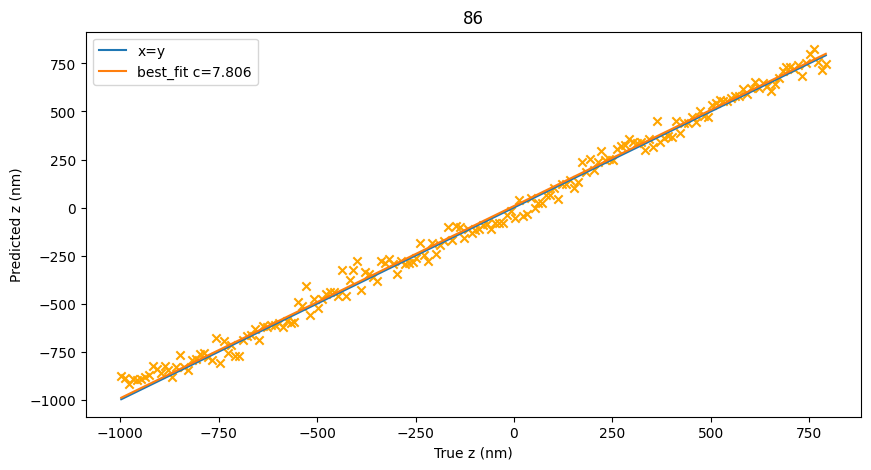

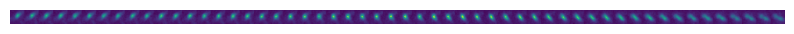

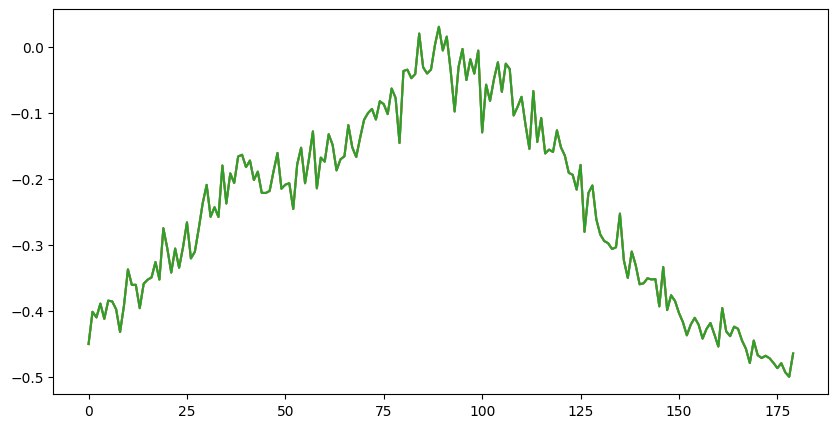

New bead: 87
New bead: 88
New bead: 89
90.4683535882955


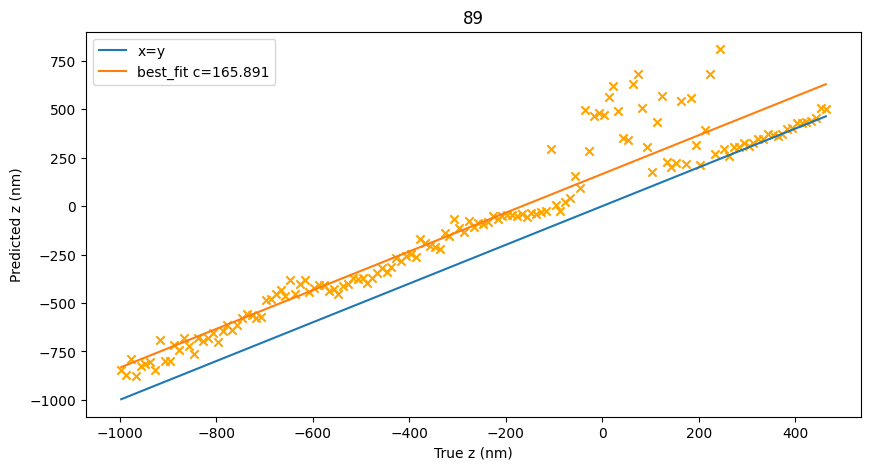

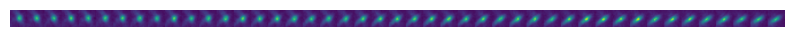

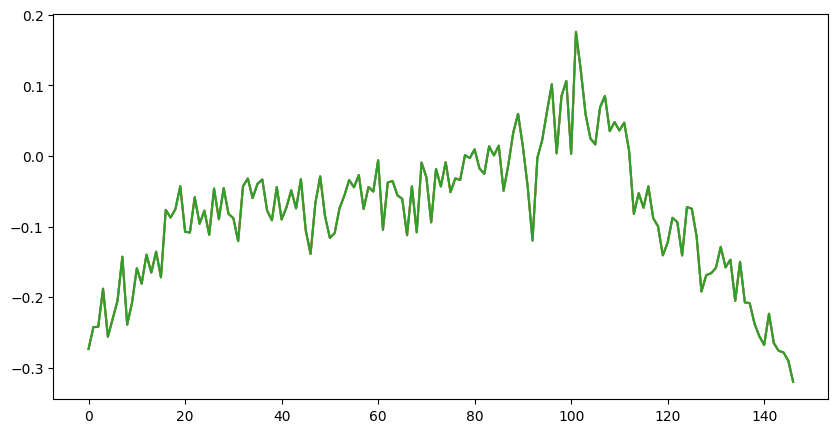

New bead: 90
78.11629836603137


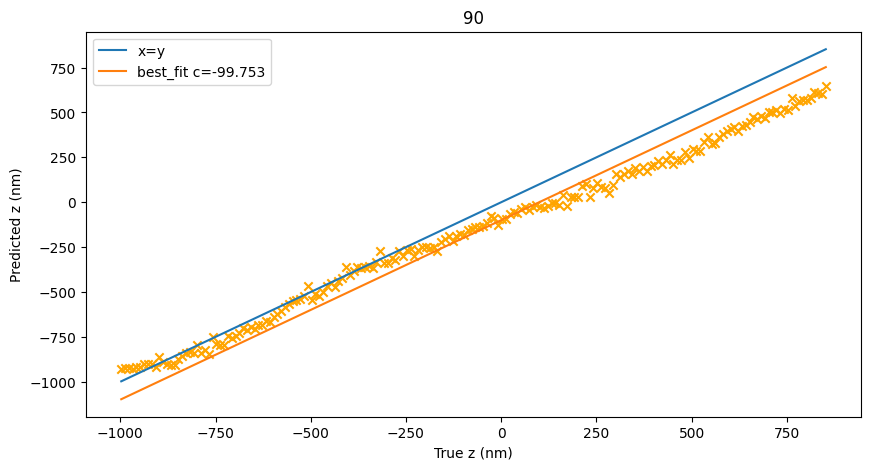

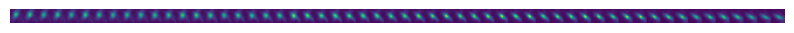

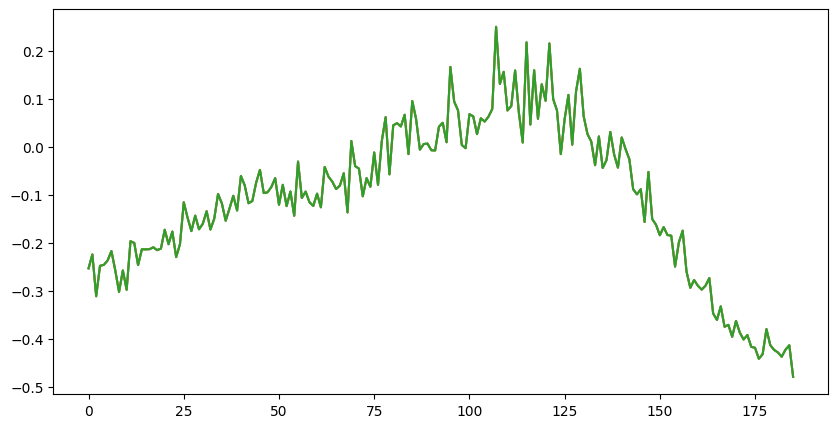

New bead: 91
37.84692748576626


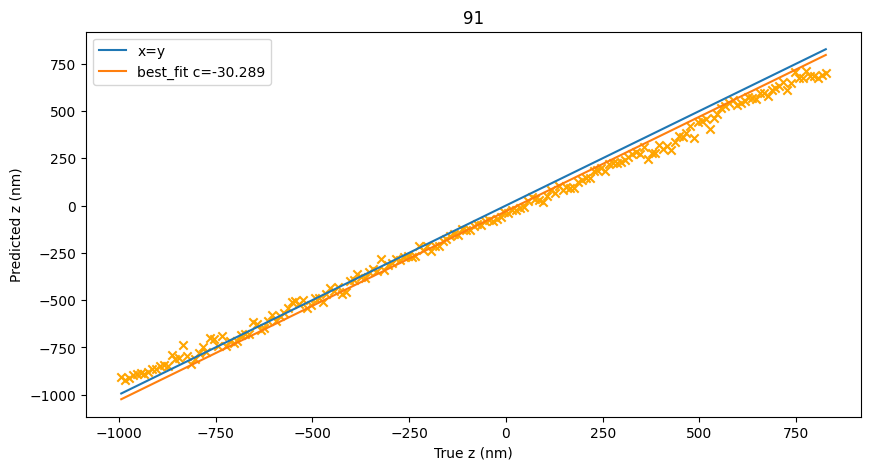

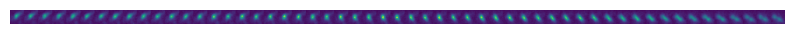

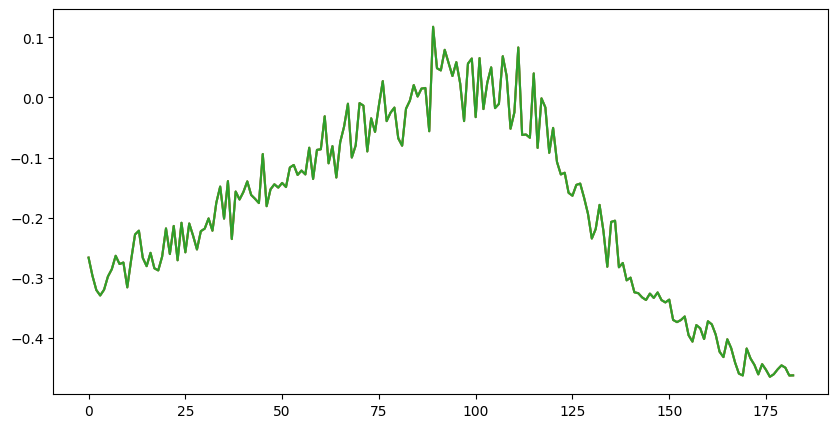

New bead: 92
New bead: 93
New bead: 94
New bead: 95
42.37781492678611


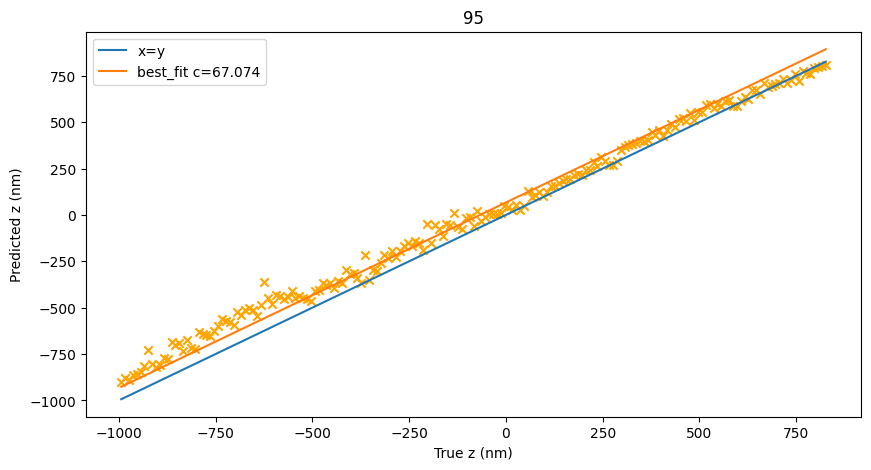

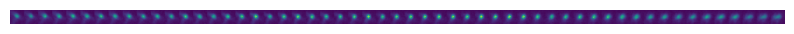

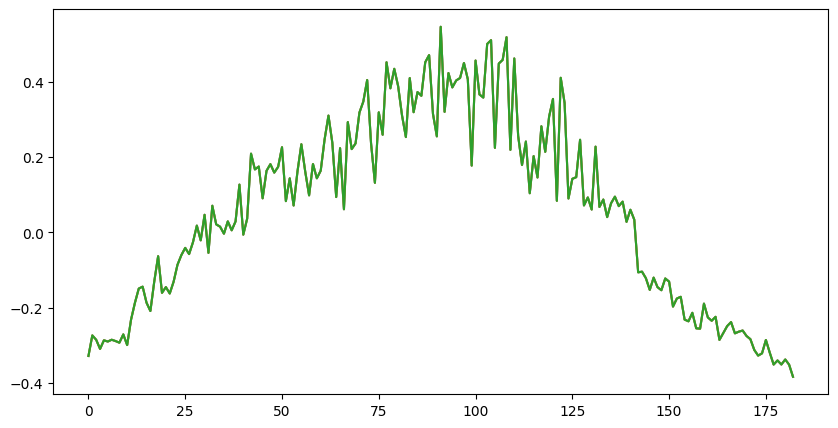

New bead: 96
New bead: 97
39.50280245564726


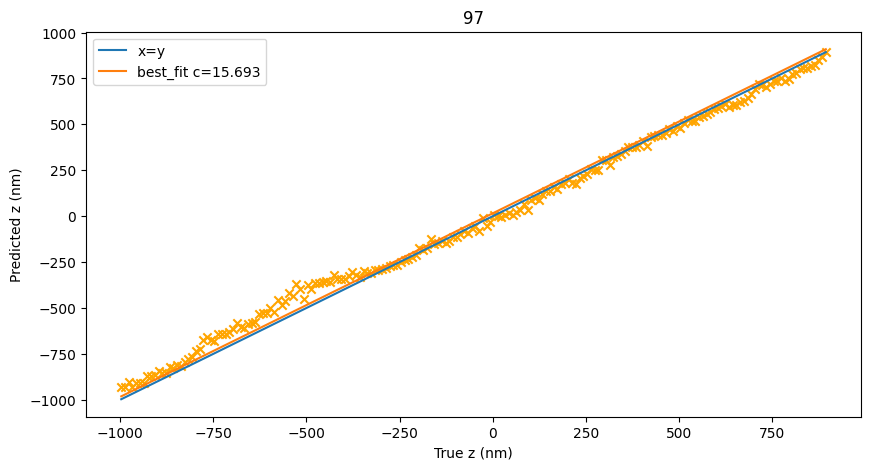

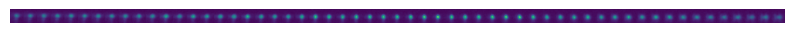

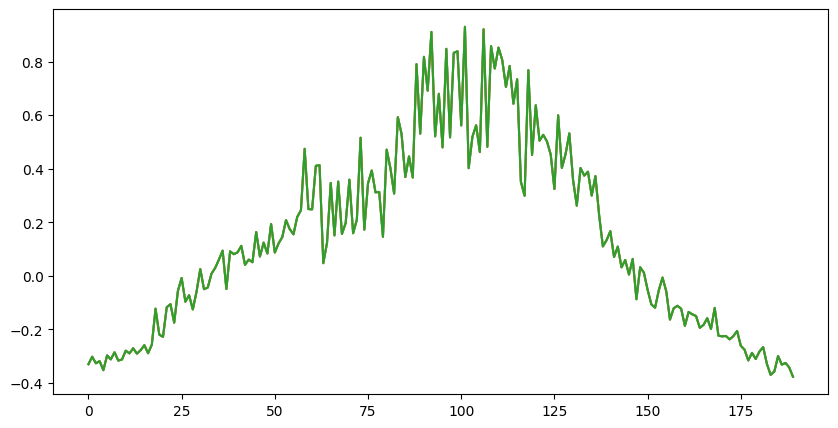

New bead: 98
58.24184546350591


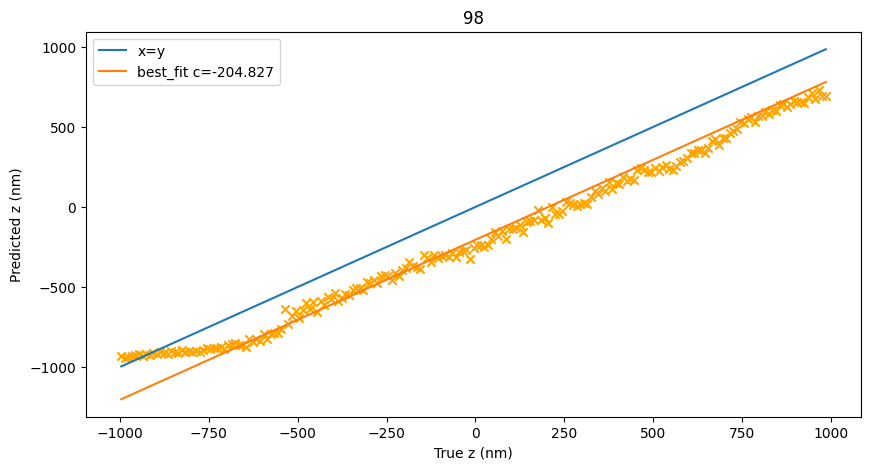

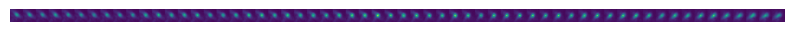

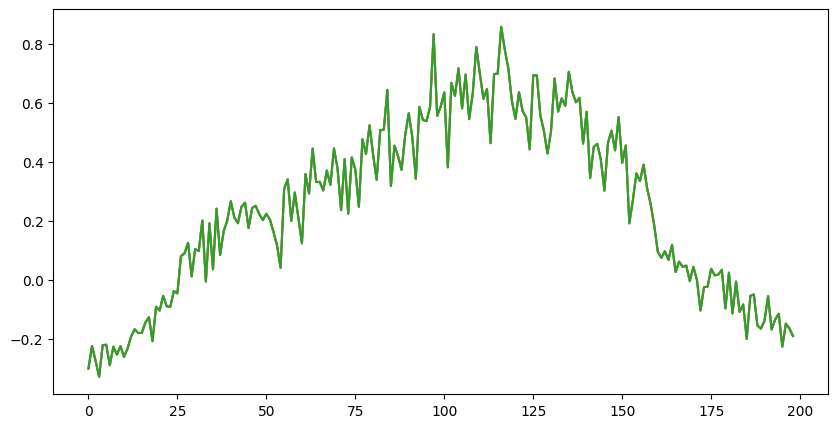

New bead: 99
New bead: 100
50.11948037097506


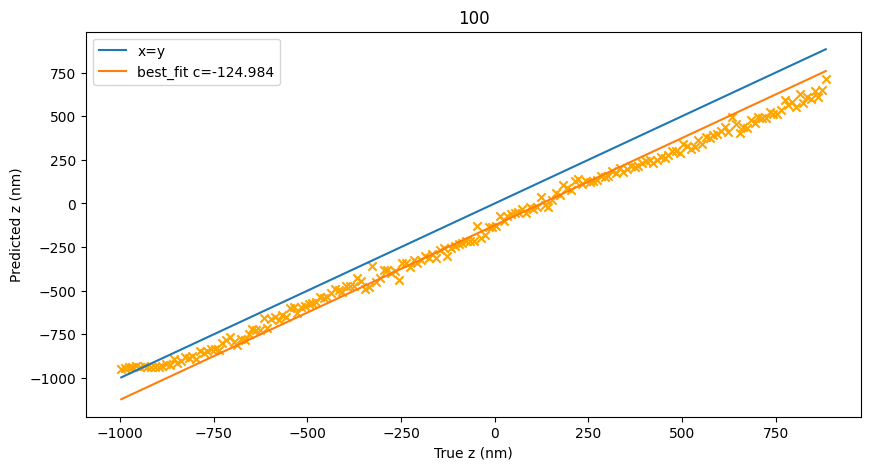

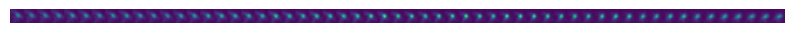

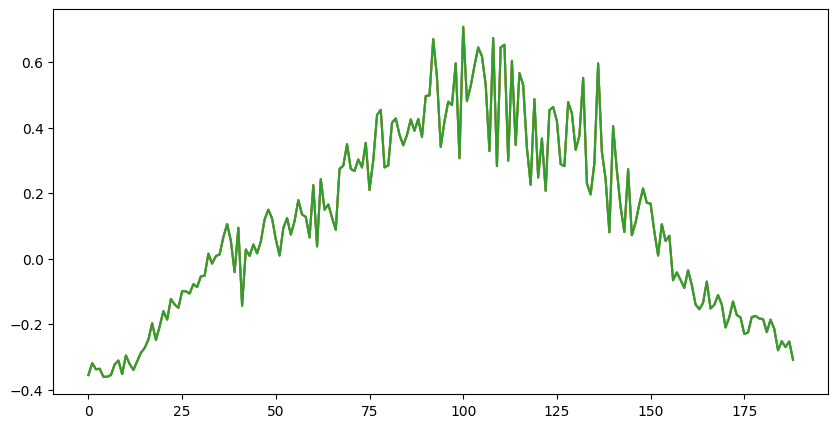

New bead: 101
New bead: 102
52.495397959634786


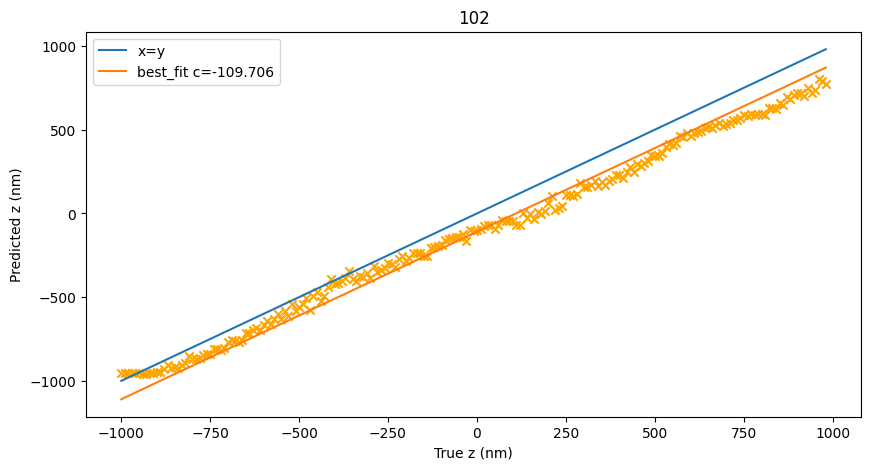

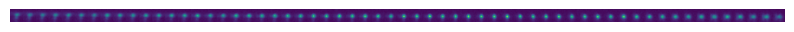

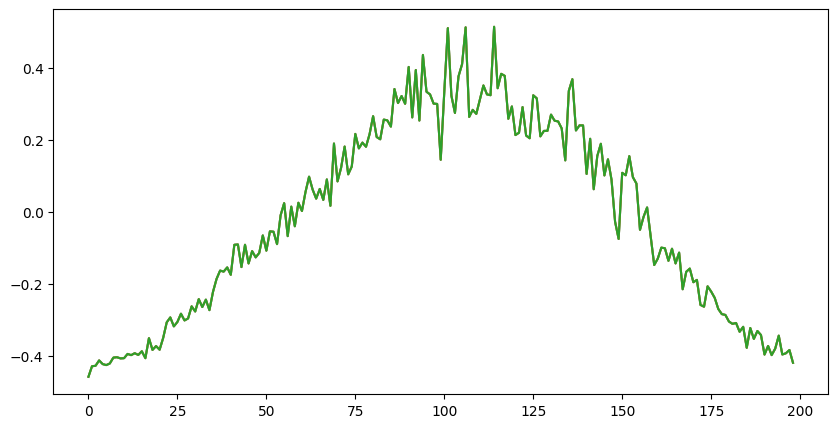

New bead: 103
New bead: 104
New bead: 105
30.05582181044157


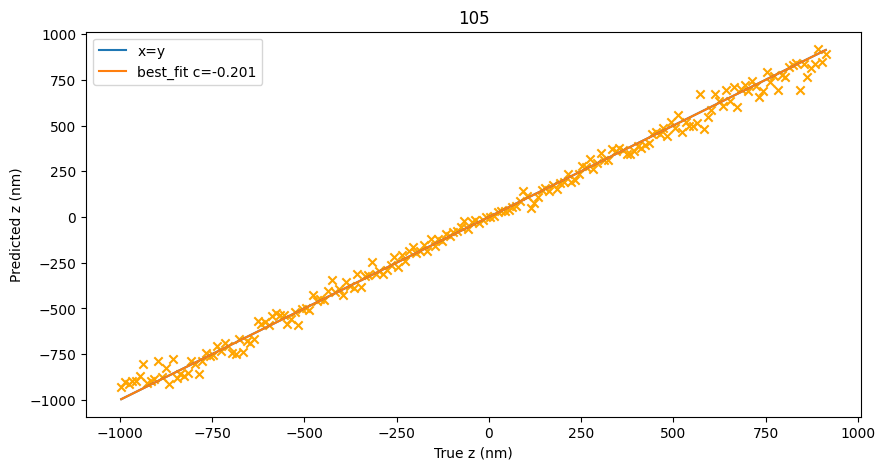

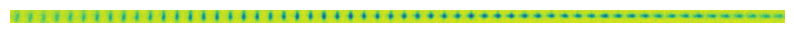

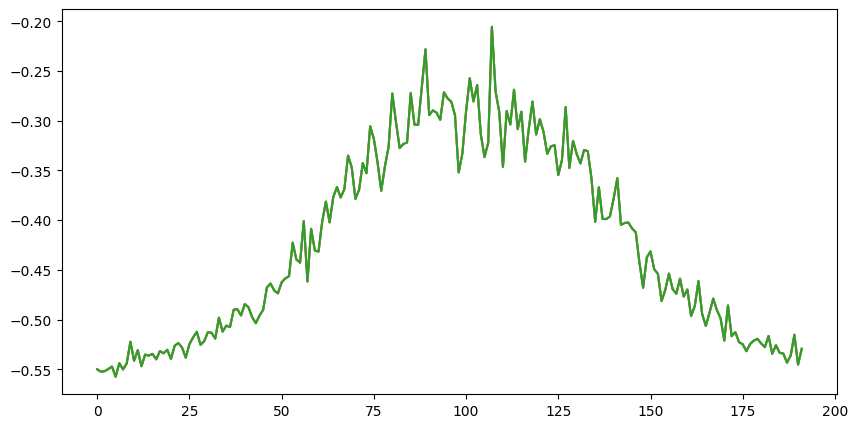

New bead: 106
31.32864128628111


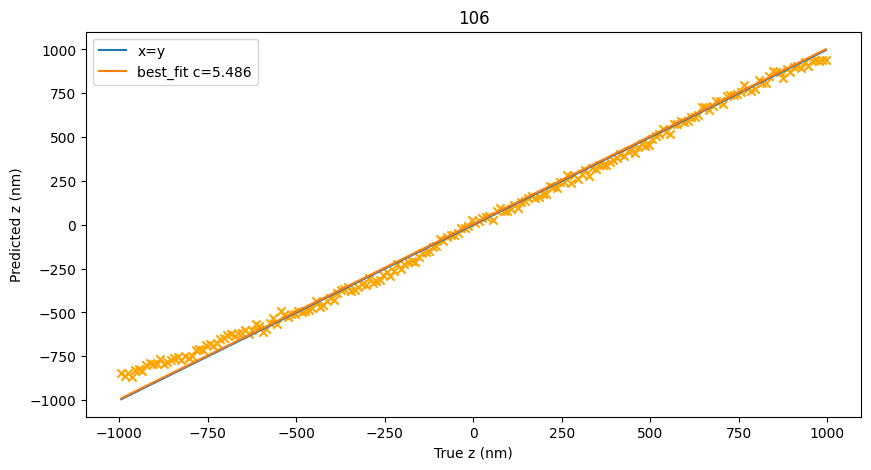

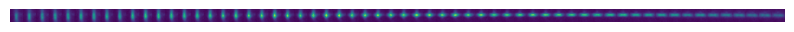

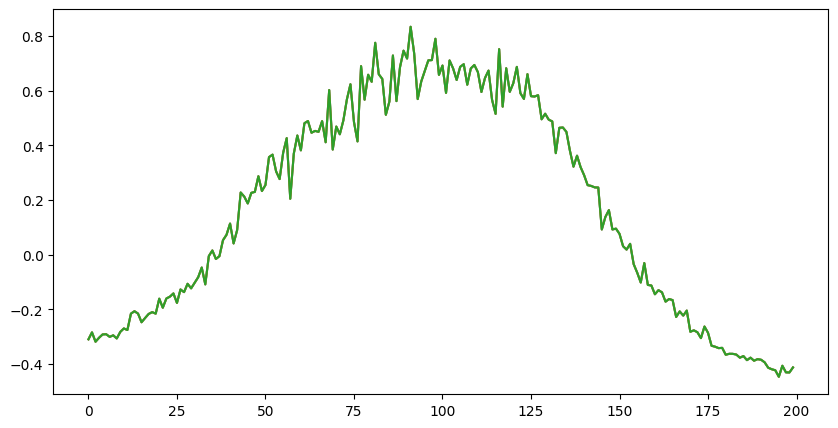

New bead: 107
New bead: 108
30.312898303488833


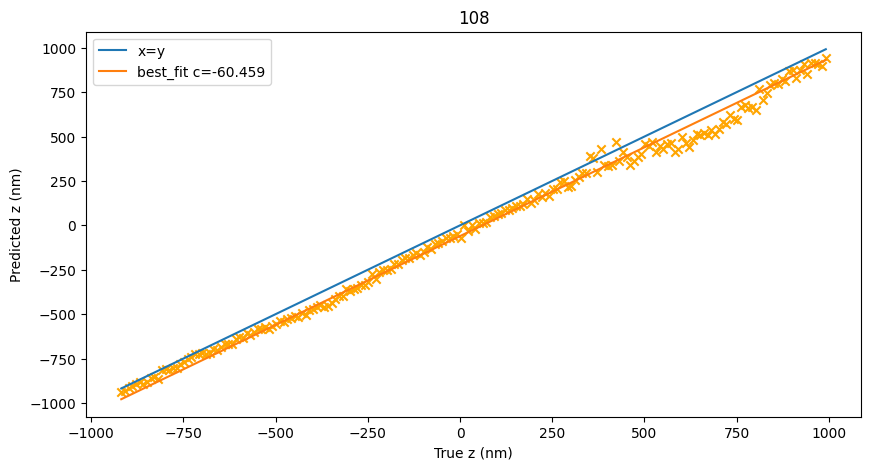

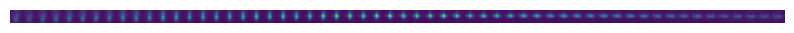

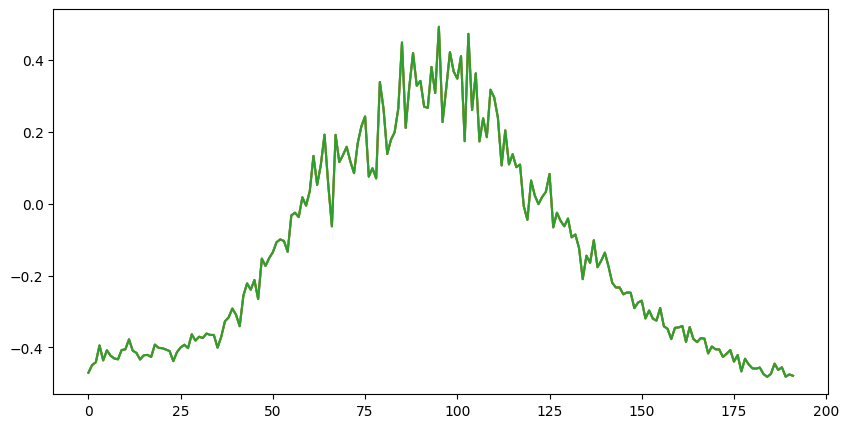

New bead: 109
New bead: 110
New bead: 111
New bead: 112
60.35926058516628


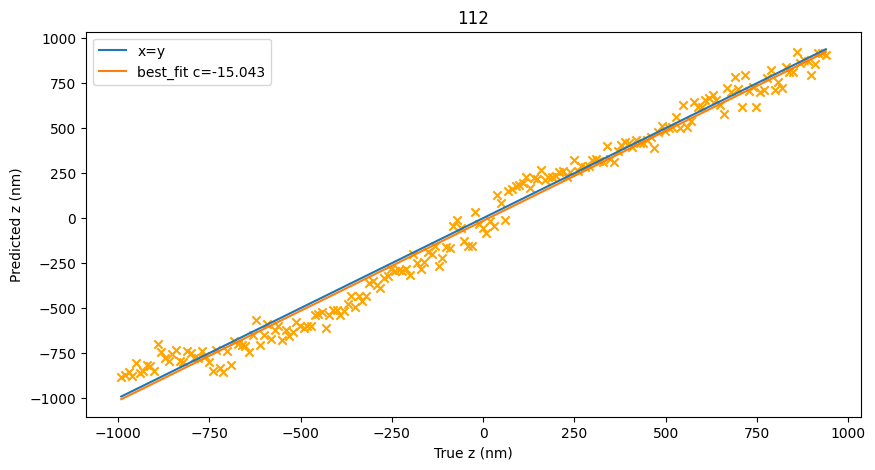

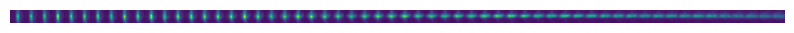

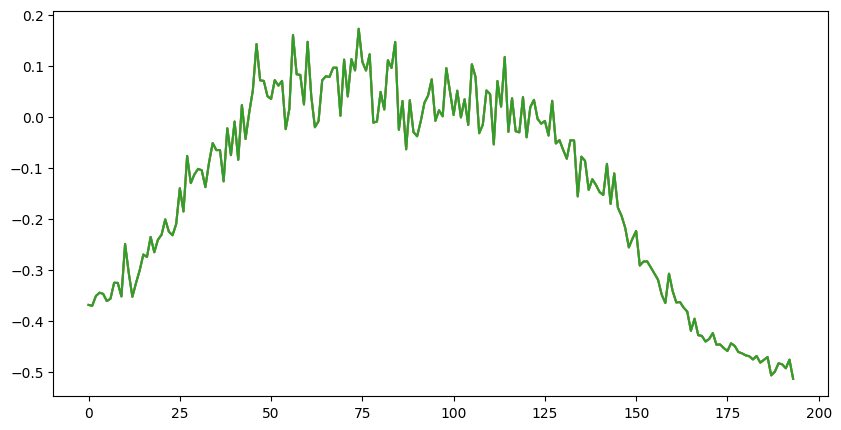

New bead: 113
32.11254399729257


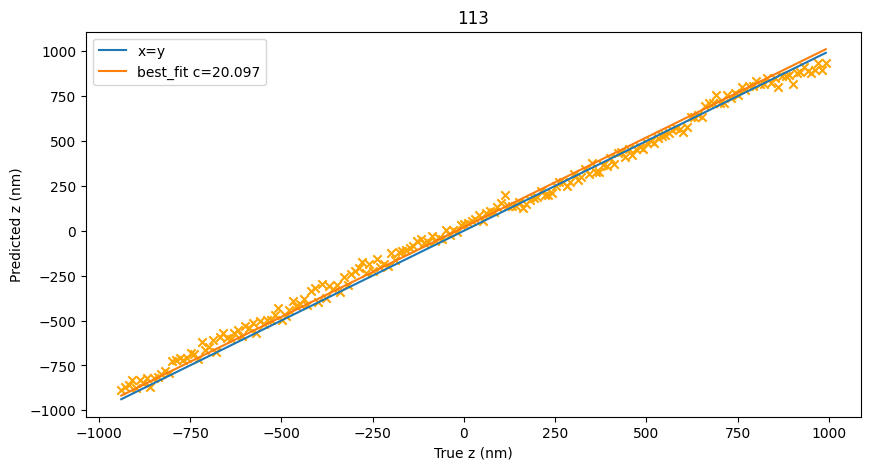

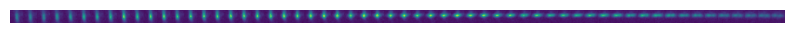

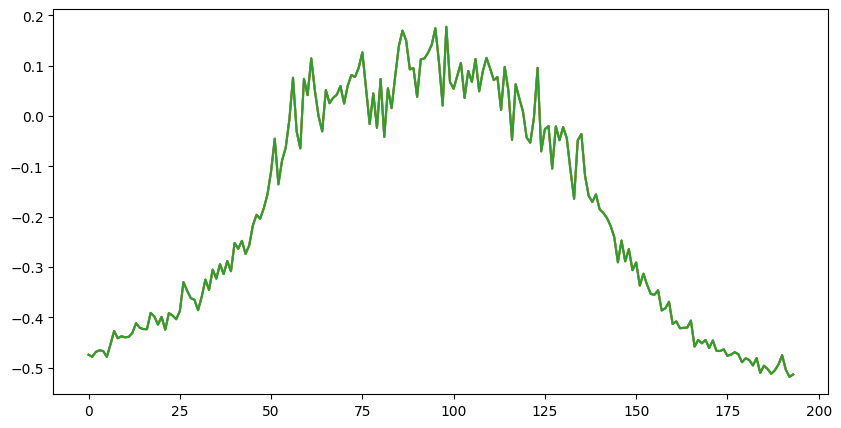

New bead: 114
New bead: 115
84.54408597050184


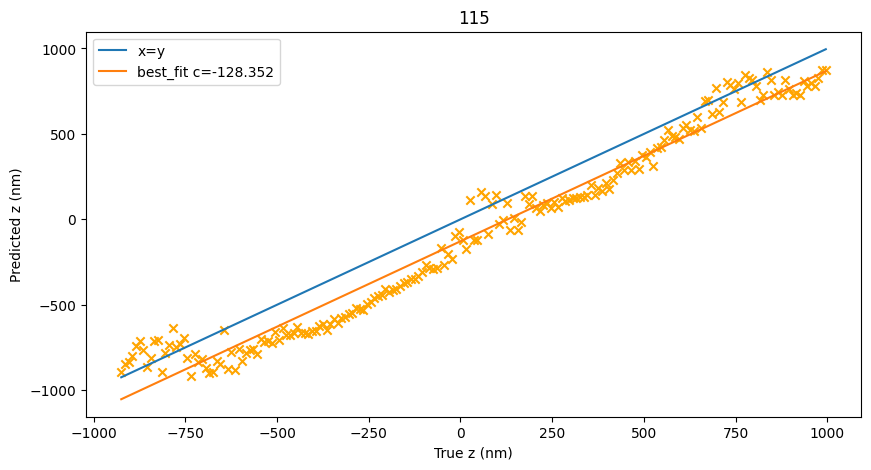

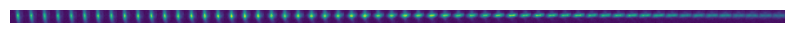

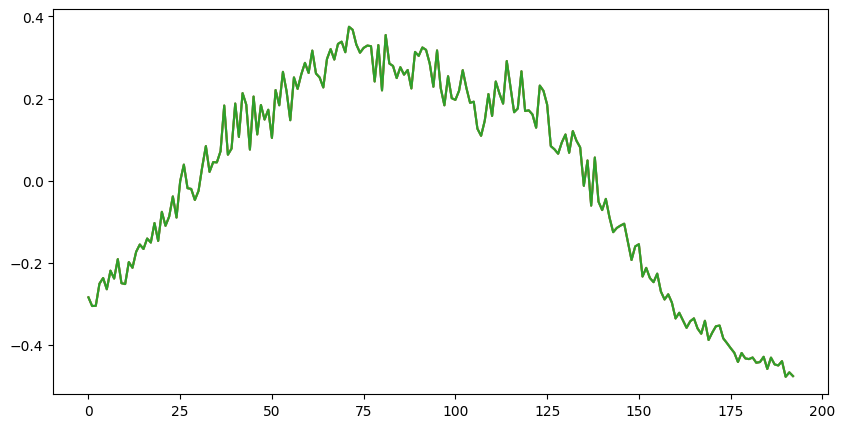

New bead: 116
37.82379232631304


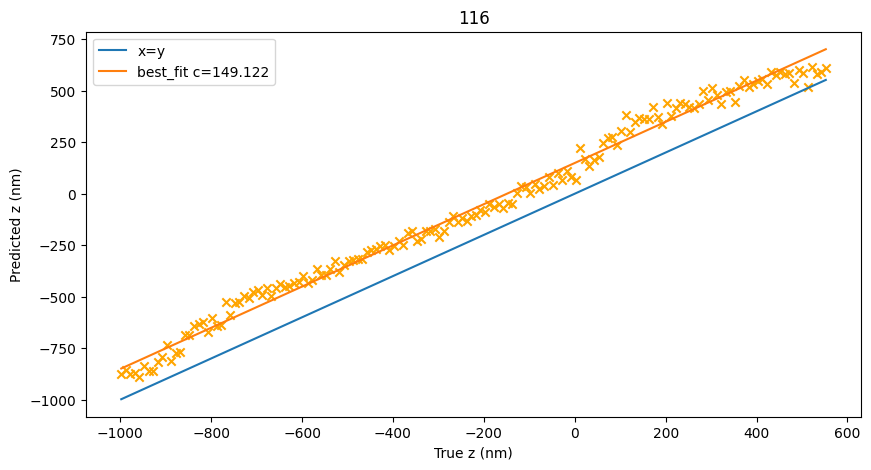

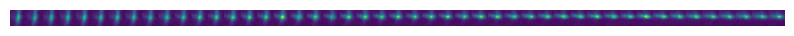

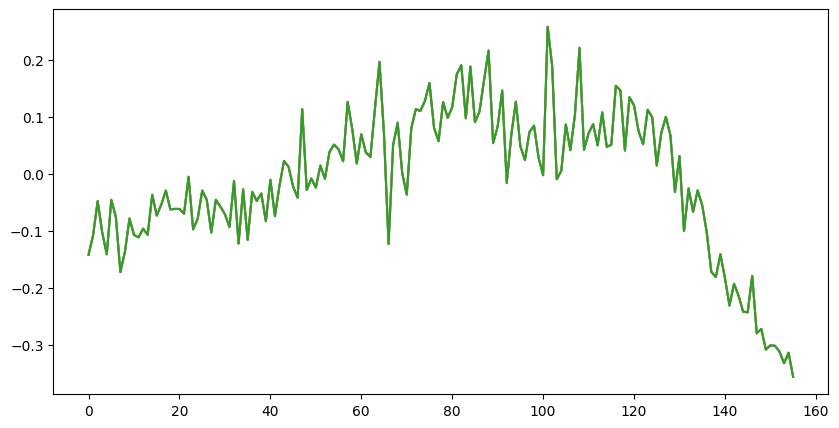

New bead: 117
New bead: 118
New bead: 119
56.6431708268053


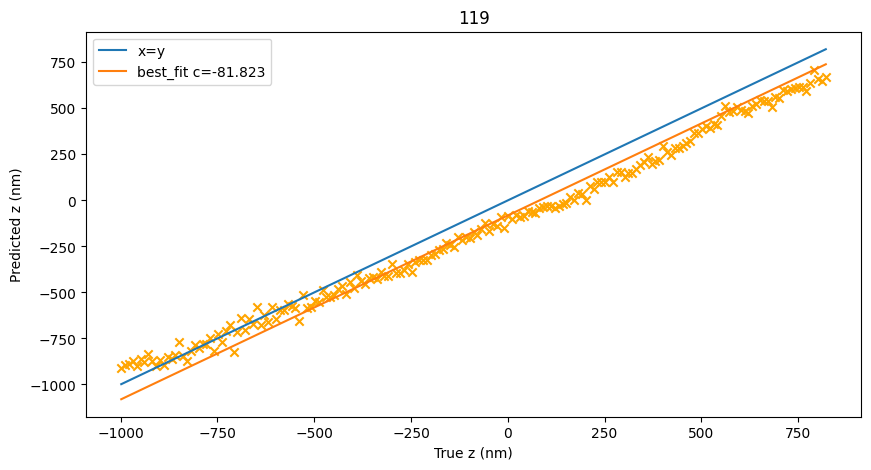

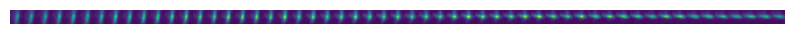

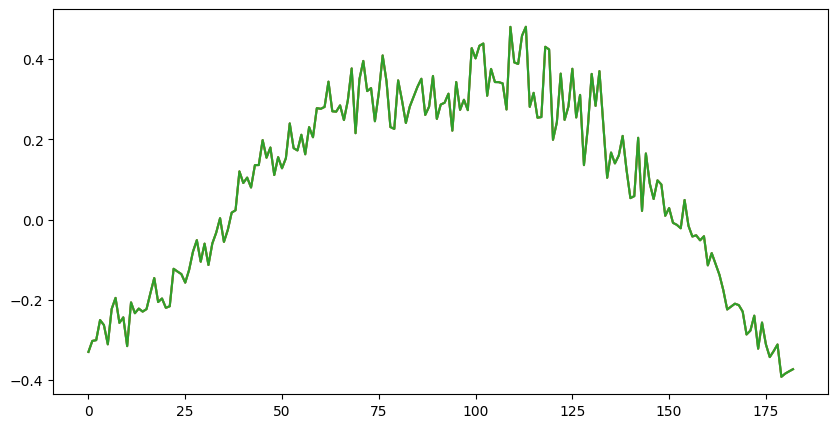

New bead: 120
New bead: 121
50.780925659422486


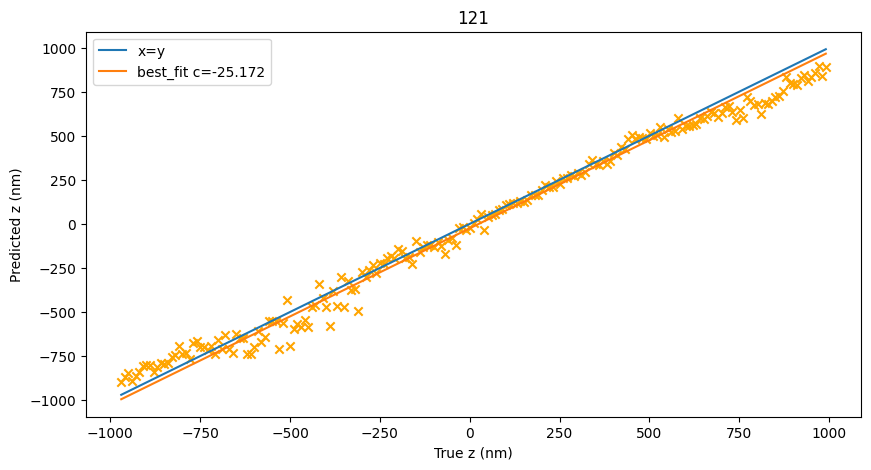

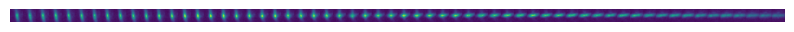

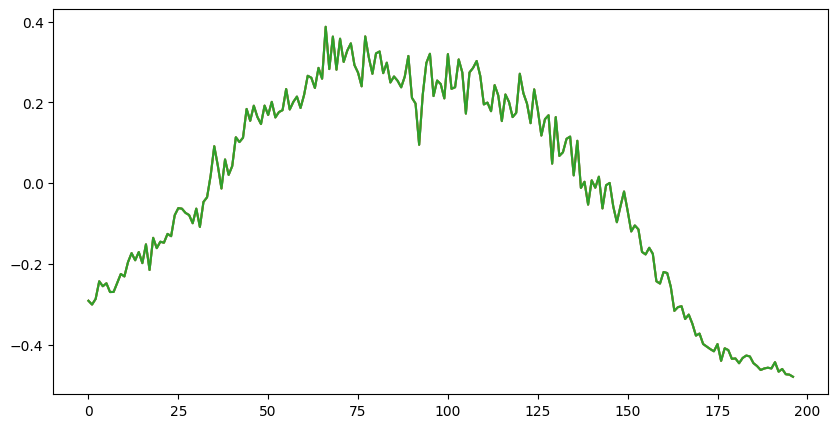

New bead: 122
New bead: 123
New bead: 124
New bead: 125
New bead: 126
New bead: 127
New bead: 128
New bead: 129
New bead: 130
New bead: 131
New bead: 132
New bead: 133
New bead: 134
New bead: 135
34.32830391632204


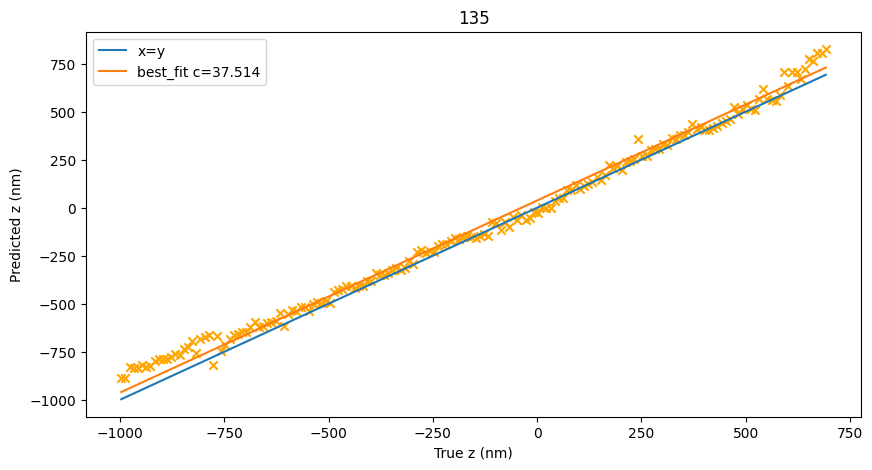

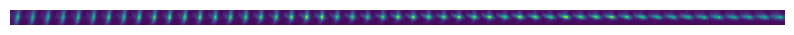

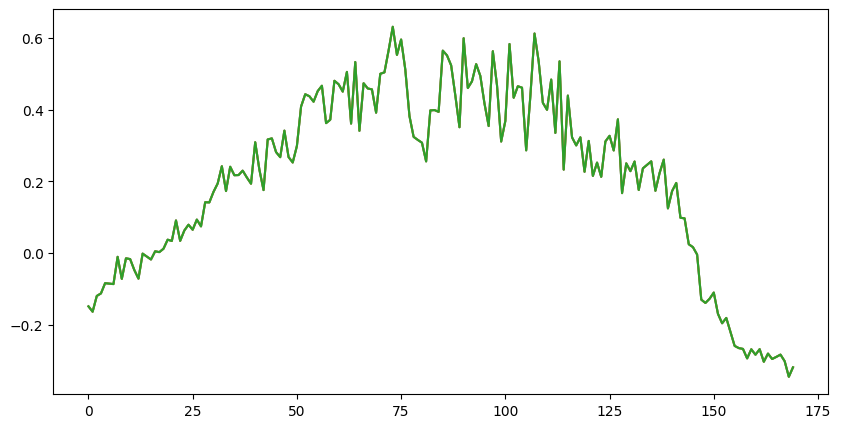

New bead: 136
41.694810722504215


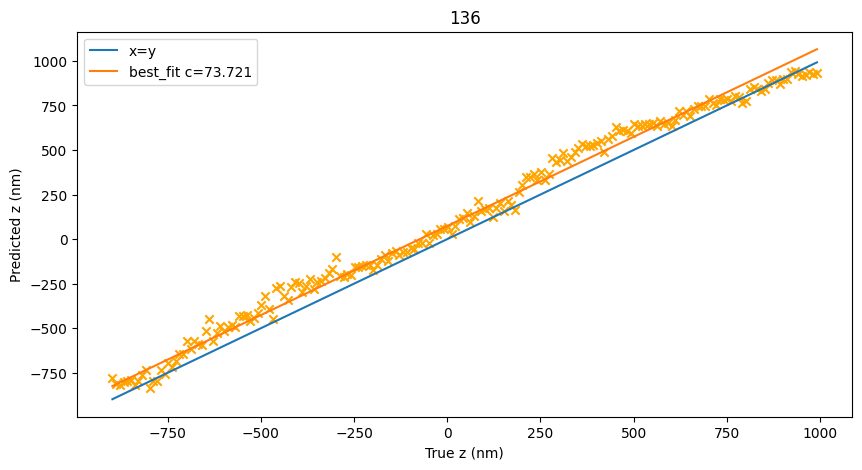

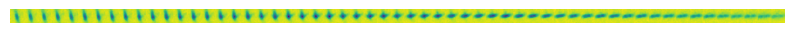

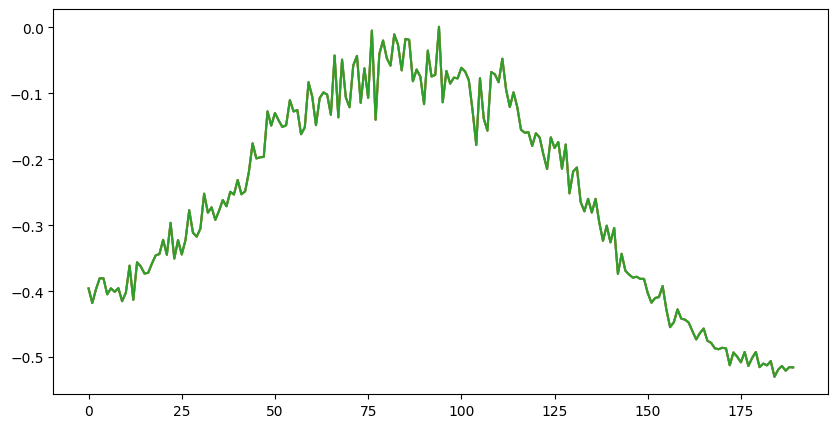

New bead: 137
New bead: 138
48.27526301752388


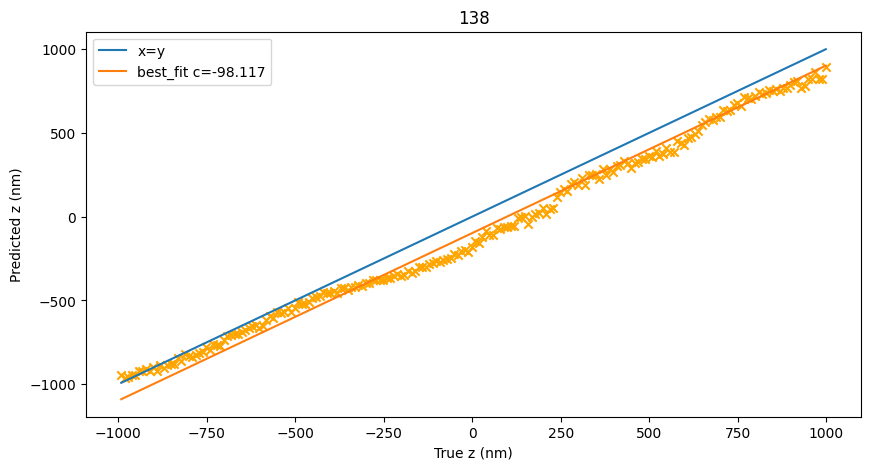

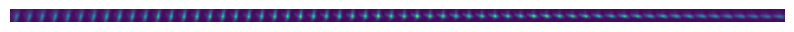

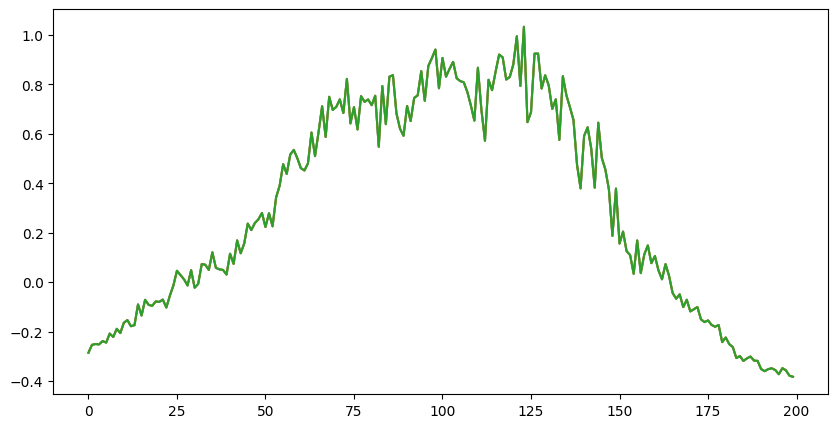

New bead: 139
New bead: 140
New bead: 141
New bead: 142
New bead: 143
New bead: 144
New bead: 145
New bead: 146
New bead: 147
New bead: 148
New bead: 149
New bead: 150
New bead: 151
37.03580101071665


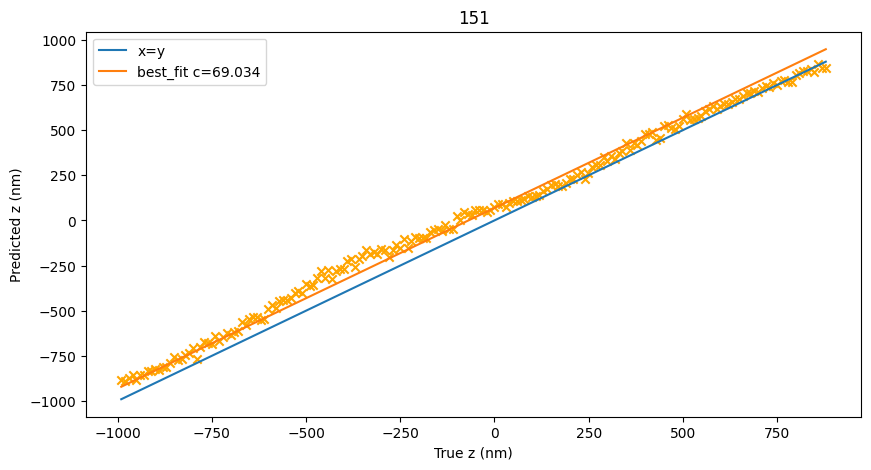

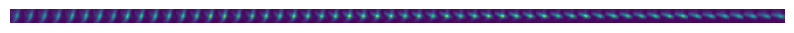

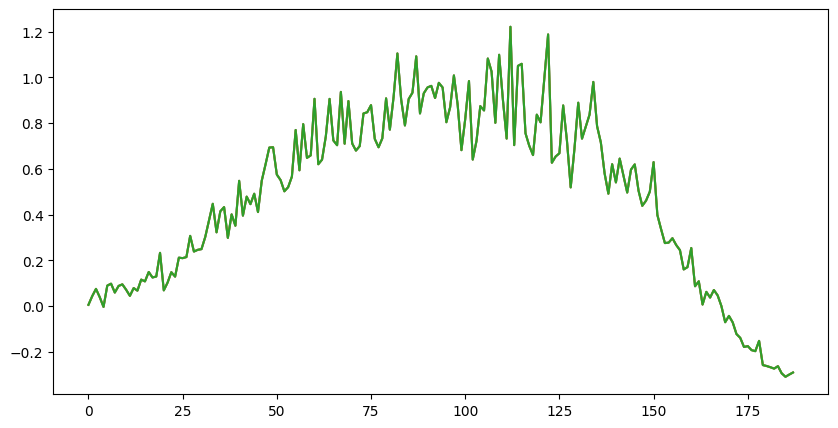

New bead: 152
New bead: 153
New bead: 154
New bead: 155
New bead: 156
New bead: 157
34.9115928123027


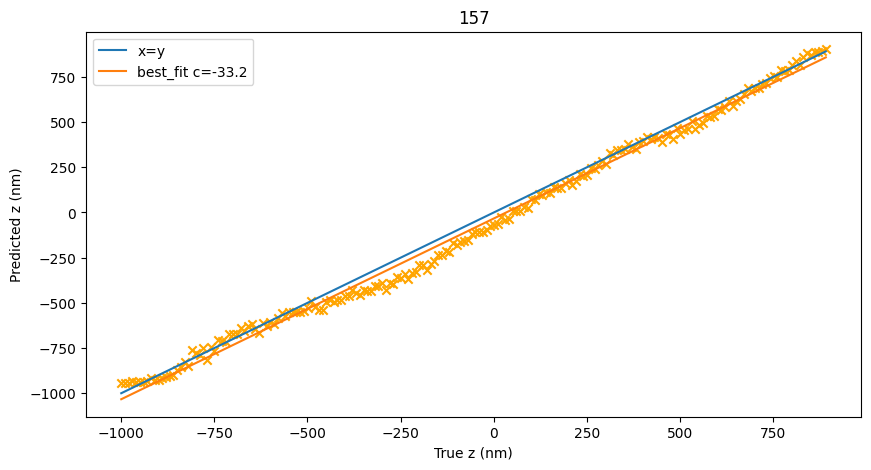

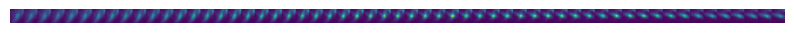

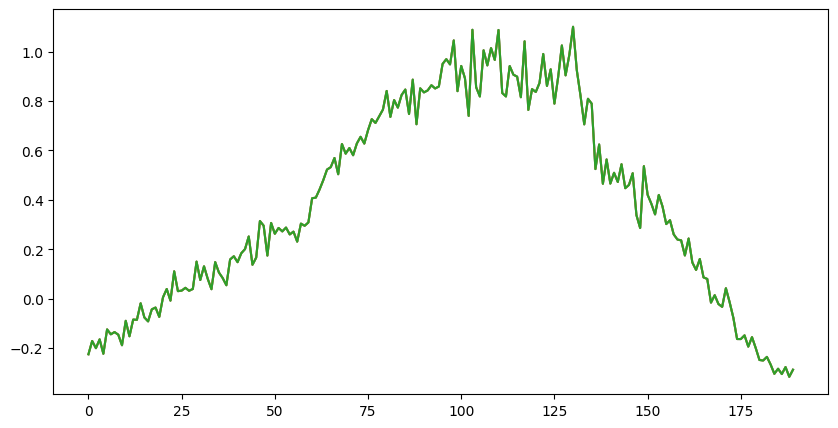

New bead: 158
New bead: 159
New bead: 160
New bead: 161
New bead: 162
New bead: 163
New bead: 164
New bead: 165
New bead: 166
New bead: 168
New bead: 169
New bead: 170
New bead: 171
43.49258801572362


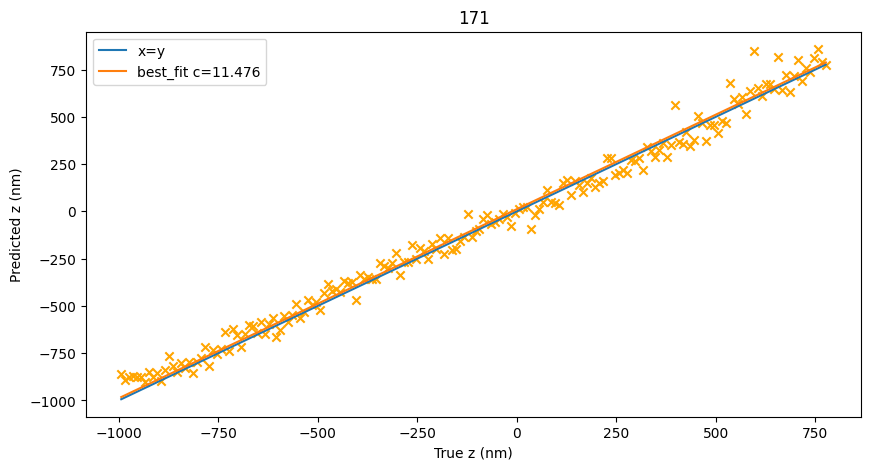

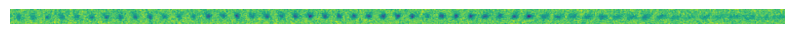

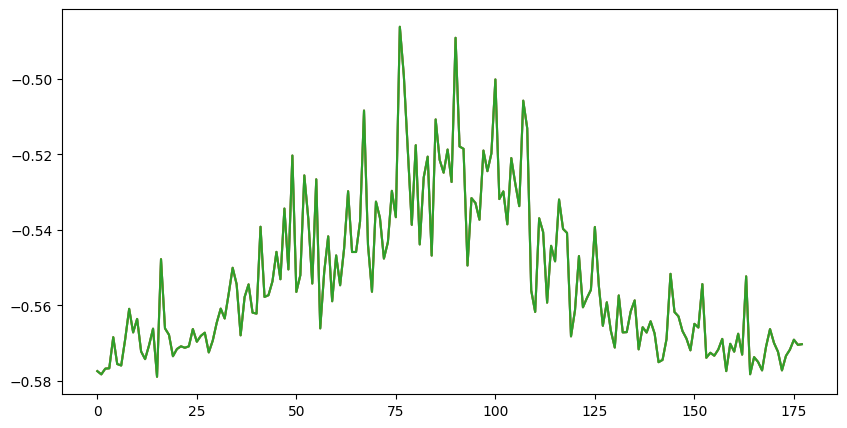

New bead: 172
New bead: 173
New bead: 174
New bead: 175
New bead: 176
34.82629463984495


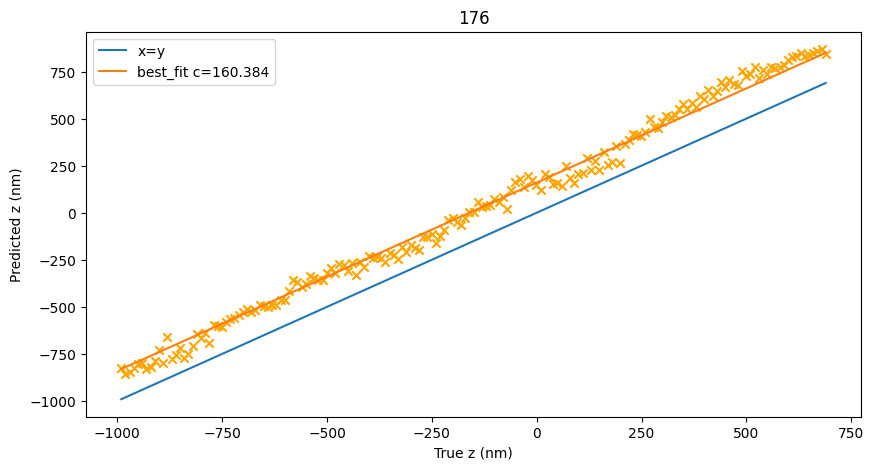

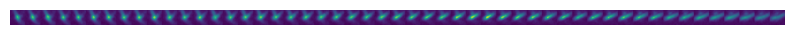

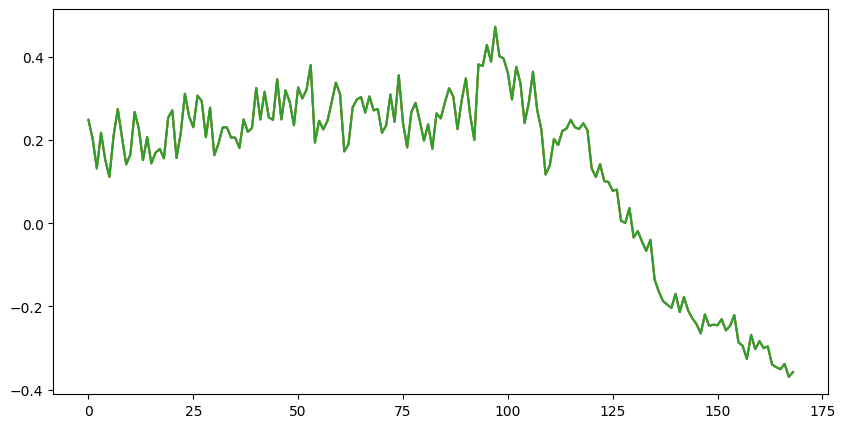

New bead: 177
30.947319989066347


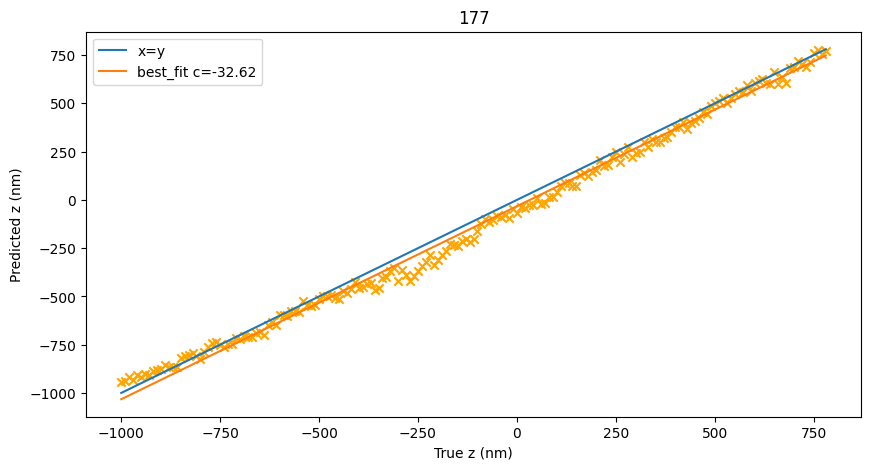

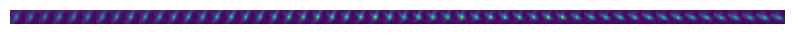

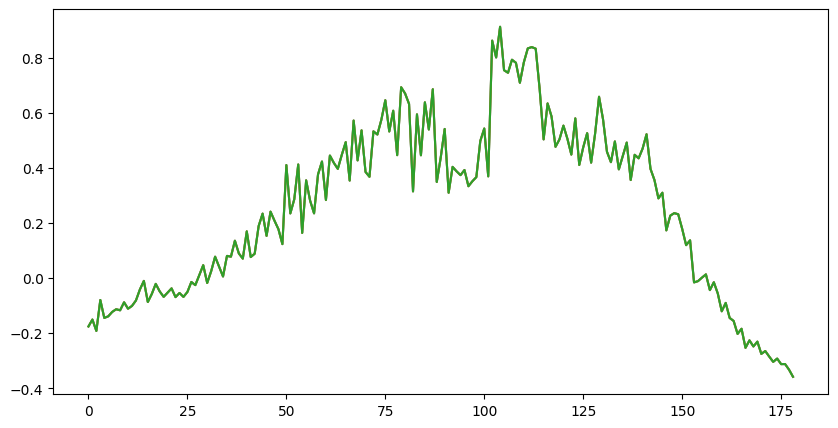

New bead: 178
New bead: 179
New bead: 180
93.72965920305319


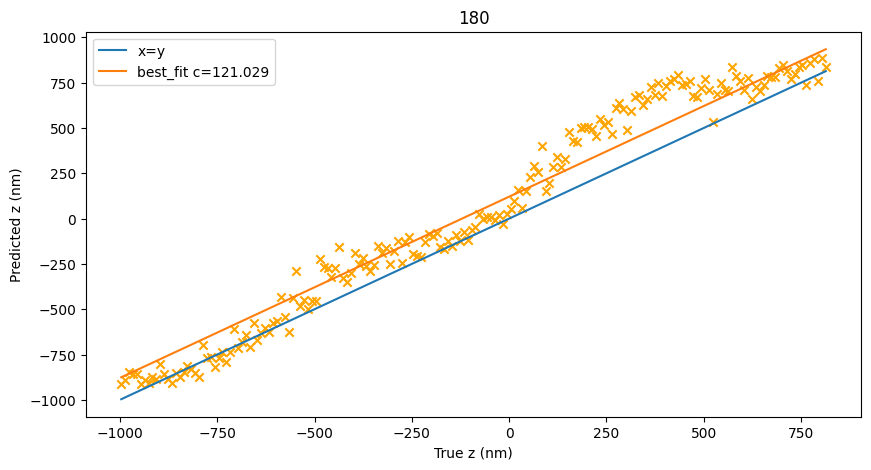

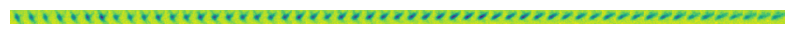

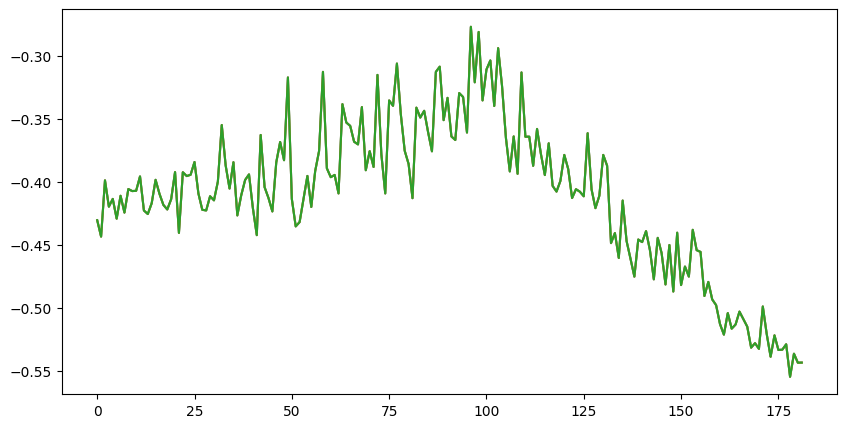

New bead: 181
New bead: 182
New bead: 183
New bead: 184
48.62789947881235


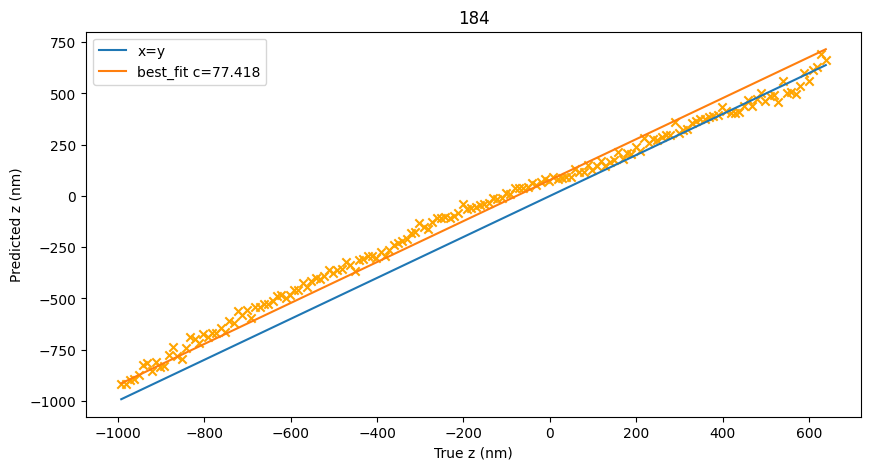

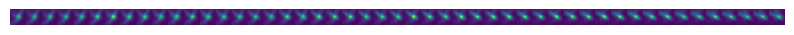

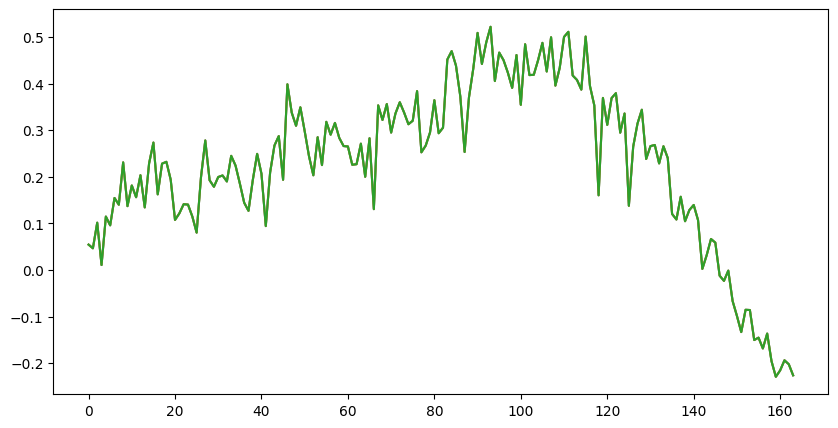

New bead: 185
New bead: 186
New bead: 187
New bead: 188
New bead: 189
New bead: 190
New bead: 191
34.20364377560039


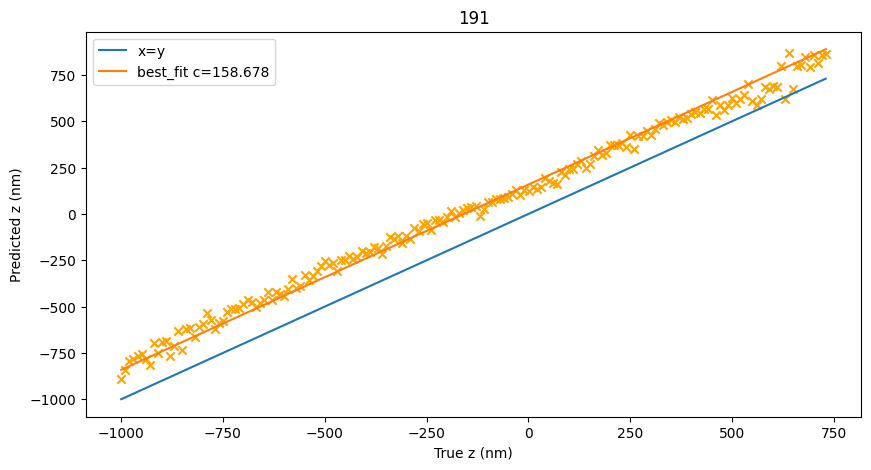

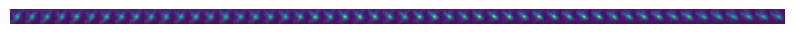

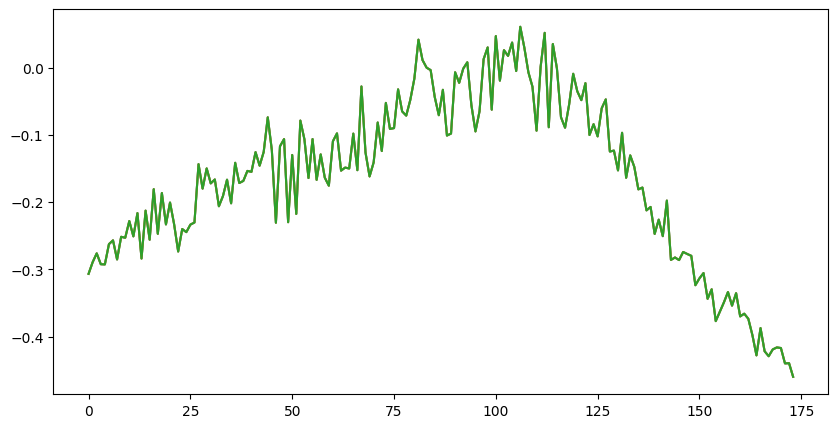

New bead: 192
New bead: 193
42.99577436024489


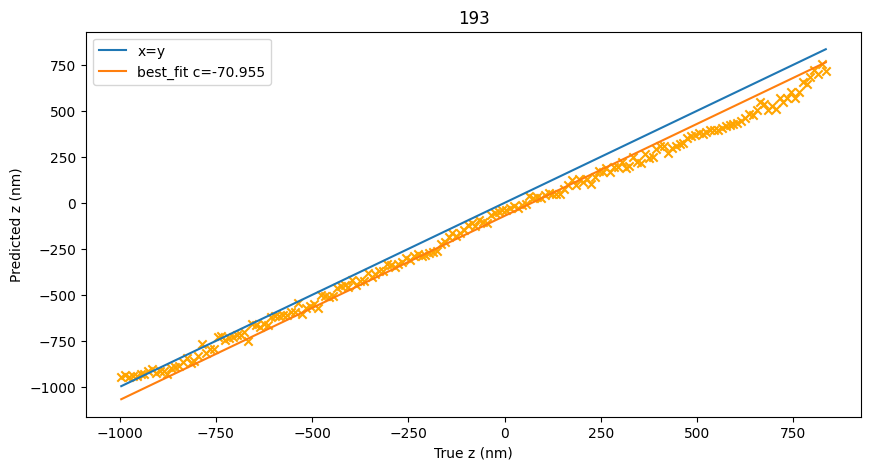

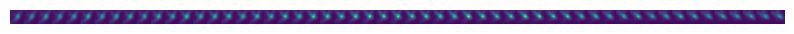

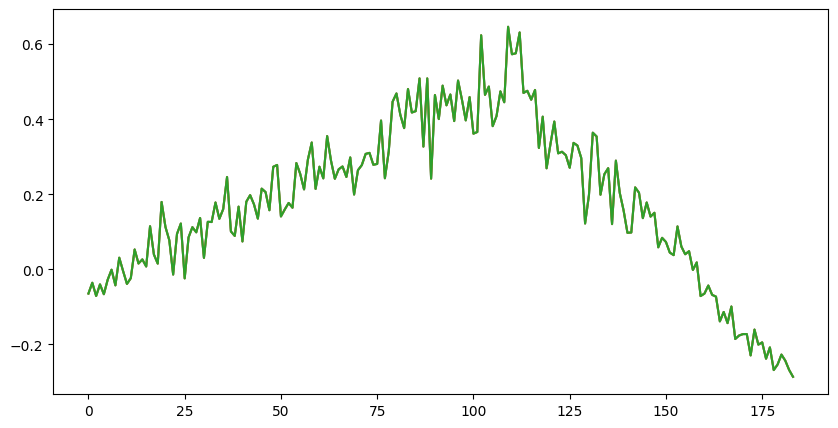

New bead: 194
63.59157883791268


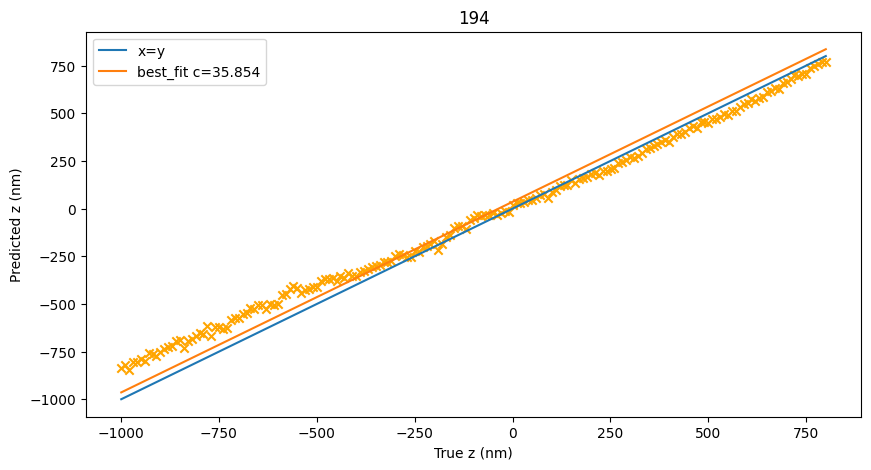

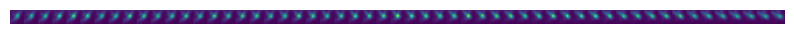

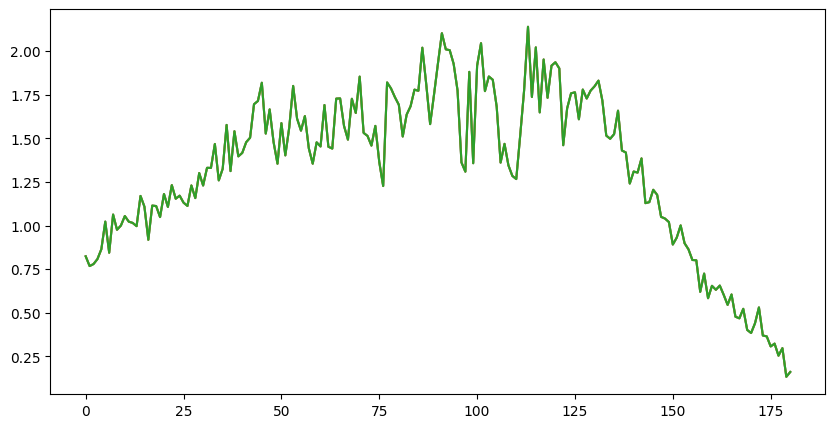

New bead: 195
31.235814238884025


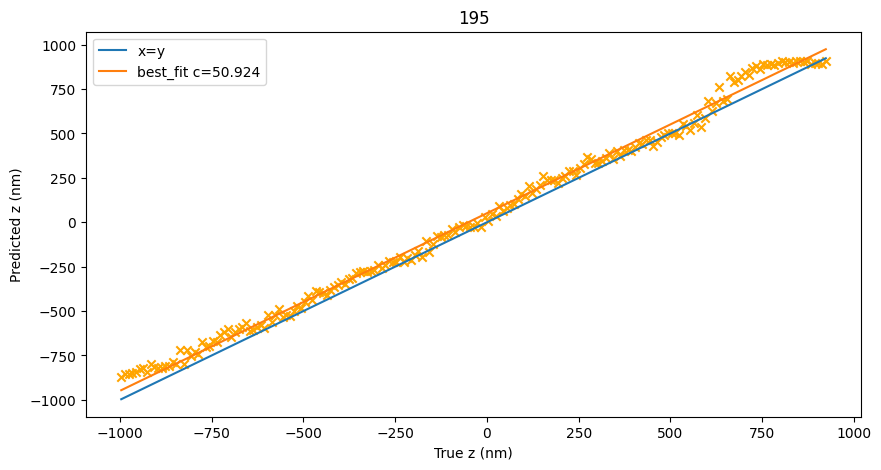

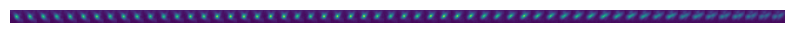

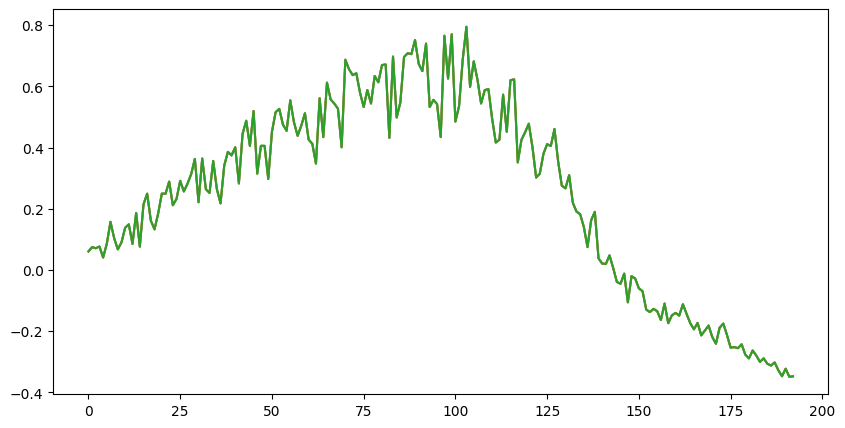

New bead: 196
test
Error 26.829
Mean offset 38.167




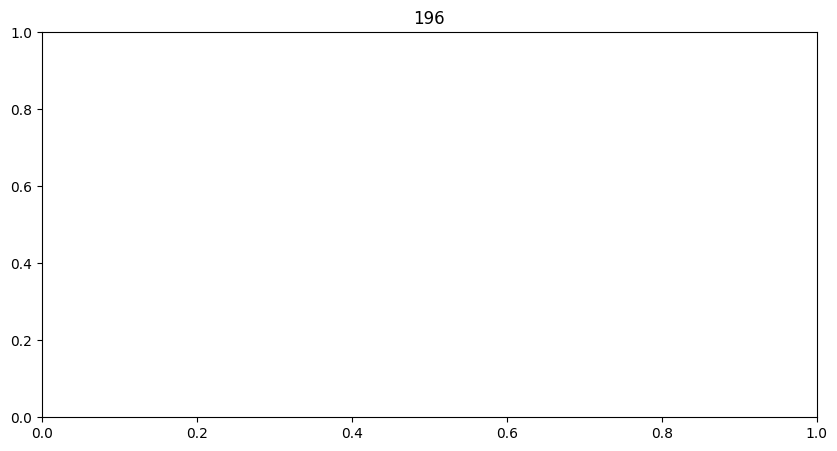

In [23]:
# MAE without located error
import scipy.optimize as opt
import matplotlib.pyplot as plt
from data.visualise import show_psf_axial
from sklearn.preprocessing import LabelEncoder
plt.rcParams['figure.figsize'] = [10,5]

def plot_psf_inten(psfs, z):
    plt.plot(psfs.max(axis=(1,2)))
    plt.show()
    
def bestfit_error(z_true, z_pred):
    def linfit(x, c):
        return x + c

    x = z_true
    y = z_pred
    popt, _ = opt.curve_fit(linfit, x, y, p0=[0])

    x = np.linspace(z_true.min(), z_true.max(), len(y))
    y_fit = linfit(x, popt[0])
    error = mean_absolute_error(y_fit, y)
    if error > 30:
        print(error)
        plt.plot(x, x, label=f'x=y')
        plt.plot(x, y_fit, label=f'best_fit c={round(popt[0], 3)}')
        plt.scatter(z_true, z_pred, marker='x', c='orange')
        plt.legend()
        plt.xlabel('True z (nm)')
        plt.ylabel('Predicted z (nm)')
        plt.show()
    return error, popt[0], y_fit, abs(y_fit-y)

ds = [
#     ('train', (X_train_preproc, y_train)),
    ('test', test_data)
]

offsets = {}
errors = {}
zss = []
fitss = []
for k, dataset in ds:
    y = np.concatenate([y for x, y in dataset], axis=0)
    pred_z = model.predict(dataset, verbose=True)
    offsets[k] = []
    errors[k] = []
    
    labels = np.concatenate([x[1] for x, y in dataset], axis=0).astype(str)
    psfs = np.concatenate([x[0] for x, y in dataset], axis=0)
    labels = [','.join(list(arr)) for arr in labels]
    label_ids = LabelEncoder().fit_transform(labels)
    y = y.squeeze()
    for g in set(label_ids):
        if g in [13, 30, 38, 82, 167]:
            continue
        print('New bead:', g)
        idx = np.argwhere(label_ids==g)[:, 0]
        group_psfs = psfs[idx]
        group_zs = y[idx]
        group_true_zs = y[idx]
        group_pred_zs = pred_z[idx][:, 0]
        if len(idx) == 1:
            res[k].append([mean_absolute_error(group_true_zs, group_pred_zs)])
        else:
            plt.title(g)
            error, offset, zs, fits = bestfit_error(group_true_zs, group_pred_zs)
            if error > 30:
                show_psf_axial(group_psfs.mean(axis=-1), '', 2)
                plot_psf_inten(group_psfs, group_zs)

            errors[k].append(error)
            offsets[k].append(offset)
            zss.extend(zs)
            fitss.extend(fits)

for k in errors.keys():
    print(k)
    print('Error', round(np.mean(errors[k]), 3))
    print('Mean offset', round(np.mean(np.abs(offsets[k])), 3))
    print('\n')

In [24]:
for k in errors.keys():
    print(k)
    print('Error', round(np.mean(errors[k]), 3))
    print('Mean offset', round(np.mean(np.abs(offsets[k])), 3))
    print('\n')

test
Error 26.829
Mean offset 38.167




In [25]:
import pandas as pd
ries_data = pd.read_csv('./ries_comparison_data.csv')
cols = list(ries_data)
ries_deeploc = ries_data[[c for c in cols if ('DeepLoc' in c) or ('z(nm)' in c)]].dropna().set_index('z(nm)')
crlb_deeploc = ries_data[[c for c in cols if ('CRLB' in c) or ('z(nm)' in c)]].dropna().set_index('z(nm)')

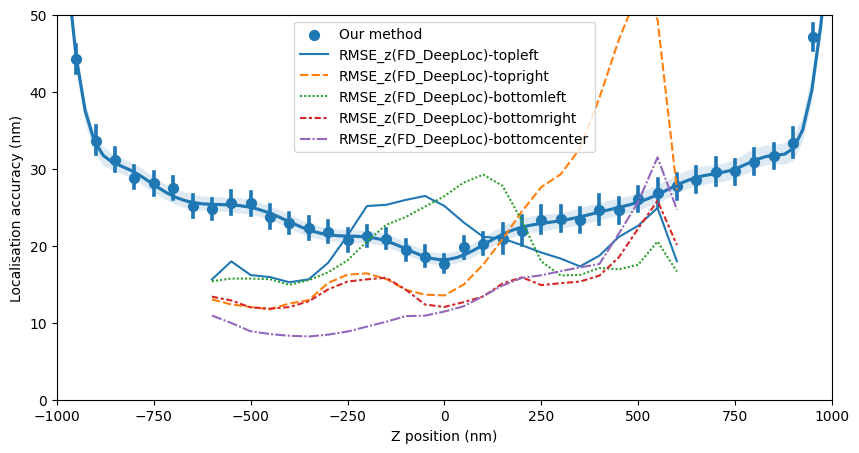

<Axes: xlabel='Z position (nm)', ylabel='Localisation accuracy (nm)'>

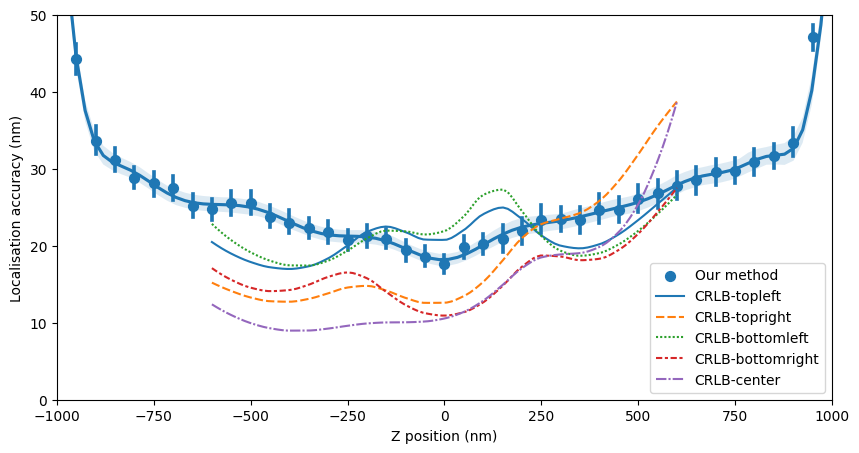

In [29]:
import seaborn as sns
# sns.scatterplot(x=zss, y=fitss)
# plt.show()
sns.regplot(x=zss, y=fitss, scatter=True, ci=95, order=25, x_bins=np.arange(-1000, 1000, 50), label='Our method')
plt.xlim((-1000, 1000))
plt.ylim((0, 50))
plt.xlabel('Z position (nm)')
plt.ylabel('Localisation accuracy (nm)')
sns.lineplot(data=ries_deeploc)
plt.show()

# sns.scatterplot(zss, fitss)
# plt.show()
sns.regplot(x=zss, y=fitss, scatter=True, ci=95, order=25, x_bins=np.arange(-1000, 1000, 50), label='Our method')
plt.xlim((-1000, 1000))
plt.ylim((0, 50))
plt.xlabel('Z position (nm)')
plt.ylabel('Localisation accuracy (nm)')
sns.lineplot(data=crlb_deeploc)

In [8]:
# Error with xy coords
import scipy.optimize as opt
from sklearn.preprocessing import LabelEncoder

def bestfit_error(z_true, z_pred):
    def linfit(x, c):
        return x + c

    x = z_true
    y = z_pred
    popt, _ = opt.curve_fit(linfit, x, y, p0=[0])

    x = np.linspace(z_true.min(), z_true.max(), len(y))
    y_fit = linfit(x, popt[0])
    error = mean_absolute_error(y_fit, y)
    plt.plot(x, x, label=f'x=y')
    plt.plot(x, y_fit, label=f'best_fit c={popt[0]}')
    plt.scatter(z_true, z_pred, marker='x', c='orange')
    return error, popt[0], y_fit-y

ds = [
    ('val', (X_val_preproc, y_val)),
    ('test', (X_test_preproc, y_test))
]

res = {}
for k, (X, y) in ds:
    pred_z = model.predict(X, verbose=False)
    res[k] = []
    labels = X[1].astype(str)
    labels = [','.join(list(arr)) for arr in labels]
    label_ids = LabelEncoder().fit_transform(labels)
    
    X2 = X[0].copy(), X[1].copy()
    X2[1][:] = 0
    pred_z_no_coords = model.predict(X2, verbose=False)
    
    y = y.squeeze()
    plt.scatter(y, pred_z, label='w/ coords', marker='.')
    plt.scatter(y, pred_z_no_coords, label='w/o coords', marker='.')
    plt.legend()
    plt.show()
    print(mean_absolute_error(y, pred_z))
    print(mean_absolute_error(y, pred_z_no_coords))

#     for g in set(label_ids):
#         idx = np.argwhere(label_ids==g)[:, 0]
#         group_psfs = X[0][idx]
#         show_psf_axial(group_psfs.mean(axis=-1), '', 2)
#         group_true_zs = y[idx]
#         group_pred_zs = pred_z[idx][:, 0]
#         if len(idx) == 1:
#             res[k].append([mean_absolute_error(group_true_zs, group_pred_zs)])
#         else:
#             error, offset, errors = bestfit_error(group_true_zs, group_pred_zs)
#             error, offset, errors = bestfit_error(group_true_zs, pred_z_no_coords[idx][:, 0])

#         plt.show()


NameError: name 'X_val_preproc' is not defined

In [ ]:
for k, v in res.items():
    print(k, round(np.mean(np.abs(v)), 3))

In [ ]:
# Results
# w/               groups    no groups   no groups larger FOV
# train            18.952    11.403      12
# val              55.52     53.929      68
# test             102.356   99.47       74
# test_wo_offsets  48.838    48.318      42

# w/ No reg        groups    no groups   no groups larger FOV
# train            ______    7.9___      ______
# val              ______    54____      ______
# test             ______    126___      ______
# test_wo_offsets  ______    84____      ______


In [ ]:
import pickle
import keras

# with open('./scalers.p', 'rb') as f:
#     preprocessors = pickle.load(f)

model = keras.models.load_model('./latest_vit_model/')

# datagen = preprocessors['psfs']
# coords_scaler = preprocessors['coords']

In [ ]:
import pandas as pd
import h5py
import numpy as np

# MQ_DATA
# dirname = '/home/miguel/Projects/uni/data/smlm_3d/20230601_MQ_celltype/nup/fov2/storm_1/'
# locs = 'storm_1_MMStack_Default.ome_locs_undrift.hdf5'
# spots = 'storm_1_MMStack_Default.ome_spots.hdf5'

# FD-DEEPLOC-data

dirname = '/home/miguel/Projects/uni/data/smlm_3d/fd-deeploc-data/demo2_FD_astig_NPC/'
locs = 'roi_startpos_810_790_split.ome_locs.hdf5'
spots = 'roi_startpos_810_790_split.ome_spots.hdf5'

all_locs = pd.read_hdf(dirname+locs, key='locs')
picked_locs = pd.read_hdf(dirname+locs.replace('_locs', '_locs_picked'), key='locs')

with h5py.File(dirname+spots, 'r') as f:
    spots = np.array(f['spots']).astype(np.uint16)

print(all_locs.shape)
print(picked_locs.shape)
print(spots.shape)


In [ ]:
# MQ_data_only
if '20230601_MQ_celltype' in dirname:
    sns.scatterplot(data=all_locs, x='x', y='y', marker='.')
    plt.rcParams['figure.figsize'] = [20, 20]

#     xlim = 500, 600
#     ylim = 300, 400
#     plt.xlim(*xlim)
#     plt.ylim(*ylim)
#     xlim = ((450, 750))
#     ylim = ((450, 750))

    
    xlim = 105, 110
    ylim = 60, 65
    l2 = picked_locs[(xlim[0]<picked_locs['x']) & (xlim[1]>picked_locs['x']) & (ylim[0]<picked_locs['y']) & (ylim[1]>picked_locs['y'])]
    all_locs = all_locs.iloc[l2.index]
    picked_locs = all_locs
    spots = spots[l2.index]

    print(all_locs.shape)
    print(spots.shape)


In [ ]:
if 'demo2_FD_astig_NPC' in dirname:

#     print(all_locs['x'].max())
#     xlim = 150, 170
#     ylim = 130, 150
    
    xlim = 50, 120
    ylim = 50, 120
    l2 = picked_locs[(xlim[0]<picked_locs['x']) & (xlim[1]>picked_locs['x']) & (ylim[0]<picked_locs['y']) & (ylim[1]>picked_locs['y'])]
    all_locs = all_locs.iloc[l2.index]
    picked_locs = all_locs
    spots = spots[l2.index]

    ax = plt.gca()
    ax.set_aspect('equal', adjustable='box')
    sns.scatterplot(data=all_locs, x='x', y='y', alpha=0.1)
    plt.show()

    all_locs['x'] += 810
    all_locs['y'] += 790
print(all_locs.shape)
print(picked_locs.shape)
print(spots.shape)


In [ ]:
if all_locs.shape[0] == picked_locs.shape[0]:
    idx = np.arange(all_locs.shape[0])
else:
    all_keys = list(all_locs[['bg', 'photons']].astype(str).agg('-'.join, axis=1))
    picked_keys = picked_locs[['bg', 'photons']].astype(str).agg('-'.join, axis=1)
    idx = [all_keys.index(k) for k in picked_keys]

exp_psfs = spots[idx]
print(exp_psfs.shape, picked_locs.shape)
print(exp_psfs.min(), exp_psfs.max())
try:
    print(psfs.min(), psfs.max())
    print(psfs.dtype, exp_psfs.dtype)
except NameError:
    pass

In [ ]:
import matplotlib.pyplot as plt
from data.visualise import grid_psfs
plt.rcParams['figure.figsize'] = [10, 10]
plt.imshow(grid_psfs(exp_psfs[0:100]))
plt.show()

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [3, 3]
sns.scatterplot(data=picked_locs, x='x', y='y', alpha=0.1)
plt.show()


In [ ]:

# print(exp_psfs_preproc.min(), exp_psfs_preproc.max())
# print(X_train_preproc[0].min(), X_train_preproc[0].max())
# print(exp_coords_preproc.min(), exp_coords_preproc.max())
# print(exp_psfs_preproc.shape, exp_coords_preproc.shape)


In [ ]:
print(exp_psfs.dtype, psfs.dtype)

In [ ]:
import seaborn as sns
plt.rcParams['figure.figsize'] = [10, 3]

exp_coords = picked_locs[['x', 'y']].to_numpy()
exp_coords_preproc = scaler.transform(exp_coords)

In [ ]:
X_exp = [exp_psfs, exp_coords_preproc]
resize_psfs(X_exp)
X_exp[0] = datagen.standardize(X_exp[0].astype(float))

In [ ]:
for X in (X_exp, X_train_preproc):
    print(X[0].min(), X[0].mean(), X[0].max())
    print(X[1].min(), X[1].max())

In [ ]:
pred_z = model.predict(X_exp)
plt.rcParams['figure.figsize'] = [3,3]
sns.histplot(pred_z)
plt.show()




In [ ]:
picked_locs['z'] = pred_z

picked_locs.to_csv('./locs_w_z.csv')

In [ ]:
from sklearn.cluster import DBSCAN, KMeans
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import ParameterGrid
from scipy.stats import norm
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from natsort import natsorted

picked_locs = pd.read_csv('./locs_w_z.csv')

param_grid = {
    "n_components": range(1, 5),
    "covariance_type": ["full"],
    "n_init": [10],
}


def get_n_components(data, override_params=None):
    
    res = []
    estimators = []
    for param in ParameterGrid(param_grid):
        if override_params:
            param.update(override_params)
        gm = GaussianMixture(**param).fit(data)
        param['score'] = gm.bic(data)
        res.append(param)
        estimators.append(gm)
    
    df = pd.DataFrame.from_records(res)
    best_params = np.argmin(df['score'].to_numpy())
    return estimators[best_params]



def get_cov(gm, i):
    cov_type = gm.covariance_type
    if cov_type == 'tied':
        cov = gm.covariances_.squeeze()
    elif cov_type == 'full' or cov_type == None:
        cov = gm.covariances_[i][0][0]
    elif cov_type == 'spherical':
        cov = gm.covariances_[i]
    elif cov_type == 'diag':
        cov = gm.covariances_[i]
    
    return cov


def fit_gmm(cluster_locs, override_params=None):
    
    fig = plt.figure()
    gs = fig.add_gridspec(1, 4)
    ax1 = fig.add_subplot(gs[0, 0])
    ax2 = fig.add_subplot(gs[0, 1:4])
    
    hist_params = {
        'stat': 'density',
        'ax': ax2,
        'multiple': 'stack',
    }
    
    data = cluster_locs[['z']].to_numpy()
    # Remove bottom % and top %
#     plow = np.percentile(data, 1)
#     phigh = np.percentile(data, 99)
    
#     data = data.squeeze()
#     data = data[(plow <= data) & (data <= phigh)]
#     data = data[:, np.newaxis]
    
    sns.scatterplot(data=cluster_locs, x='x', y='y', marker='.', hue='sub_clusterID', ax=ax1, legend=False)

    point_count = len(data)
    title = f'N={point_count}'
        
    if len(data) < 10:
        ax.set_title(title)
        sns.histplot(data, **hist_params)
        return


    gm = get_n_components(data, override_params=None)
    df = pd.DataFrame.from_dict({
        'z': data.squeeze(),
        'labels': gm.predict(data).squeeze().astype(str)
    })
    
    sns.histplot(data=df, x='z', **hist_params)
    sns.kdeplot(data=df, x='z', bw_adjust=0.5)
    
    x = np.linspace(data.min(), data.max(), 100)
    
    for i in range(gm.n_components):
        cov = get_cov(gm, i)
        mean = float(gm.means_[i][0])
        weight = gm.weights_[i]
        ax2.plot(x, norm.pdf(x, mean, np.sqrt(cov))*weight, label=str(i))
        ax2.vlines(mean, 0, 0.01, label=str(round(mean)))
    
    print('Means', [round(x, 3) for x in sorted(gm.means_[:, 0])])
    if gm.n_components > 1:
        diff_dist = [round(x) for x in np.diff(sorted(gm.means_.squeeze()))]
#         title += f' - {diff_dist}nm'
    ax.set_title(title)
    ax2.set_xlim((-50, 500))
    return gm
    

xyz = picked_locs[['x', 'y', 'z']].to_numpy()
xy = xyz[:, [0, 1]]

cls = DBSCAN(eps=0.3, min_samples=15).fit_predict(xy).astype(str)

picked_locs['clusterID'] = cls

plt.rcParams['figure.figsize'] = [5, 5]
sns.scatterplot(data=picked_locs, x='x', y='y', hue='clusterID', legend=False)
plt.show()


plt.rcParams['figure.figsize'] = [10, 3]
for cluster_id in natsorted(set(cls)):
    if cluster_id == '-1':
        print('Ignoring cluster -1')
        continue
        
        
    cluster_locs = picked_locs[picked_locs['clusterID'] == cluster_id].copy()
    cluster_coords = cluster_locs[['x', 'y']].to_numpy()
    
    cluster_locs['sub_clusterID'] = KMeans(n_init=8, n_clusters=8).fit_predict(cluster_coords).astype(str)
    
    if cluster_locs.shape[0] < 50:
        continue
        
    if int(cluster_id) not in [60]:
        continue
        
        
    tmp_cid = int(cluster_id)
    tmp_locs = cluster_locs
    print(f'Cluster ID {cluster_id}')
#     sns.histplot(data=cluster_locs, x='z', ax=ax2, bins=40, stat='density')
    fit_gmm(cluster_locs, {'covariance_type': 'full'})
    plt.show()

#     fig2 = plt.figure()
#     gs2 = fig2.add_gridspec(1, 8)
#     axes = []
#     for i in sorted(set(cluster_locs['sub_clusterID'])):
#         if int(i) > 0:
#             ax = fig2.add_subplot(gs2[0, int(i)], sharey=axes[0])
#             plt.setp(ax.get_yticklabels(), visible=False)
#         else:
#             ax = fig2.add_subplot(gs2[0, int(i)])
#         axes.append(ax)
        
#         z_data = cluster_locs[cluster_locs['sub_clusterID']==i]['z'].to_numpy()[:, np.newaxis]
#         fit_gmm(ax, z_data)
        
        
#     plt.show()
    



In [ ]:
if tmp_cid == 40:
    tmp_locs = tmp_locs[tmp_locs['y'] < 870.5]
if tmp_cid == 60:
    tmp_locs = tmp_locs[tmp_locs['z'] > 0]

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture

pred_rmse = 17.847
MIN_STD = pred_rmse
MAX_STD = pred_rmse

class BoundedStdGaussianMixture(GaussianMixture):
    def fit(self, X, y=None):
        # Fit the GMM using the standard fit method
        super().fit(X, y)

        # Enforce bounds on standard deviations
        min_std = MIN_STD  # Minimum allowed standard deviation
        max_std = MAX_STD   # Maximum allowed standard deviation

        for i in range(self.n_components):
            self.covariances_[i] = np.clip(self.covariances_[i], min_std**2, max_std**2)

            
    def _n_parameters(self):
        """Return the number of free parameters in the model."""
        n = self.n_components + (self.n_components - 1)
        return n

        _, n_features = self.means_.shape
        if self.covariance_type == "full":
            cov_params = self.n_components * n_features * (n_features + 1) / 2.0
        elif self.covariance_type == "diag":
            cov_params = self.n_components * n_features
        elif self.covariance_type == "tied":
            cov_params = n_features * (n_features + 1) / 2.0
        elif self.covariance_type == "spherical":
            cov_params = self.n_components
        mean_params = n_features * self.n_components
        return int(cov_params + mean_params + self.n_components - 1)

    def bic(self, X):
        """Bayesian information criterion for the current model on the input X.

        You can refer to this :ref:`mathematical section <aic_bic>` for more
        details regarding the formulation of the BIC used.

        Parameters
        ----------
        X : array of shape (n_samples, n_dimensions)
            The input samples.

        Returns
        -------
        bic : float
            The lower the better.
        """
        print(f'BIC N parameters', self._n_parameters())

        return -2 * self.score(X) * X.shape[0] + self._n_parameters() * np.log(
            X.shape[0]
        )

    def aic(self, X):
        """Akaike information criterion for the current model on the input X.

        You can refer to this :ref:`mathematical section <aic_bic>` for more
        details regarding the formulation of the AIC used.

        Parameters
        ----------
        X : array of shape (n_samples, n_dimensions)
            The input samples.

        Returns
        -------
        aic : float
            The lower the better.
        """
        print(f'AIC N parameters', self._n_parameters())
        return -2 * self.score(X) * X.shape[0] + 2

        return -2 * self.score(X) * X.shape[0] + 2 * self._n_parameters()

data = tmp_locs[['z']].to_numpy()
# Create a custom GMM with bounded standard deviations
for n_components in range(1, 6):
    print(f'N components {n_components}')
    gmm = BoundedStdGaussianMixture(n_components=n_components, covariance_type='full', random_state=42)

    # Fit the GMM to your data
    gmm.fit(data.reshape(-1, 1))

    print('Means', gmm.means_.squeeze())
    print('AIC', gmm.aic(data))
    # Plot the data and the fitted GMM
    # x = np.linspace(data.min() - 1, data.max() + 1, 1000)
    # plt.hist(data, bins=30, density=True, alpha=0.5, color='blue')
    # plt.plot(x, np.exp(gmm.score_samples(x.reshape(-1, 1))), color='red', linewidth=2)
    # plt.xlabel('Data')
    # plt.ylabel('Probability Density')
    # plt.show()

    sns.histplot(data=tmp_locs, x='z', stat='density')
    ax = plt.gca()
    for i in range(gmm.n_components):
        cov = get_cov(gmm, i)
        mean = float(gmm.means_[i][0])
        weight = gmm.weights_[i]
        x = np.linspace(data.min(), data.max(), 100)
        dens = norm.pdf(x, mean, np.sqrt(cov))*weight
        ax.plot(x, dens, label=str(i))
        ax.vlines(mean, 0, max(dens), label=str(round(mean)))

    plt.show()


In [ ]:
plt.rcParams['figure.figsize'] = [10, 3]

param_grid = {
    "n_components": range(1, 5),
    "covariance_type": ["full"],
}


def kde_plot(data):
    for bw_adjust in np.linspace(0.1, 1.5, 10):
        sns.histplot(data, bins=20, stat='density')
        plt.title('Kernel scaling factor:'+ str(round(bw_adjust, 3)))
        sns.kdeplot(data.squeeze(), bw_adjust=bw_adjust)
        plt.show()
    

def plot_gmm(data, gm):
    plt.rcParams['figure.figsize'] = [3, 3]
    sns.histplot(data, bins=20, stat='density')
    x = np.linspace(data.min(), data.max(), 100)
    for i in range(gm.n_components):
        cov = get_cov(gm, i)
        mean = float(gm.means_[i][0])
        weight = gm.weights_[i]
        plt.plot(x, norm.pdf(x, mean, np.sqrt(cov))*weight, label=str(i))
    plt.show()   
    plt.rcParams['figure.figsize'] = [5, 5]


def get_n_components(data):
    
    res = []
    estimators = []
    kde_plot(data)
    for param in ParameterGrid(param_grid):
        gm = GaussianMixture(**param).fit(data)
        param['score'] = gm.bic(data)
        res.append(param)
        estimators.append(gm)
        plt.title(str(param))
        plot_gmm(data, gm)

    
    df = pd.DataFrame.from_records(res)
    best_params = np.argmin(df['score'].to_numpy())
    return estimators[best_params]


def get_cov(gm, i):
    cov_type = gm.covariance_type
    if cov_type == 'tied':
        cov = gm.covariances_.squeeze()
    elif cov_type == 'full' or cov_type == None:
        cov = gm.covariances_[i][0][0]
    elif cov_type == 'spherical':
        cov = gm.covariances_[i]
    elif cov_type == 'diag':
        cov = gm.covariances_[i]
    return cov


def fit_gmm(ax, data):
    hist_params = {
        'stat': 'density',
        'ax': ax,
    }
    point_count = len(data)
    title = f'N={point_count}'

    if len(data) < 10:
        ax.set_title(title)
        sns.histplot(data, **hist_params)
        return


    gm = get_n_components(data)
    df = pd.DataFrame.from_dict({
        'z': data.squeeze(),
        'labels': gm.predict(data).squeeze().astype(str)
    })
    
    sns.histplot(data=df, x='z', hue='labels', bins=20, **hist_params)
    
    x = np.linspace(data.min(), data.max(), 100)
    
    for i in range(gm.n_components):
        cov = get_cov(gm, i)
        mean = float(gm.means_[i][0])
        weight = gm.weights_[i]
        ax.plot(x, norm.pdf(x, mean, np.sqrt(cov))*weight, label=str(i))
    
    if gm.n_components > 1:
        diff_dist = [round(x) for x in np.diff(sorted(gm.means_.squeeze()))]
#         title += f' - {diff_dist}nm'
    ax.set_title(title)
    

fig2 = plt.figure()
gs2 = fig2.add_gridspec(1, 8)
axes = []
for i in sorted(set(cluster_locs['sub_clusterID'])):
    if int(i) > 0:
        ax = fig2.add_subplot(gs2[0, int(i)])
        plt.setp(ax.get_yticklabels(), visible=False)
        plt.ylim((0, 0.01))
    else:
        ax = fig2.add_subplot(gs2[0, int(i)])
    axes.append(ax)

    z_data = tmp_locs[tmp_locs['sub_clusterID']==i]['z'].to_numpy()[:, np.newaxis]

    fit_gmm(ax, z_data)
plt.show()
    


In [ ]:
data = picked_locs['z'].to_numpy()[:, np.newaxis]
sns.histplot(data, stat='density', bins=100)


fit = get_n_components(data)
means = fit.means_
print(means)
print(fit.__dict__)
x = np.linspace(data.min(), data.max(), 100)

cov = fit.covariances_.squeeze()
for i in range(fit.n_components):
    mean = float(fit.means_[i][0])
    weight = fit.weights_[i]
    plt.plot(x, norm.pdf(x, m, np.sqrt(cov))*weight)
plt.show()

In [ ]:
plt.rcParams['figure.figsize'] = [20, 20]

idx = np.argsort(pred_z.squeeze())
sorted_psfs = exp_psfs[idx]
plt.imshow(grid_psfs(sorted_psfs[::10]))


In [ ]:
plt.rcParams['figure.figsize'] = [5, 3]
for sd in [40]:
    p1 = np.random.normal(0, sd, size=10000)
    p2 = np.random.normal(50, sd, size=10000)
    data = np.concatenate((p1, p2))
    plt.title(f'Stdev: {sd}')
    sns.histplot(data)
    plt.xlabel('Z (nm)')
    plt.show()